# Projet 7: Implémentez un modèle de scoring (analyse exploratoire)

La société "Prêt à dépenser" propose des **crédits à la consommation** pour des personnes ayant **peu ou pas du tout d'historique de prêt**.

Elle souhaite mettre en œuvre un outil de “**scoring crédit**” pour:
- calculer la **probabilité qu’un client rembourse son crédit**
- **classifier** la demande en **crédit accordé ou refusé**
- en faisant preuve de **transparence** vis à vis des décisions d'octroi de crédit

L'algorithme de classification va s’appuyer sur des sources de données variées:
- données comportementales
- données provenant d'autres institutions financières
- etc

Il nous est demandé de développer un **dashboard interactif** pour que les chargés de relation client puissent à la fois:
- expliquer de façon la plus transparente possible les décisions d’octroi de crédit
- mais également permettre à leurs clients de disposer de leurs informations personnelles et de les explorer facilement


**Mission:**
- Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique
- Construire un dashboard interactif à destination des gestionnaires de la relation client permettant d'interpréter les prédictions faites par le modèle, et d’améliorer la connaissance client des chargés de relation client
- Mettre en production le modèle de scoring de prédiction à l’aide d’une API, ainsi que le dashboard interactif qui appelle l’API pour les prédictions

Afin de faciliter l'analyse exploratoire, la préparation des données et le feature engineering nécessaire à l'élaboration du modèle de scoring, nous nous baserons sur les kernels suivants que nous détaillerons et adapterons si nécessaire:

https://www.kaggle.com/code/jsaguiar/lightgbm-with-simple-features/script
https://www.kaggle.com/code/willkoehrsen/start-here-a-gentle-introduction#Exploratory-Data-Analysis

## Table des matières: <a class="anchor" id="0"></a>

1. [Import des librairies et configurations générales](#library)
2. [Chargement et connaissance des données](#load)
    1. [Les données - vue d'ensemble](#data_ens)
    2. [application_train.csv et application_test.csv](#app_train_test)
    3. [bureau.csv et bureau_balance.csv](#bureau)
    4. [previous_application.csv](#previous)
    5. [POS_CASH_balance.csv](#cash)
    6. [credit_card_balance.csv](#credit_card)
3. [Fonction de preprocessing et assemblage des datasets](#preprocess)
    1. [Derniers retraitements](#retraitements)
    2. [Fonction avec retraitement NaN](#main_nan)

## Import des librairies et configurations générales <a class="anchor" id="library"></a>

In [1]:
# builtin
import os
import time
from os import listdir

# data
import numpy as np
import pandas as pd

# Fonctions personnelles
import fct_eda
import fct_preprocessing

# Update Fonctions personnelles
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

# viz
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns

# stats
from scipy.stats import chi2_contingency #Chi2
import pingouin as pg # Test Chi2 d'independance

# models
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import OneHotEncoder, LabelEncoder

import gc
from contextlib import contextmanager

import warnings
warnings.filterwarnings('ignore')
# warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
# Configuration Pandas
pd_option_dictionary = {
    'display.max_rows': 500,
    'display.max_column': 200,
    'display.width': 300,
    'display.precision': 4,
    'display.max_colwidth': None,
    'display.float_format' : '{:.2f}'.format,
}

for pat, value in pd_option_dictionary.items():
    pd.set_option(pat, value)

## Chargement et connaissance des données <a class="anchor" id="load"></a>

Nous allons dans un premier temps charger les différents fichiers mis à notre disposition afin de comprendre nos données, les nettoyer si nécessaire, mener une analyse exploratoire puis fusionner les différentes tables entre-elles afin d'avoir une table unique qui nous permettra de créer le dashboard.

### Les données - vue d'ensemble <a class="anchor" id="data_ens"></a>

In [3]:
# Liste des fichiers à disposition
list(os.listdir('data'))

['application_test.csv',
 'application_train.csv',
 'bureau.csv',
 'bureau_balance.csv',
 'credit_card_balance.csv',
 'HomeCredit_columns_description.csv',
 'installments_payments.csv',
 'Matrice.PNG',
 'matrice_confusion.xlsx',
 'POS_CASH_balance.csv',
 'previous_application.csv',
 'sample_submission.csv']

**Relations entre les tables**
![Archi](img/archi.png)

### application_train.csv  et application_test.csv <a class="anchor" id="app_train_test"></a>

#### Principales statistiques

Table principale divisée en deux fichiers:

- un pour le **Train** (avec TARGET)
- un pour le **Test** (sans TARGET)

Données statiques pour toutes les applications. **Une ligne représente un prêt dans notre échantillon de données**.

Seul le train set nous intéresse car il possède la target. Le test set est utilisé uniquement pour la soumission à Kaggle et ne sera pas utilisé.

In [4]:
# Chargement du dataset
app_train = pd.read_csv('data/application_train.csv',
                        sep=',',
                        encoding='utf-8')

In [5]:
# Description des colonnes
col_desc = pd.read_csv('data/HomeCredit_columns_description.csv',
                       sep=',',
                       encoding='unicode_escape')

col_desc[col_desc['Table'] == 'application_{train|test}.csv']

,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN
5,8,application_{train|test}.csv,FLAG_OWN_REALTY,Flag if client owns a house or flat,NaN
6,9,application_{train|test}.csv,CNT_CHILDREN,Number of children the client has,NaN
7,10,application_{train|test}.csv,AMT_INCOME_TOTAL,Income of the client,NaN
8,11,application_{train|test}.csv,AMT_CREDIT,Credit amount of the loan,NaN
9,12,application_{train|test}.csv,AMT_ANNUITY,Loan annuity,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.00,406597.50,24700.50,351000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.02,-9461,-637,-3648.00,-2120,NaN,1,1,0,1,1,0,Laborers,1.00,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.08,0.26,0.14,0.02,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.63,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,reg oper account,block of flats,0.01,"Stone, brick",No,2.00,2.00,2.00,2.00,-1134.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,1.00
1,100003,0,Cash loans,F,N,N,0,270000.00,1293502.50,35698.50,1129500.00,Family,State servant,Higher education,Married,House / apartment,0.00,-16765,-1188,-1186.00,-291,NaN,1,1,0,1,1,0,Core staff,2.00,1,1,MONDAY,11,0,0,0,0,0,0,School,0.31,0.62,NaN,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.05,0.00,0.01,0.09,0.05,0.99,0.80,0.05,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.00,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.01,reg oper account,block of flats,0.07,Block,No,1.00,0.00,1.00,0.00,-828.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,0.00
2,100004,0,Revolving loans,M,Y,Y,0,67500.00,135000.00,6750.00,135000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.01,-19046,-225,-4260.00,-2531,26.00,1,1,1,1,1,0,Laborers,1.00,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.56,0.73,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,-815.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.0

-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
307506,456251,0,Cash loans,M,N,N,0,157500.00,254700.00,27558.00,225000.00,Unaccompanied,Working,Secondary / secondary special,Separated,With parents,0.03,-9327,-236,-8456.00,-1982,NaN,1,1,0,1,0,0,Sales staff,1.00,1,1,THURSDAY,15,0,0,0,0,0,0,Services,0.15,0.68,NaN,0.20,0.09,0.99,0.83,0.02,0.22,0.10,0.60,0.27,0.06,0.15,0.20,0.08,0.11,0.10,0.02,0.98,0.71,0.02,0.08,0.03,0.46,0.04,0.01,0.09,0.09,0.00,0.01,0.20,0.09,0.99,0.83,0.02,0.22,0.10,0.60,0.27,0.06,0.15,0.20,0.08,0.11,reg oper account,block of flats,0.29,"Stone, brick",No,0.00,0.00,0.00,0.00,-273.00,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,Cash loans,F,N,Y,0,72000.00,269550.00,12001.50,225000.00,Unaccompanied,Pensioner,Secondary / secondary special,Widow,House / apartment,0.03,-20775,365243,-4388.00,-4090,NaN,1,0,0,1,1,0,NaN,1.00,2,2,MONDAY,8,0,0,0,0,0,0,XNA,NaN,0.12,NaN,0.02,0.04,0.97,0.63,0.00,0.00,0.10,0.08,0.12,0.06,0.02,0.03,0.00,0.00,0.03,0.05,0.97,0.64,0.00,0.00,0.10,0.08,0.12,0.06,0.02,0.03,0.00,0.00,0.03,0.04,0.97,0.63,0.00,0.00,0.10,0.08,0.12,0.06,0.02,0.03,0.00,0.00,reg oper account,block of flats,0.02,"Stone, brick",No,0.00,0.00,0.00,0.00,0.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,Cash loans,F,N,Y,0,153000.00,677664.00,29979.00,585000.00,Unaccompanied,Working,Higher education,Separated,House / apartment,0.01,-14966,-7921,-6737.00,-5150,NaN,1,1,0,1,0,1,Managers,1.00,3,3,THURSDAY,9,0,0,0,0,1,1,School,0.74,0.54,0.22,0.10,0.09,0.98,0.75,0.01,0.00,0.21,0.17,0.21,NaN,0.08,0.93,0.00,0.00,0.10,0.09,0.98,0.76,0.01,0.00,0.21,0.17,0.21,NaN,0.09,0.97,0.00,0.00,0.10,0.09,0.98,0.75,0.01,0.00,0.21,0.17,0.21,NaN,0.09,0.94,0.00,0.00,reg oper account,block of flats,0.80,Panel,No,6.00,0.00,6.00,0.00,-1909.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 307511
Nombre de colonnes: 122
Nombre total de NaN du dataset: 9152465
% total de NaN du dataset: 24.4%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


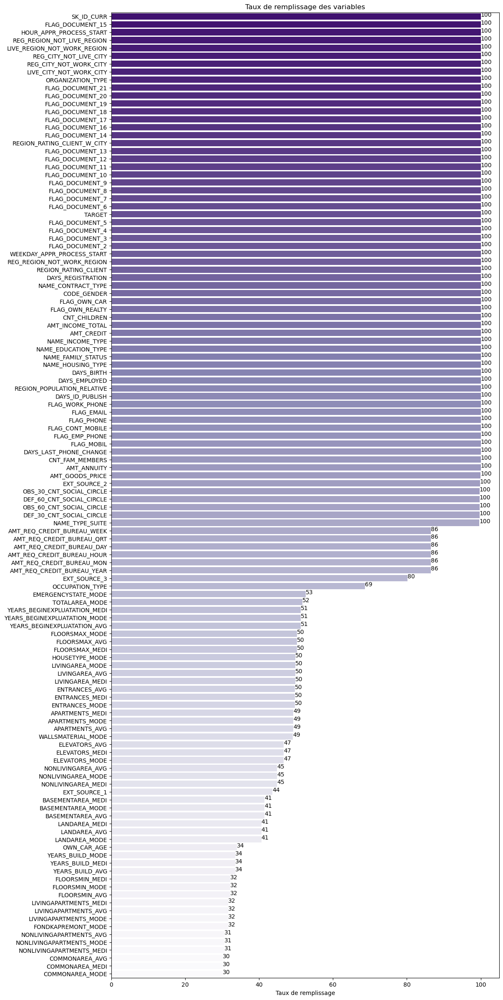

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_CURR,int64,100002,307511,307511,100.00,307511,100.00,0,0.00
1,TARGET,int64,1,307511,2,0.00,307511,100.00,0,0.00
2,NAME_CONTRACT_TYPE,object,Cash loans,307511,2,0.00,307511,100.00,0,0.00
3,CODE_GENDER,object,M,307511,3,0.00,307511,100.00,0,0.00
4,FLAG_OWN_CAR,object,N,307511,2,0.00,307511,100.00,0,0.00
5,FLAG_OWN_REALTY,object,Y,307511,2,0.00,307511,100.00,0,0.00
6,CNT_CHILDREN,int64,0,307511,15,0.00,307511,100.00,0,0.00
7,AMT_INCOME_TOTAL,float64,202500.00,307511,2548,0.83,307511,100.00,0,0.00
8,AMT_CREDIT,float64,406597.50,307511,5603,1.82,307511,100.00,0,0.00
9,AMT_ANNUITY,float64,24700.50,307511,13672,4.45,307499,100.00,12,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [6]:
fig = plt.figure(figsize=(12, 30))
app_train_desc = fct_eda.describe_stat(app_train, fig = fig)

#### Traitement des données manquantes

Nous allons imputer les données manquantes de différentes manières:
- **suppression** des variables avec plus de **30% de données manquantes**
- pour les **variables corrélées entre elles** que nous repérerons à l'aide de la matrice de corrélation, nous utiliserons l'algorithme **iterative imputer**
- lorsque le pourcentage de valeurs manquantes est relativement **faible** (<=20%), nous imputerons par la **médiane** pour les variables quantitatives et par le **mode** pour les variables qualitatives

Pour nous assurer que nos méthodes sont cohérentes, nous analyserons les **distributions** avant et après imputations.

<div class="alert alert-block alert-warning">
    <p>Suppression des variables avec 30% ou plus de NaN</p>
</div>

In [7]:
# Suppression des variables avec 30% ou plus de NaN
app_train_nan = fct_eda.tx_rempl_min(app_train, 70)
fct_eda.nan_a_retraiter(app_train_nan)

,Tx_rempl,nb_NaN,dtypes
DAYS_LAST_PHONE_CHANGE,100.00,1,float64
CNT_FAM_MEMBERS,100.00,2,float64
AMT_ANNUITY,100.00,12,float64
AMT_GOODS_PRICE,99.91,278,float64
EXT_SOURCE_2,99.79,660,float64
DEF_60_CNT_SOCIAL_CIRCLE,99.67,1021,float64
OBS_30_CNT_SOCIAL_CIRCLE,99.67,1021,float64
DEF_30_CNT_SOCIAL_CIRCLE,99.67,1021,float64
OBS_60_CNT_SOCIAL_CIRCLE,99.67,1021,float64
NAME_TYPE_SUITE,99.58,1292,object


<div class="alert alert-block alert-warning">
    <p>iterative imputer pour les variables corrélées entre-elles</p>
</div>

In [8]:
# Variables quantitatives
col_quanti_cont = app_train_nan.select_dtypes(exclude=['object']).columns.tolist()

liste_var_a_tester = fct_eda.pairs_corr(app_train_nan, col_quanti_cont, seuil = 0.5)

,correlation
pairs,
"(OBS_60_CNT_SOCIAL_CIRCLE, OBS_30_CNT_SOCIAL_CIRCLE)",1.00
"(AMT_GOODS_PRICE, AMT_CREDIT)",0.99
"(REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY)",0.95
"(CNT_CHILDREN, CNT_FAM_MEMBERS)",0.88
"(LIVE_REGION_NOT_WORK_REGION, REG_REGION_NOT_WORK_REGION)",0.86
"(DEF_30_CNT_SOCIAL_CIRCLE, DEF_60_CNT_SOCIAL_CIRCLE)",0.86
"(LIVE_CITY_NOT_WORK_CITY, REG_CITY_NOT_WORK_CITY)",0.83
"(AMT_ANNUITY, AMT_GOODS_PRICE)",0.78
"(AMT_CREDIT, AMT_ANNUITY)",0.77


<div class="alert alert-block alert-success">
    <p>A noter: ces pairs de variables étant fortement corrélées, il faudra penser à ne pas les prendre toutes dans notre modèle.</p>
</div>

In [9]:
app_train_imp = app_train_nan.copy()

In [10]:
# Affectation des résultats de l'iterative imputer dans les variables concernées
app_train_imp['OBS_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,0]
app_train_imp['OBS_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,1]

app_train_imp['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_GOODS_PRICE', 'AMT_CREDIT']])[:,0]

app_train_imp['CNT_FAM_MEMBERS'] = fct_eda.iterative_imputer_function(
    app_train_imp[['CNT_FAM_MEMBERS', 'CNT_CHILDREN']])[:,0]

app_train_imp['DEF_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,0]
app_train_imp['DEF_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,1]

app_train_imp['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,0]
app_train_imp['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,1]

app_train_imp['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_CREDIT', 'AMT_ANNUITY']])[:,1]

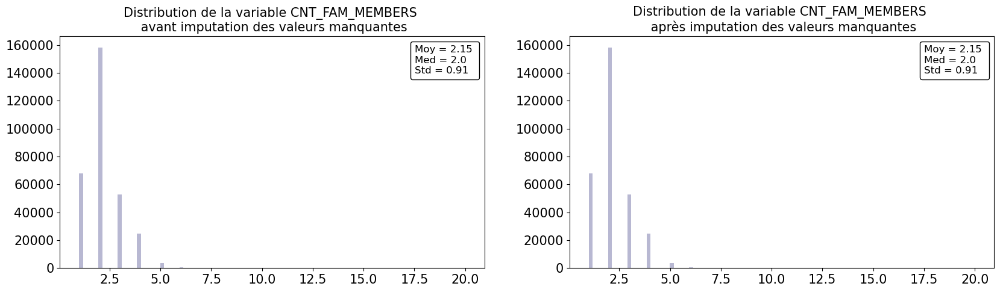

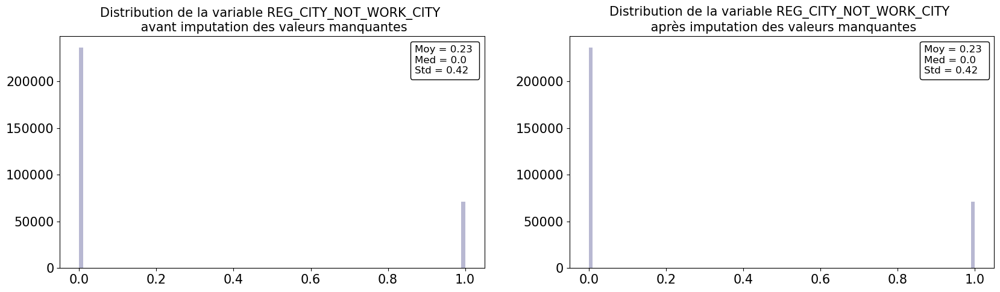

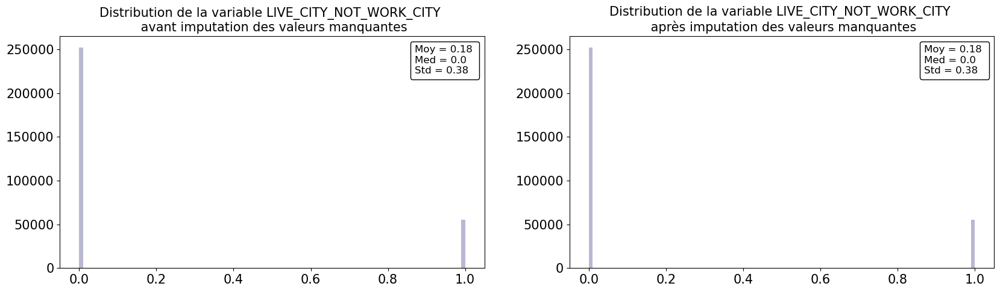

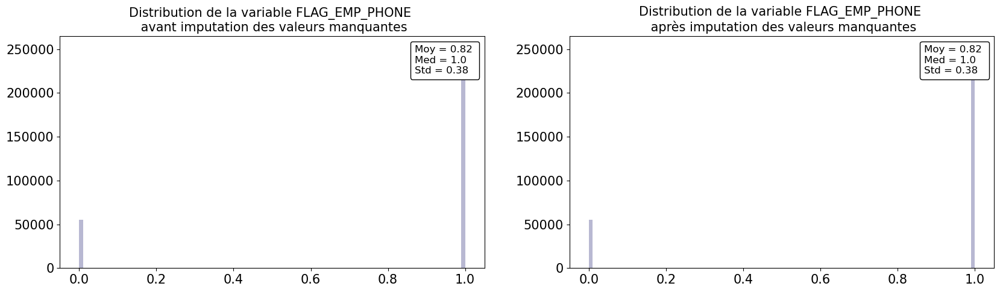

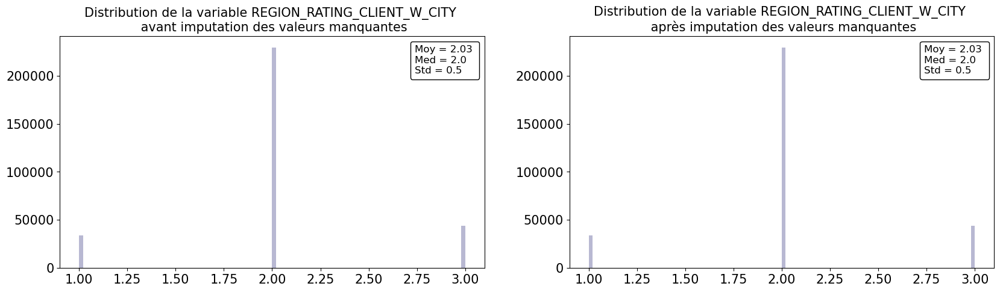

...

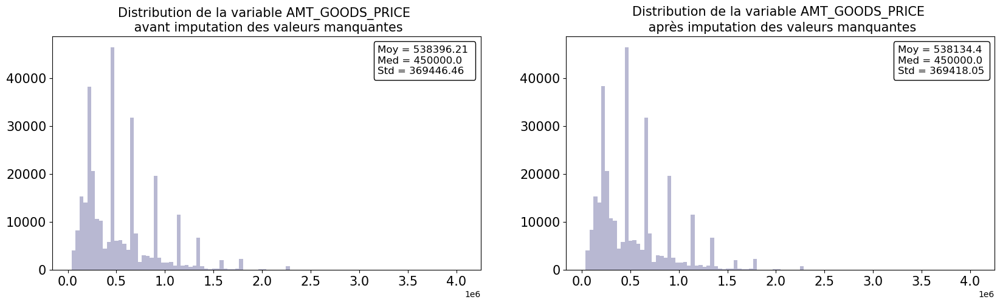

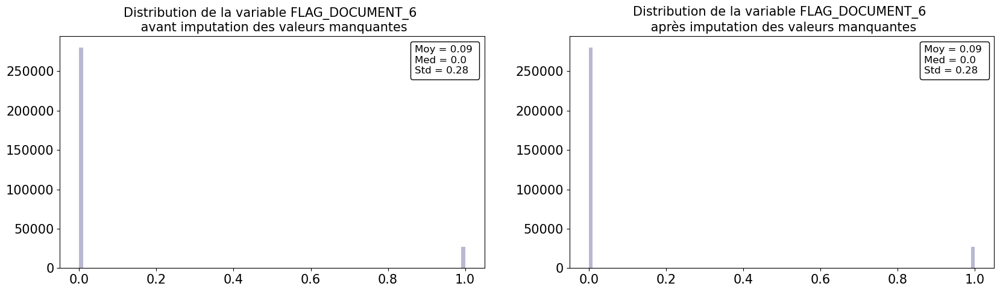

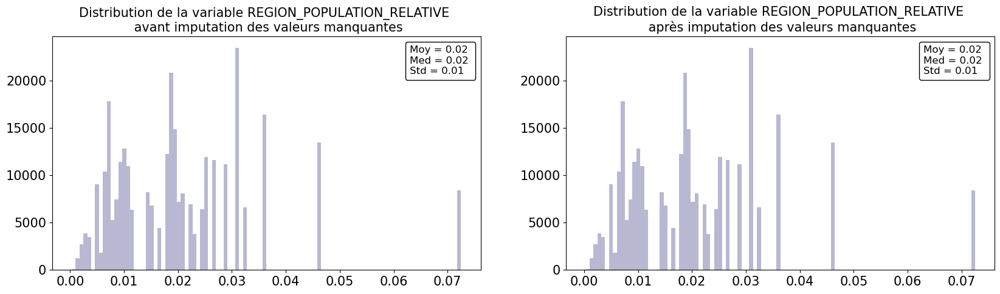

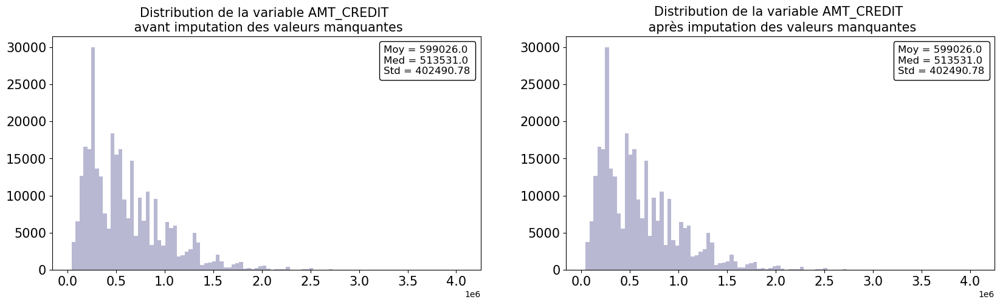

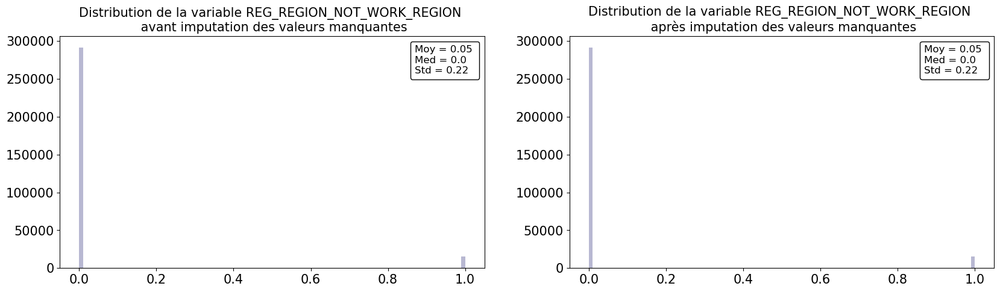

In [11]:
list_var_imp = liste_var_a_tester

for var in list_var_imp:
    fct_eda.distrib_imput_nan_quanti(app_train_nan, var, app_train_imp)

Les distributions de nos variables avant et après imputation des valeurs manquantes par iterative imputer sont similaires, nous validons cette méthode.

<div class="alert alert-block alert-warning">
    <p>Médiane et mode pour variables avec taux de remplissage > 80% (hors variable TARGET)</p>
</div>

In [12]:
app_train_med = app_train_imp.copy()

In [13]:
df_nan = fct_eda.nan_a_retraiter(app_train_med)

In [14]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                 (df_nan['dtypes'] == 'float64') &
                 (~ df_nan.index.str.contains('TARGET'))].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    app_train_med[col] = app_train_med[col].fillna(app_train_med[col].median())

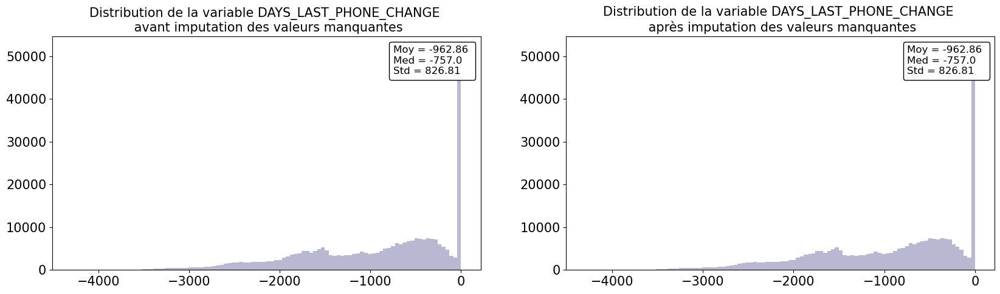

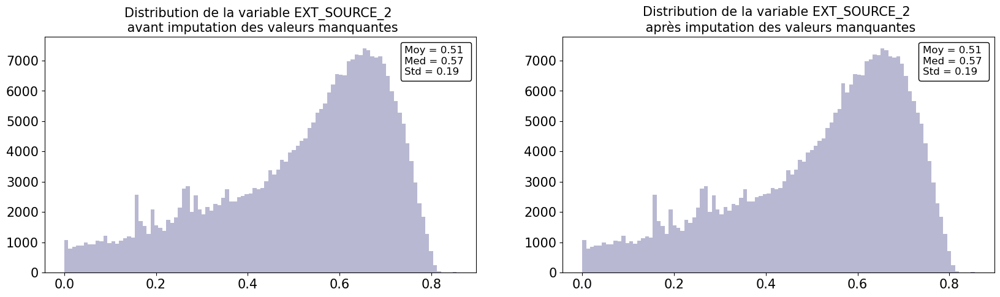

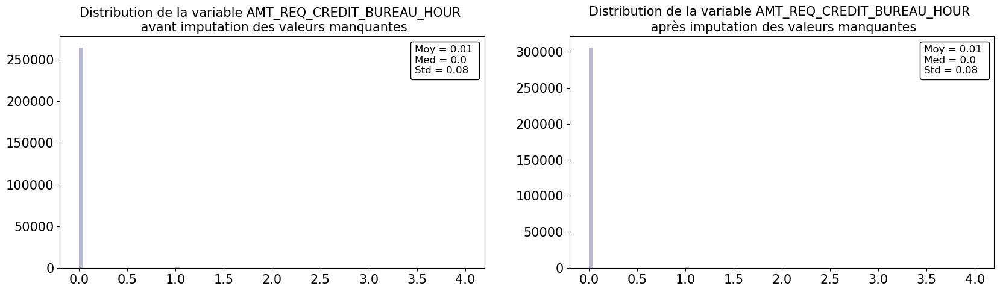

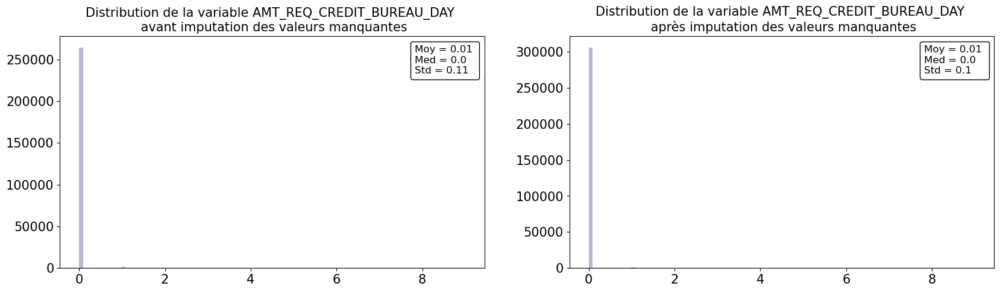

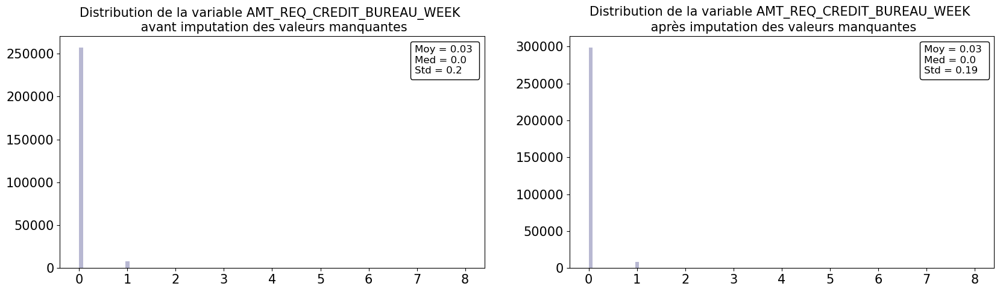

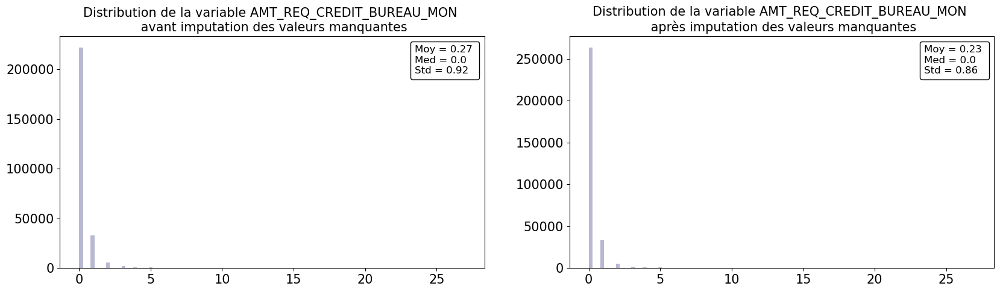

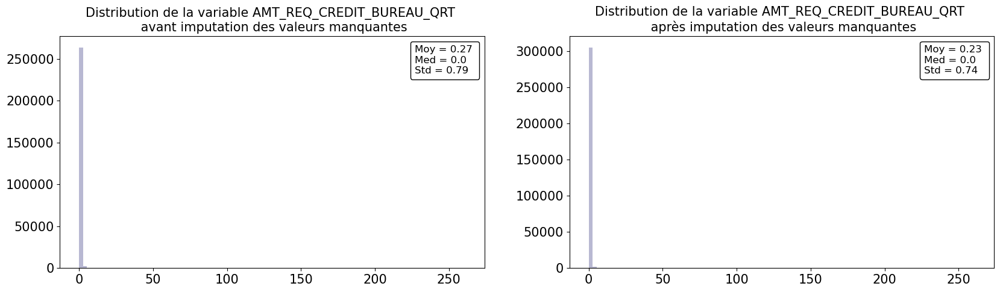

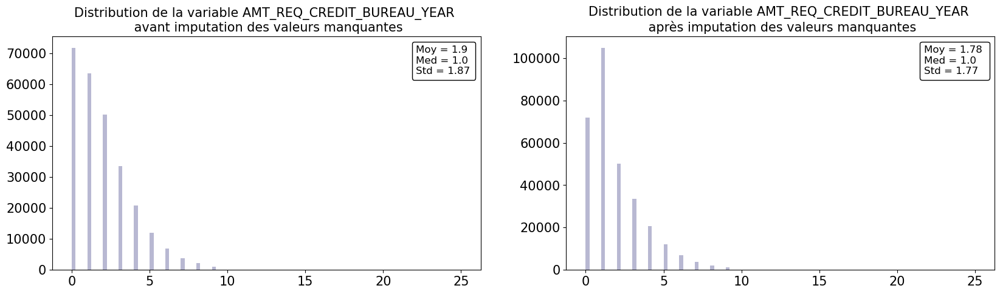

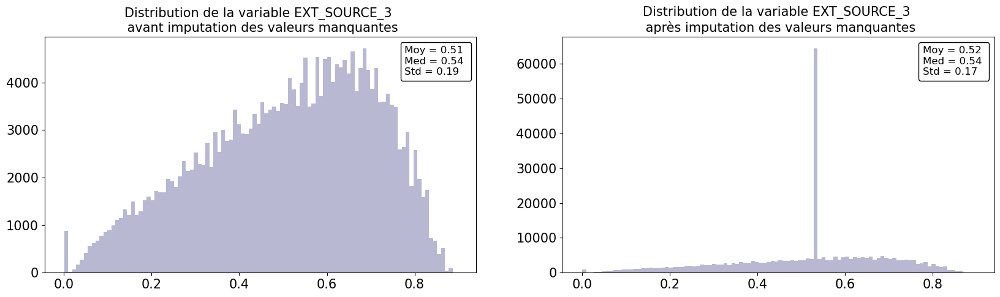

In [15]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(app_train_imp, var, app_train_med)

La distribution des variables "EXT_SOURCE_3" et "AMT_REQ_CREDIT_BUREAU_YEAR" après imputation des valeurs manquantes a changé, nous ne conservons pas ces deux variables pour la suite de notre analyse.

In [16]:
del app_train_med['AMT_REQ_CREDIT_BUREAU_YEAR']
del app_train_med['EXT_SOURCE_3']

In [17]:
# Imputation de la variable NAME_TYPE_SUITE par le mode
app_train_med['NAME_TYPE_SUITE'] = app_train_med['NAME_TYPE_SUITE'].fillna(app_train_med['NAME_TYPE_SUITE'].mode()[0])

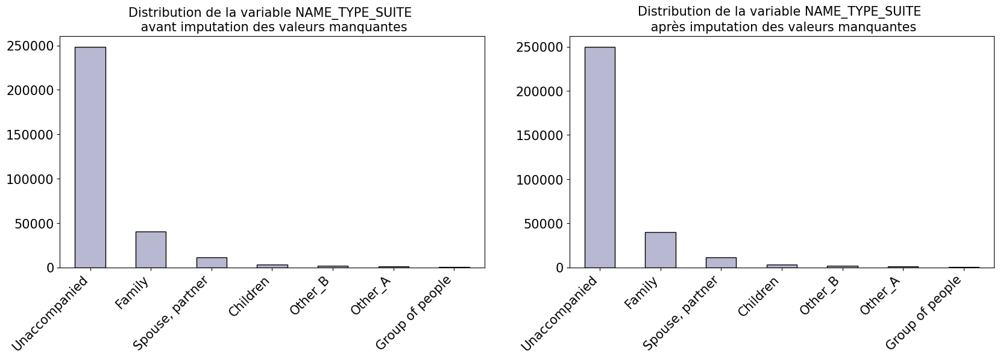

In [18]:
fct_eda.distrib_imput_nan_quali(app_train_imp, 'NAME_TYPE_SUITE', app_train_med)

In [19]:
del app_train
del app_train_imp
del app_train_nan

#### Analyses univariées

In [20]:
app_train_desc = app_train_med.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [21]:
liste_col_quanti = app_train_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique()
liste_col_quanti = liste_col_quanti[liste_col_quanti>2].index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [22]:
len(liste_col_quanti)

25

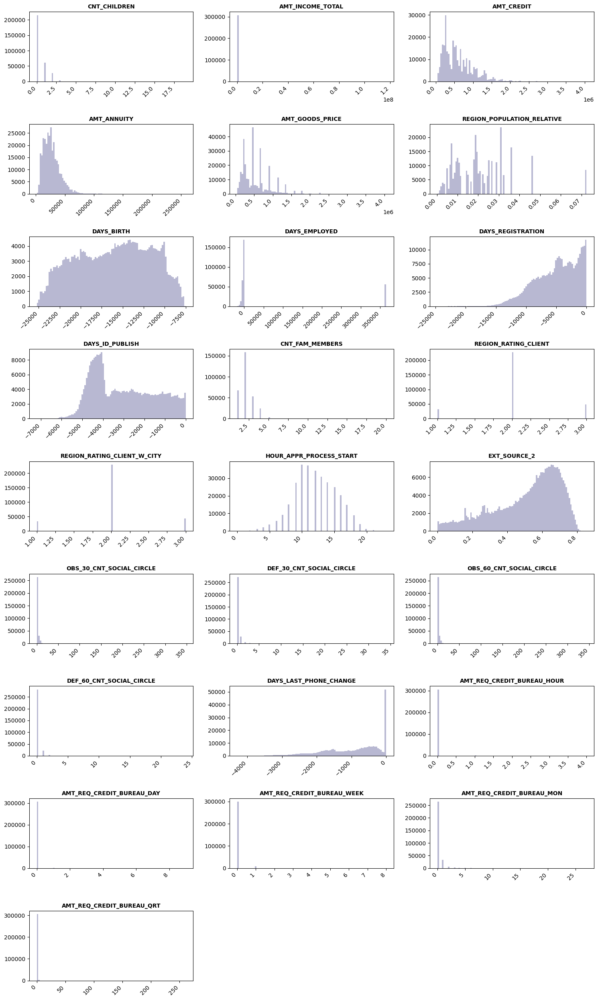

In [23]:
fig = plt.figure(figsize=(15,25))
fct_eda.univariate_plots_hist(app_train_desc, liste_col_quanti, 9, 3, 100, fig=fig)

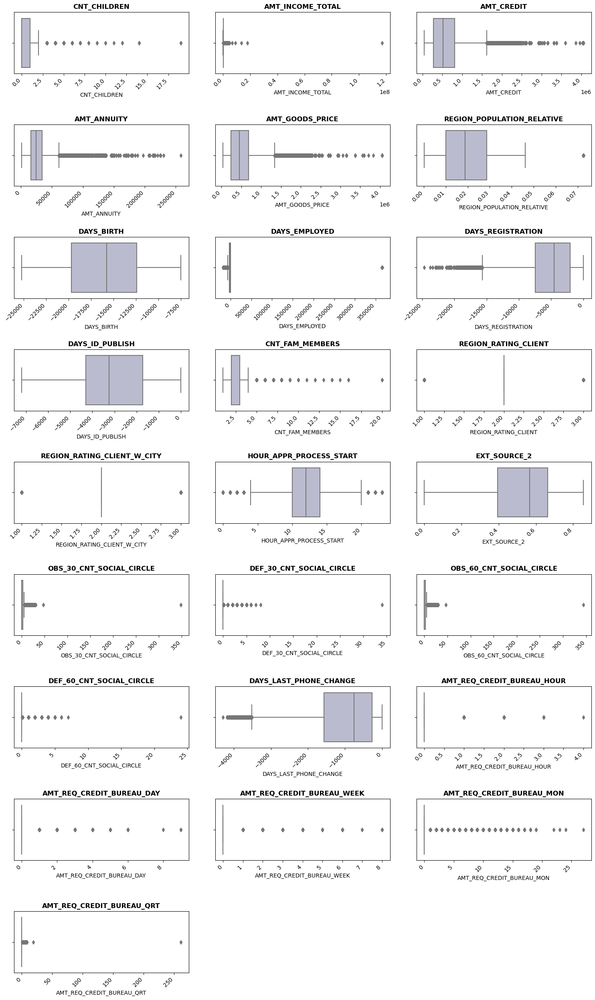

In [24]:
fig = plt.figure(figsize=(15,25))
fct_eda.univariate_plots_box(app_train_desc, liste_col_quanti, 9, 3, fig, True)

In [25]:
app_train_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
CNT_CHILDREN,307511.00,0.42,0.72,0.00,0.00,0.00,1.00,19.00
AMT_INCOME_TOTAL,307511.00,168797.92,237123.15,25650.00,112500.00,147150.00,202500.00,117000000.00
AMT_CREDIT,307511.00,599026.00,402490.78,45000.00,270000.00,513531.00,808650.00,4050000.00
AMT_ANNUITY,307511.00,27108.54,14493.58,1615.50,16524.00,24903.00,34596.00,258025.50
AMT_GOODS_PRICE,307511.00,538134.40,369418.05,40500.00,238500.00,450000.00,679500.00,4050000.00
REGION_POPULATION_RELATIVE,307511.00,0.02,0.01,0.00,0.01,0.02,0.03,0.07
DAYS_BIRTH,307511.00,-16037.00,4363.99,-25229.00,-19682.00,-15750.00,-12413.00,-7489.00
DAYS_EMPLOYED,307511.00,63815.05,141275.77,-17912.00,-2760.00,-1213.00,-289.00,365243.00
DAYS_REGISTRATION,307511.00,-4986.12,3522.89,-24672.00,-7479.50,-4504.00,-2010.00,0.00
DAYS_ID_PUBLISH,307511.00,-2994.20,1509.45,-7197.00,-4299.00,-3254.00,-1720.00,0.00


Nous allons supprimer la ligne où figure la valeur maximale de la variable DAYS_EMPLOYED (365243). Il est impossible que la personne ait commencé son dernier travail il y a 1000 ans.

In [26]:
row_supp = app_train_desc[app_train_desc['DAYS_EMPLOYED']==365243].shape[0]
print(f'Nombre de lignes supprimées: {row_supp}')

Nombre de lignes supprimées: 55374


In [27]:
app_train_desc.drop(app_train_desc[app_train_desc['DAYS_EMPLOYED'] == 365243].index, inplace=True)

Nous **conservons les outliers** qui dans les cas d'identification de défaut de paiement peuvent nous être très utiles pour différencier les bons des moins bons payeurs.

In [28]:
liste_col_quali = app_train_desc.select_dtypes(exclude='float')
liste_col_quali = liste_col_quali.nunique()
liste_col_quali = liste_col_quali[liste_col_quali>=2].index.tolist()
liste_col_quali_suppr = ['SK_ID_CURR', 'CNT_CHILDREN', 'DAYS_BIRTH',
                        'DAYS_EMPLOYED', 'DAYS_ID_PUBLISH',
                        'HOUR_APPR_PROCESS_START']

liste_col_quali = [elem for elem in liste_col_quali if elem not in liste_col_quali_suppr]

In [29]:
len(liste_col_quali)

46

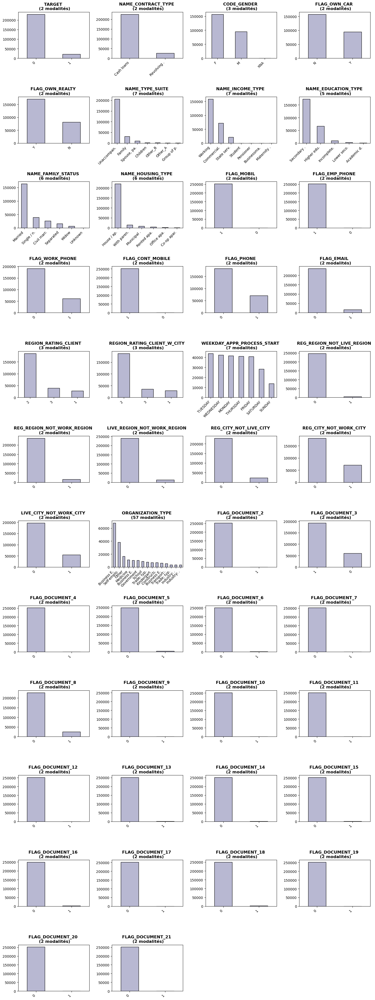

In [30]:
fig = plt.figure(figsize=(15, 40))
fct_eda.categ_distrib_plot(app_train_desc, liste_col_quali, 12, 4, fig = fig)

Nous remarquons un genre **XNA** comportant uniquement 4 observations. Nous les supprimons.

In [31]:
app_train_desc['CODE_GENDER'].value_counts()

F      157177
M       94956
XNA         4
Name: CODE_GENDER, dtype: int64

In [32]:
app_train_desc = app_train_desc[app_train_desc['CODE_GENDER'].isin(["F", "M"])]

<div class="alert alert-block alert-warning">
    <p>TARGET</p>
</div>

Si l'on se réfère au fichier de description des colonnes:
- **1** => clients a des difficultés de paiement, il a eu un retard de paiement de plus de X jours sur au moins une des Y premières échéances du prêt dans notre échantillon (**défaillant**)
- **0** => tous les autres cas (**non défaillant**)	

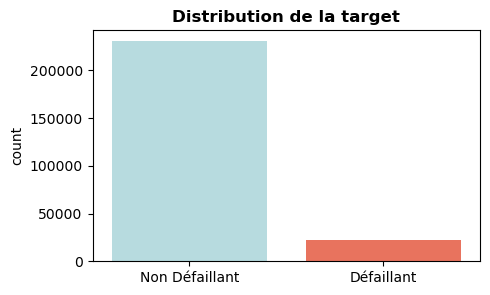

In [33]:
# Distribution de la target
plt.figure(figsize=(5,3))
sns.countplot(x = 'TARGET', data = app_train_desc, palette=['powderblue', 'tomato'])
plt.title('Distribution de la target', fontweight='bold', fontsize = 12)
x = [0, 1]
plt.xticks(x, ['Non Défaillant', 'Défaillant'])
plt.xlabel('');

In [34]:
app_train_desc['TARGET'].value_counts()

0    230298
1     21835
Name: TARGET, dtype: int64

<div class="alert alert-block alert-success">
    <p>A noter: Le jeu de données est déséquilibré avec beaucoup plus de non défaillants (>230K) que de défaillants (environ 22K). Il faudra en tenir compte lors de l'élaboration de notre modèle.</p>
</div>

#### Analyses bivariées / multivariées

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [35]:
liste_target = ['TARGET']
liste_corr = liste_col_quanti + liste_target

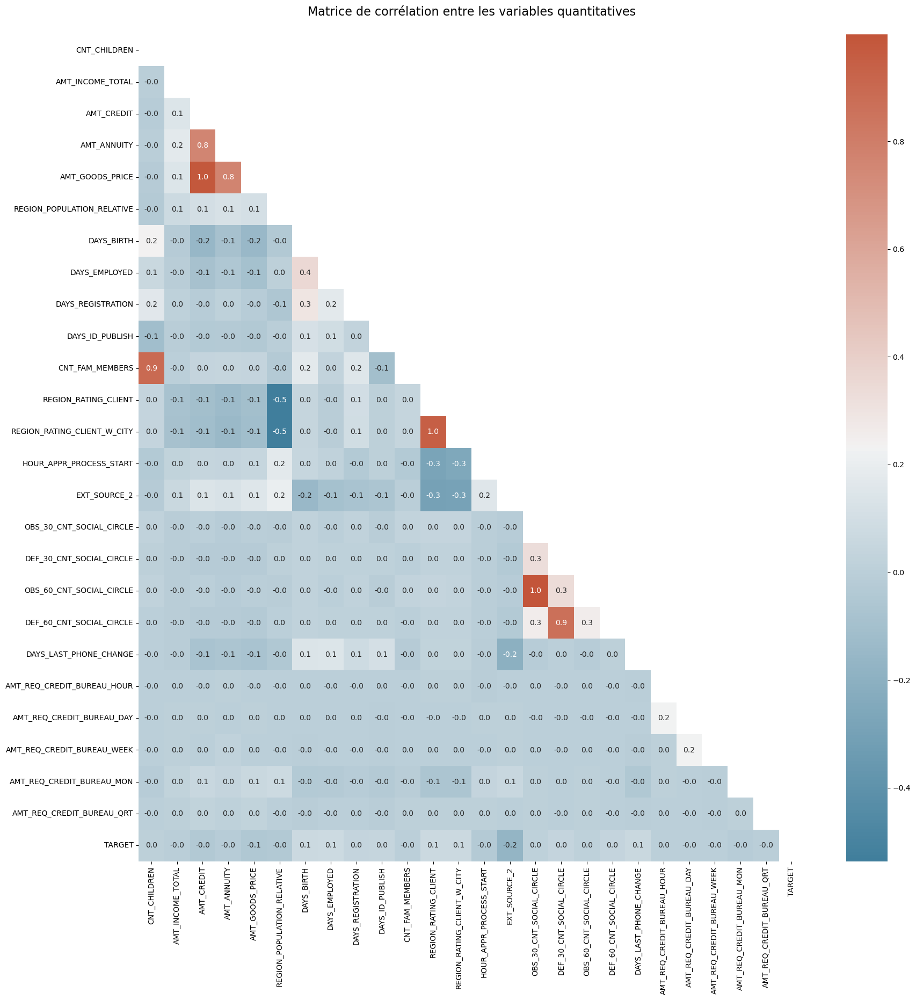

In [36]:
# Corrélation
corr = app_train_desc[liste_corr].corr()

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(20, 20))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation entre les variables quantitatives\n", fontsize=16);

Lorsque deux variables sont fortement corrélées, nous n'en conserverons qu'une pour la suite de l'analyse.
Aucune variable quantitative à elle seule est capable d'expliquer le résultat (la target). Il n'y a donc **pas de dataleak**.

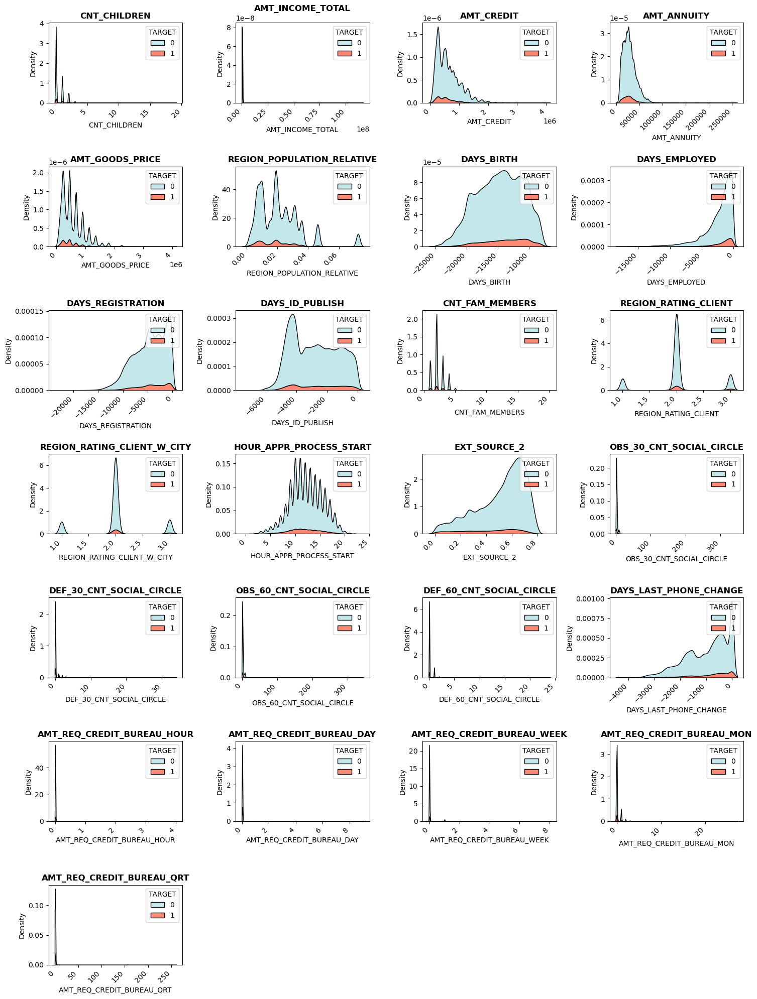

In [37]:
palette=['powderblue', 'tomato']

fct_eda.bivariate_kdeplots(app_train_desc, 'TARGET',
                           liste_col_quanti,
                           7, 4, palette = palette)

Le jeu de données étant déséquilibré en défaveur des défaillants, nous allons faire un focus sur ces derniers avec d'essayer d'identifier un "profil type" et de mieux visualiser les données.

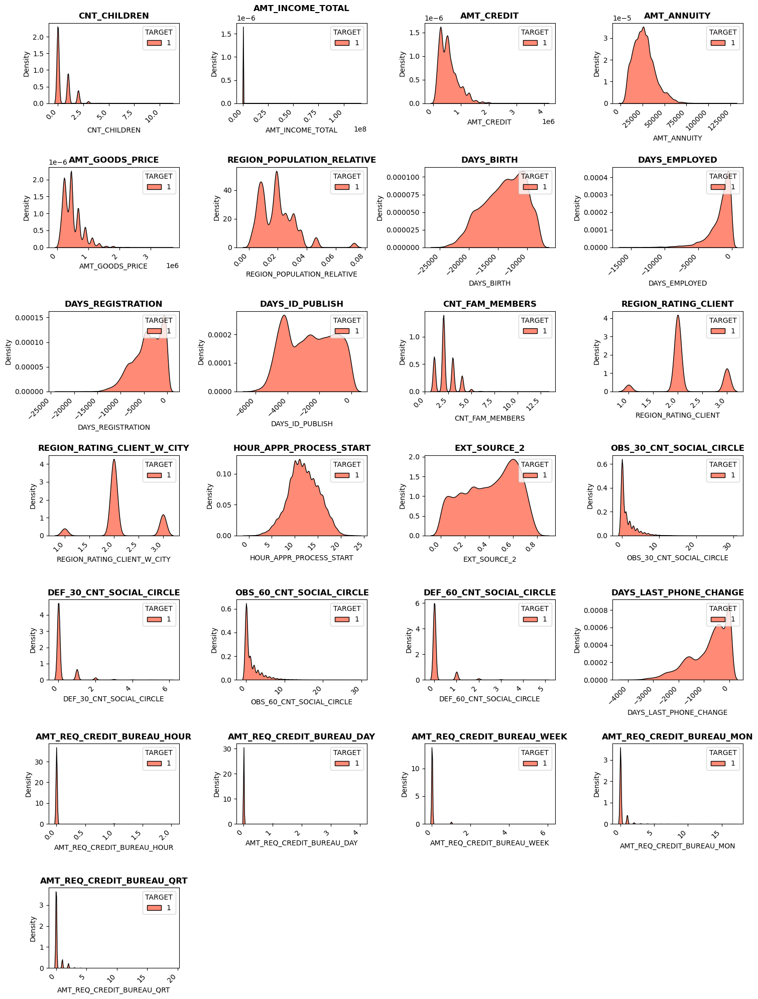

In [38]:
fct_eda.bivariate_kdeplots(app_train_desc[app_train_desc['TARGET'] == 1],
                           'TARGET',
                           liste_col_quanti,
                           7, 4,
                           palette = ['tomato'])

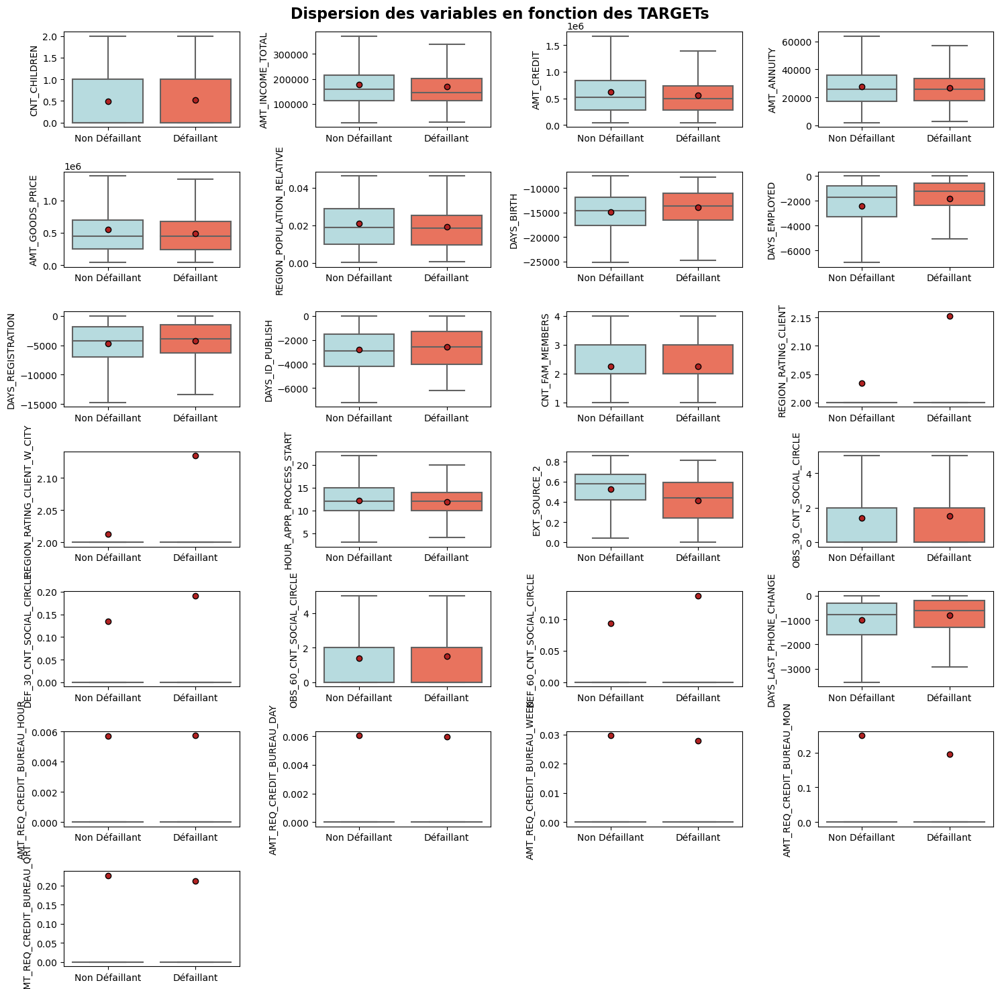

In [39]:
fig = plt.figure(figsize=(15,15))
fct_eda.bivariate_plots_box(app_train_desc, 'TARGET', liste_col_quanti, 7, 4, fig)

In [40]:
app_train_desc.groupby(['TARGET']).describe().T

TARGET                                      0            1
SK_ID_CURR                  count   230298.00     21835.00
                            mean    278160.56    277644.54
                            std     102858.20    102366.21
                            min     100003.00    100002.00
                            25%     188934.25    189855.00
                            50%     278201.50    276404.00
                            75%     367239.75    366375.00
                            max     456255.00    456254.00
CNT_CHILDREN                count   230298.00     21835.00
                            mean         0.50         0.52
                            std          0.76         0.78
                            min          0.00         0.00
                            25%          0.00         0.00
                            50%          0.00         0.00
                            75%          1.00         1.00
                            max         19.00        11.00
AMT_INCOME_TOTAL            count   230298.00     21835.00
                            mean    176498.25    169750.64
                            std     115500.63    795614.86
                            min      25650.00     27000.00
                            25%     112500.00    112500.00
                            50%     157500.00    144000.00
                            75%     216000.00    202500.00
                            max   18000090.00 117000000.00
AMT_CREDIT                  count   230298.00     21835.00
                            mean    616491.71    557717.75
                            std     411440.20    346048.34
                            min      45000.00     45000.00
                            25%     276277.50    284400.00
                            50%     521280.00    495985.50
                            75%     835380.00    729000.00
                            max    4050000.00   4027680.00
AMT_ANNUITY                 count   230298.00     21835.00
                            mean     27902.76     26859.04
                            std      14833.87     12476.18
                            min       1980.00      2844.00
                            25%      16969.50     17732.25
                            50%      25843.50     25578.00
                            75%      35743.50     33394.50
                            max     258025.50    127507.50
AMT_GOODS_PRICE             count   230298.00     21835.00
                            mean    554884.50    488151.45
                            std     378123.49    310755.77
                            min      40500.00     45000.00
                            25%     247500.00    238500.00
                            50%     450000.00    450000.00
                            75%     702000.00    675000.00
                            max    4050000.00   3600000.00
REGION_POPULATION_RELATIVE  count   230298.00     21835.00
                            mean         0.02         0.02
                            std          0.01         0.01
                            min          0.00         0.00
                            25%          0.01         0.01
                            50%          0.02         0.02
                            75%          0.03         0.03
                            max          0.07         0.07
DAYS_BIRTH                  count   230298.00     21835.00
                            mean    -14843.31    -13986.98
                            std       3665.56      3537.41
                            min     -25200.00    -25168.00
                            25%     -17643.00    -16594.00
                            50%     -14671.00    -13606.00
                            75%     -11855.00    -11087.00
                            max      -7489.00     -7678.00
DAYS_EMPLOYED               count   230298.00     21835.00
                            mean     -2438.11     -1814.92
                            std       2372.38  

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

TARGET vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


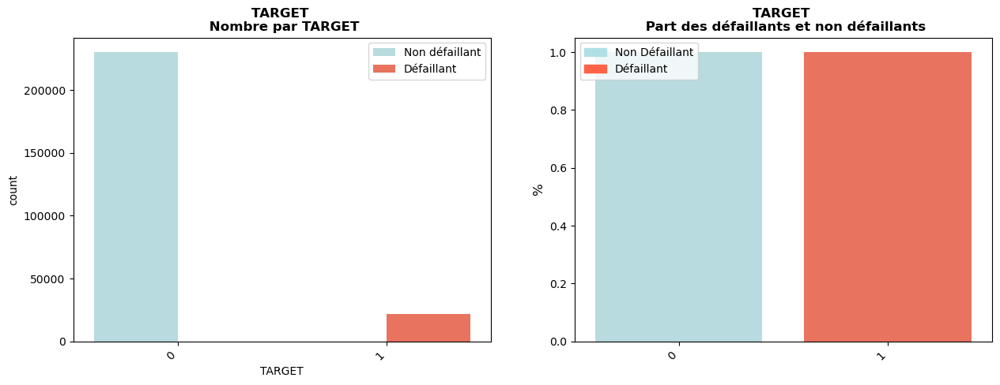

NAME_CONTRACT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 8.591488476476832e-74 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


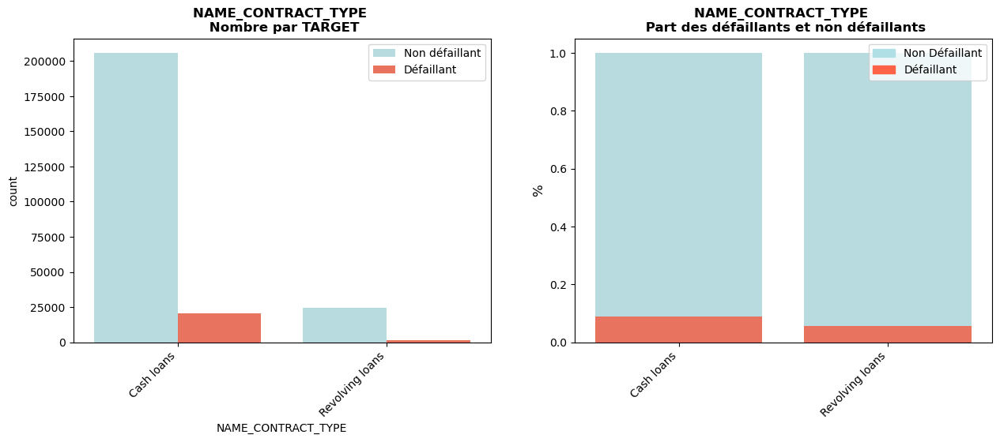

CODE_GENDER vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.0554972433820888e-134 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


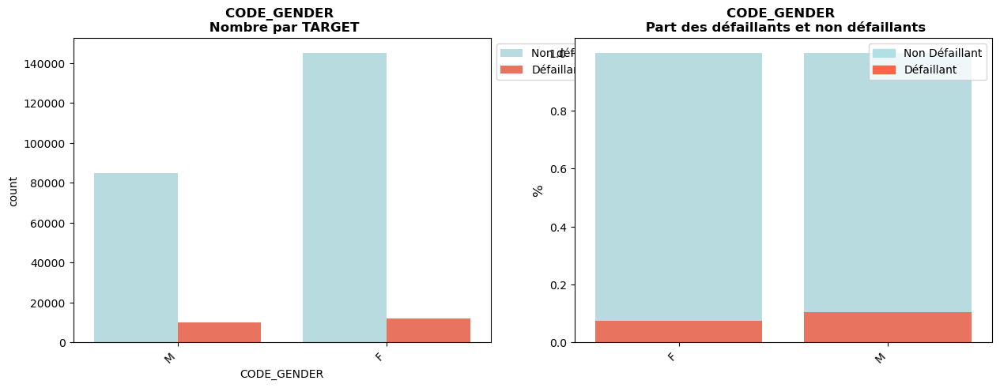

FLAG_OWN_CAR vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.1550398340993824e-57 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


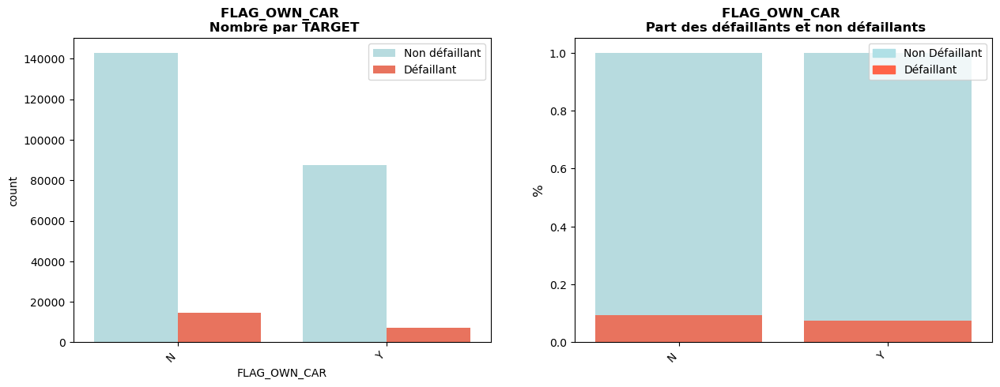

FLAG_OWN_REALTY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.17218490365755645 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


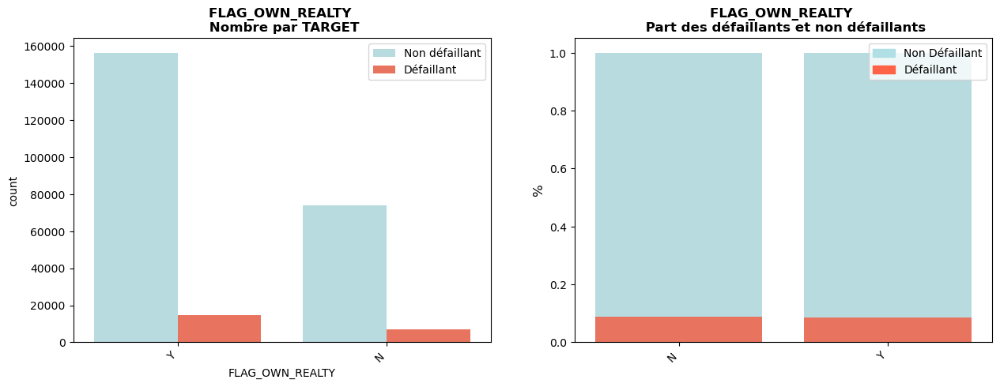

NAME_TYPE_SUITE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 3.105892733833357e-06 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


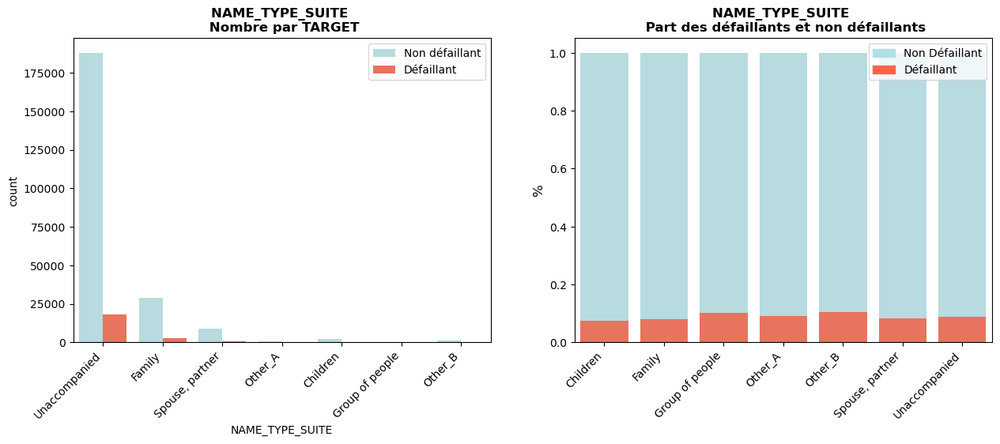

NAME_INCOME_TYPE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 2.4757641839035688e-113 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


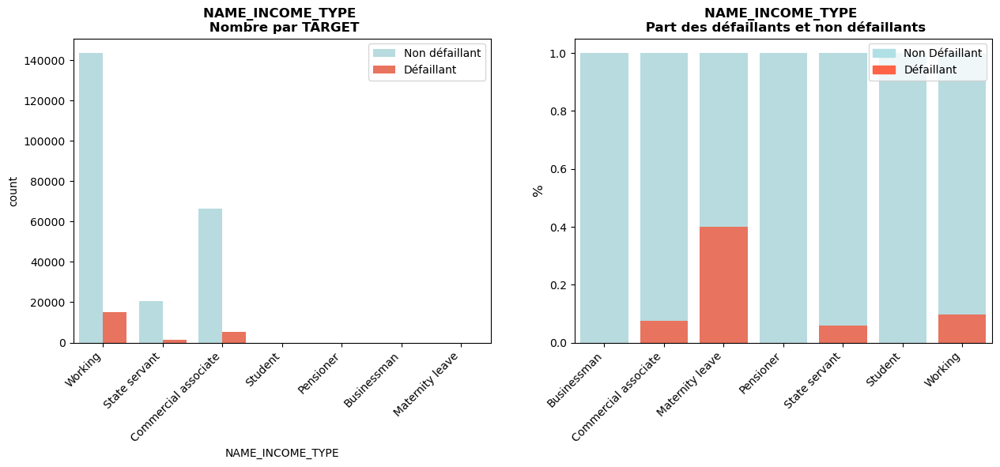

NAME_EDUCATION_TYPE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 2.798885668219973e-261 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


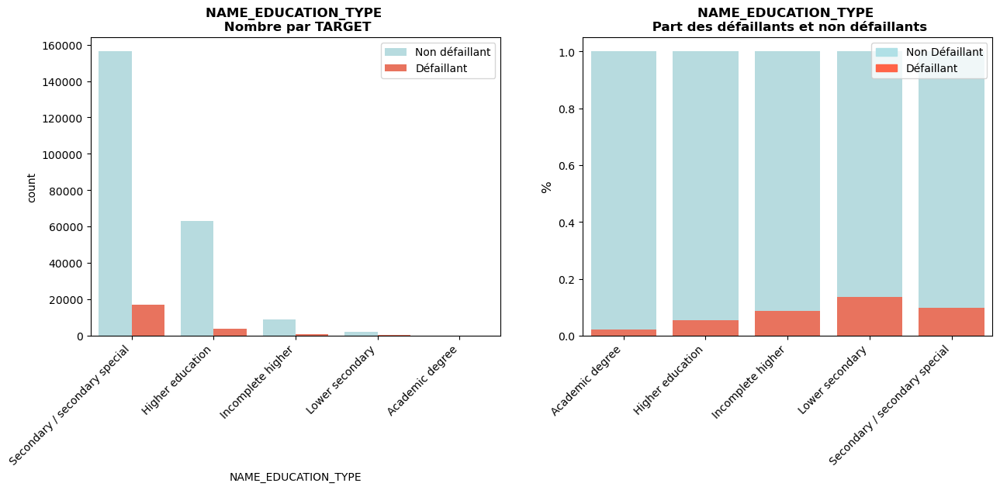

NAME_FAMILY_STATUS vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 6.167571000286684e-86 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


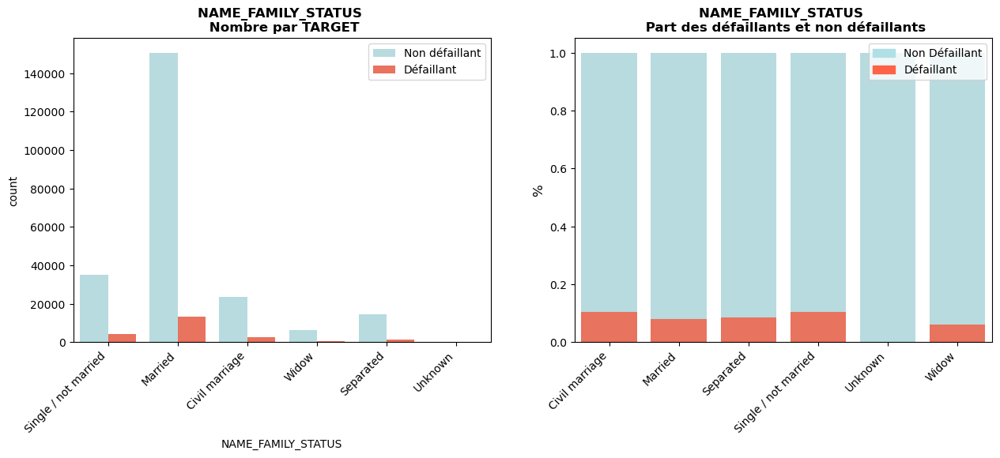

NAME_HOUSING_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 3.1968954160674186e-64 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


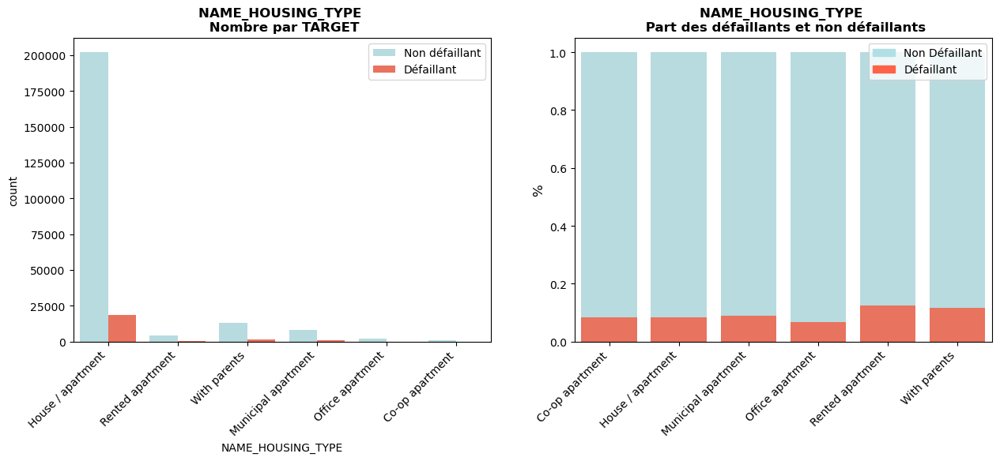

FLAG_MOBIL vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.1415976613385862 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


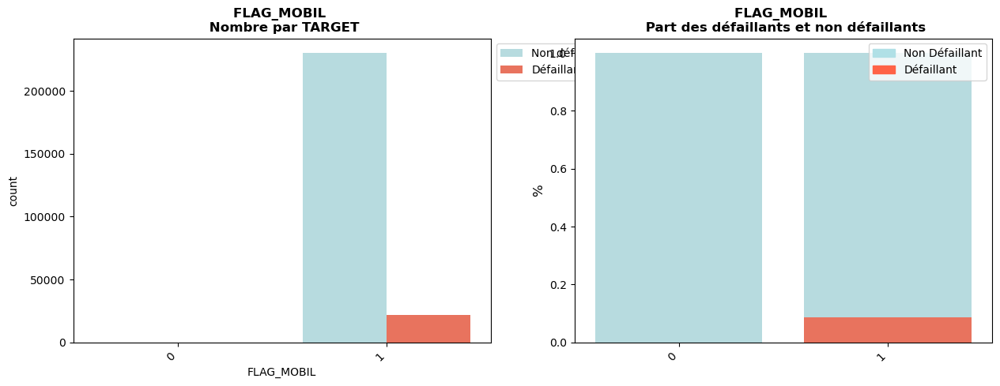

FLAG_EMP_PHONE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.6362392917608177 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


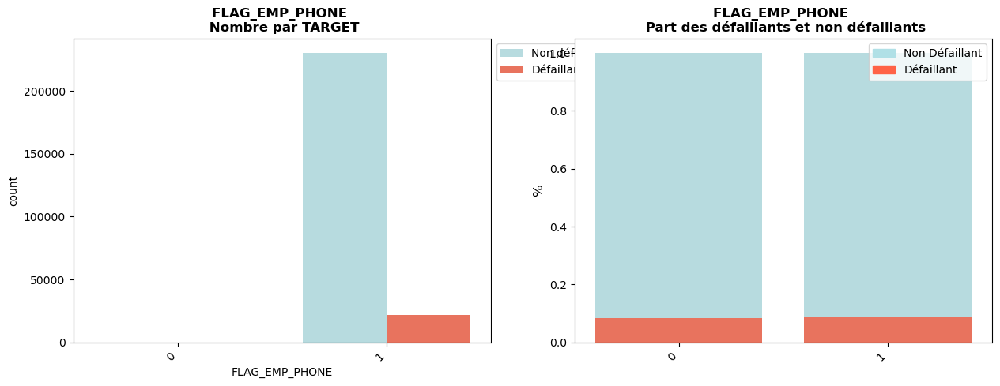

FLAG_WORK_PHONE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 9.731840035630845e-23 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


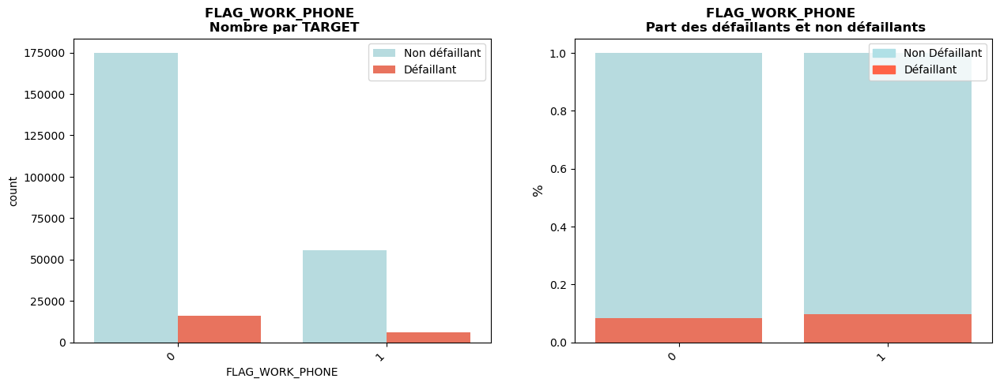

FLAG_CONT_MOBILE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.653687810616425 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


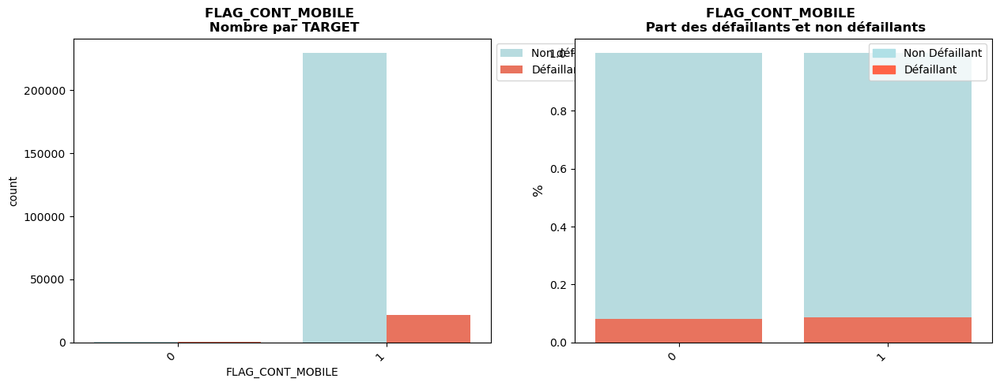

FLAG_PHONE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.2423561346917567e-33 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


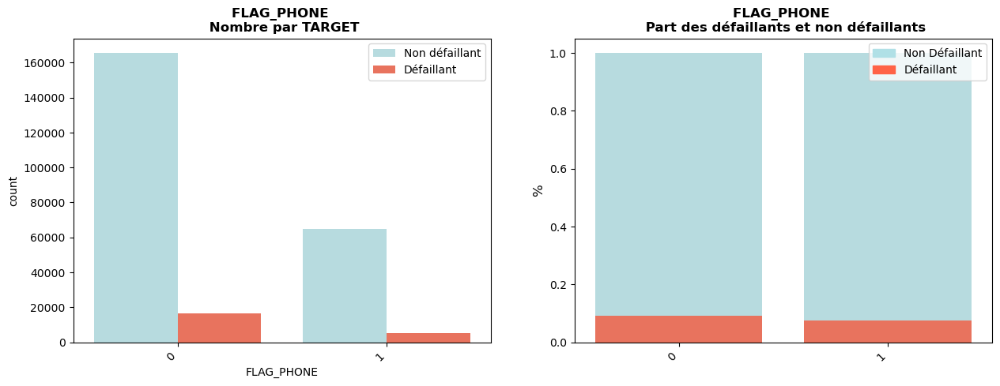

FLAG_EMAIL vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.002764172694136834 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


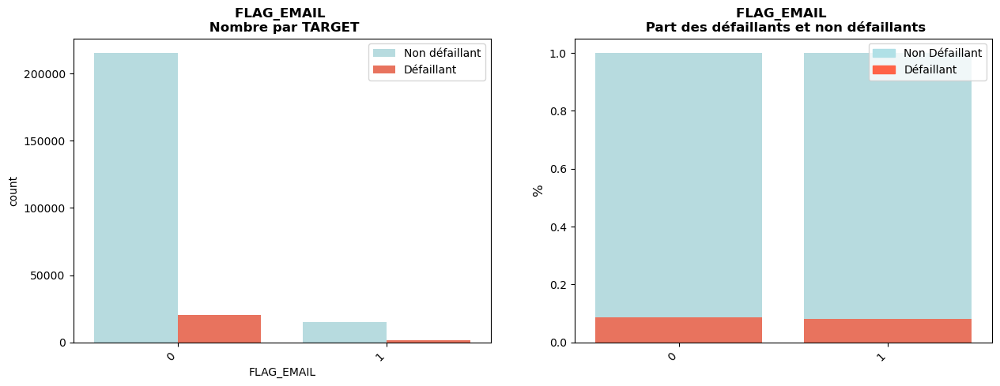

REGION_RATING_CLIENT vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 6.10895061195938e-233 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


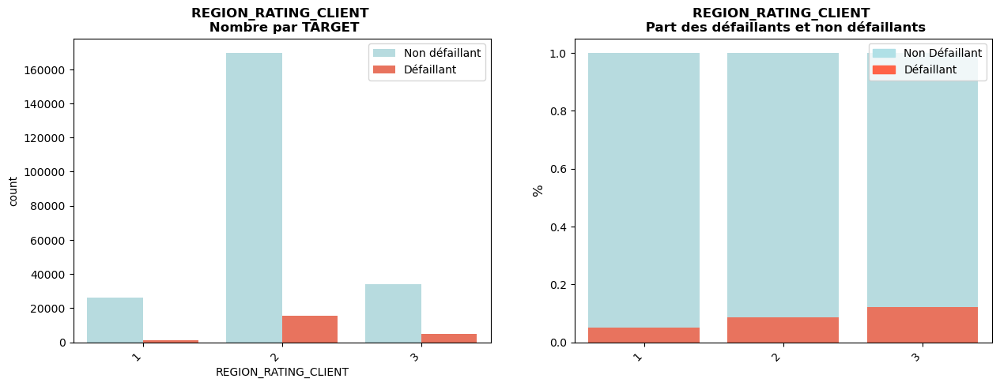

REGION_RATING_CLIENT_W_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.534636068259198e-250 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


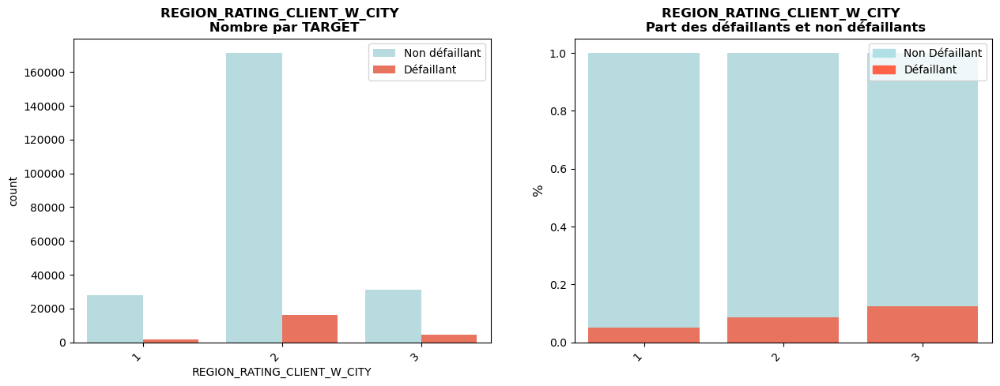

WEEKDAY_APPR_PROCESS_START vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.004505639818379602 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


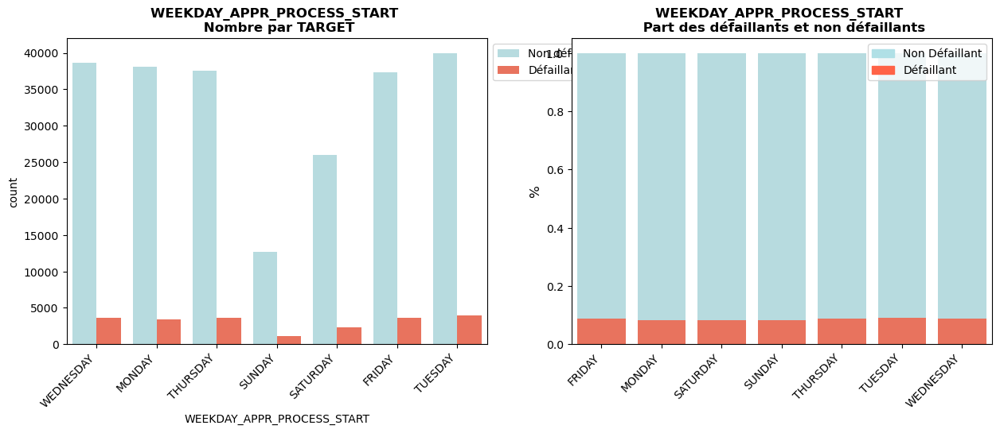

REG_REGION_NOT_LIVE_REGION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.029376414051388657 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


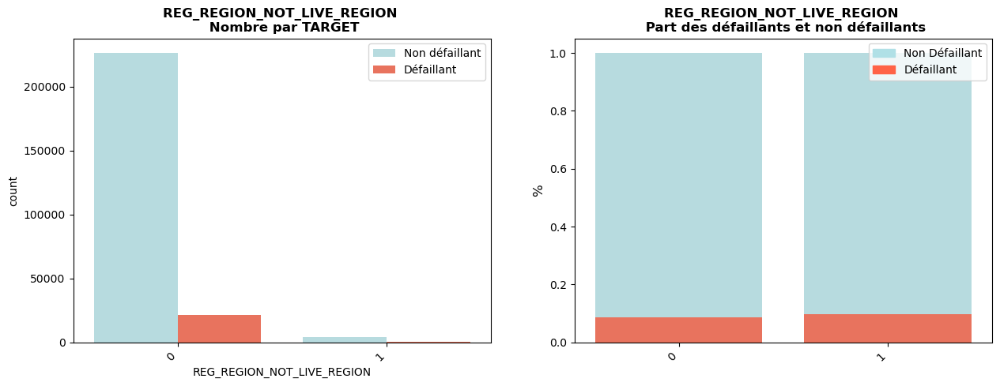

REG_REGION_NOT_WORK_REGION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.2971721481577704 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


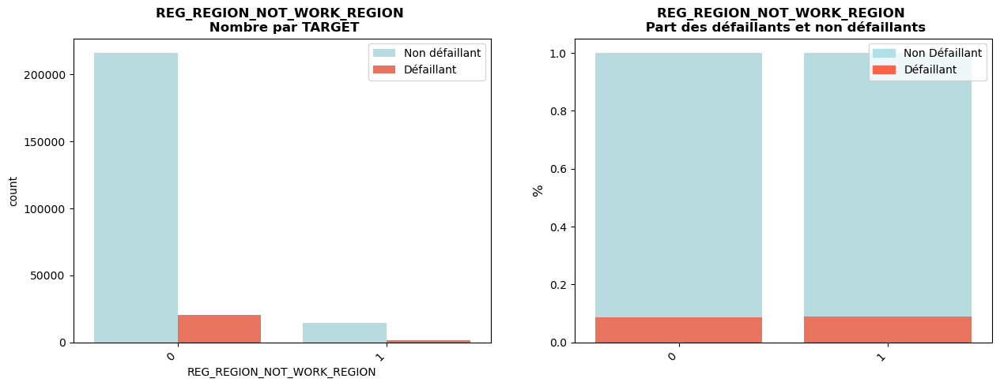

LIVE_REGION_NOT_WORK_REGION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.39145893703086265 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


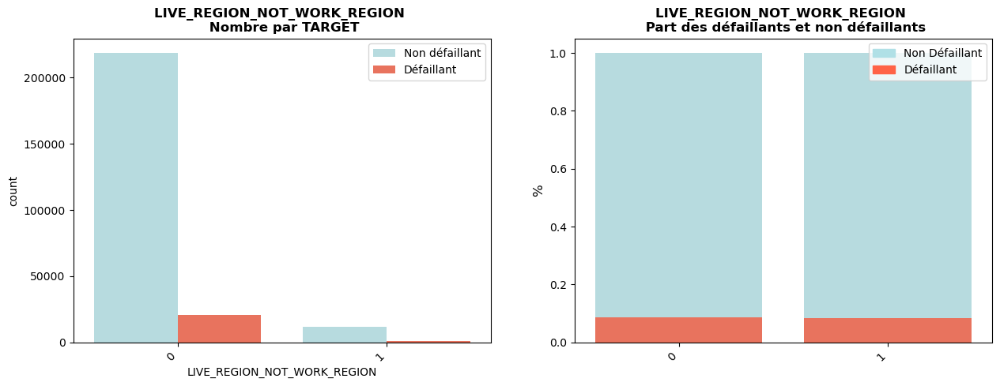

REG_CITY_NOT_LIVE_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.6689844469827782e-98 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


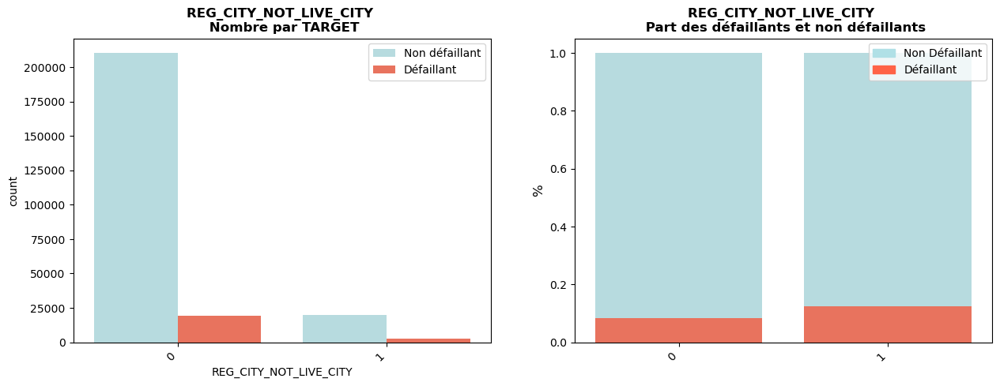

REG_CITY_NOT_WORK_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.009571208915352e-105 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


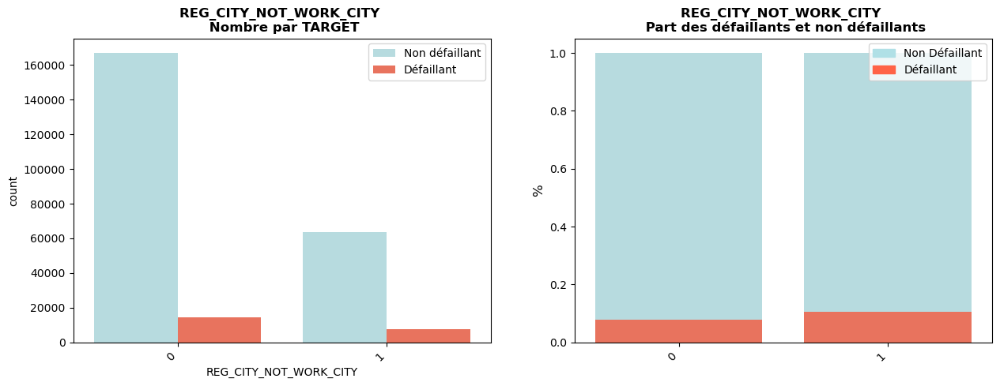

LIVE_CITY_NOT_WORK_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 5.39468578164826e-35 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


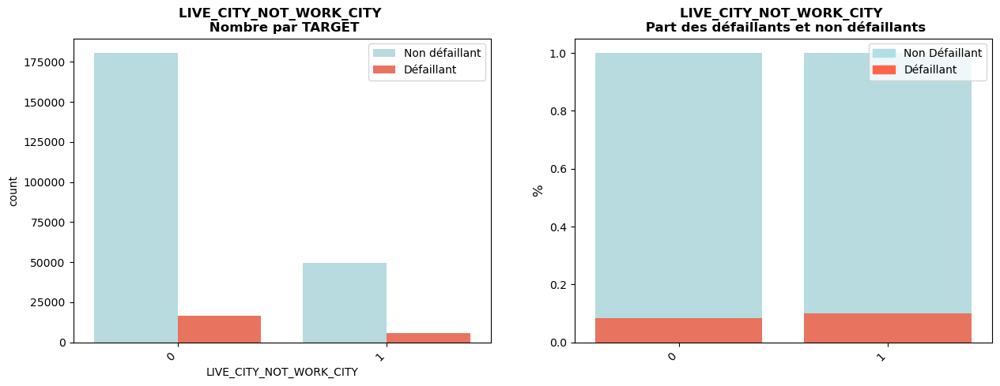

ORGANIZATION_TYPE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 1.885250797906076e-152 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


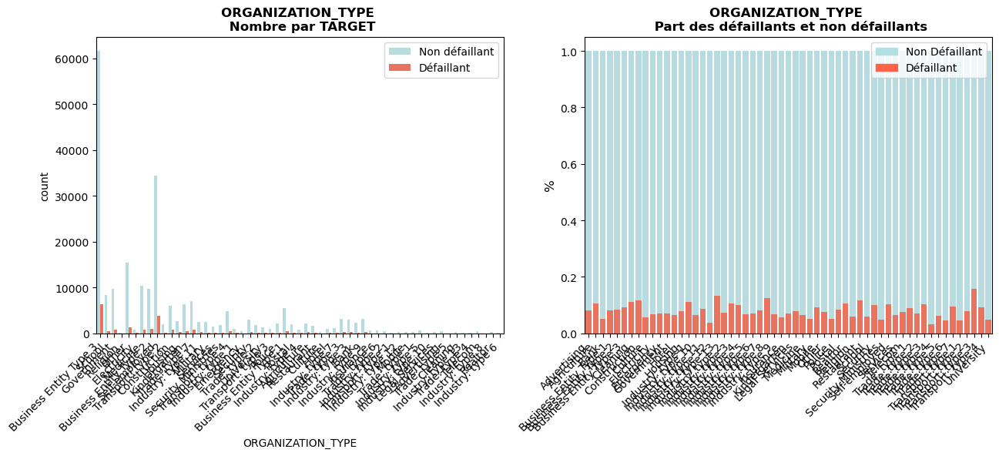

FLAG_DOCUMENT_2 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.019215302376214737 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


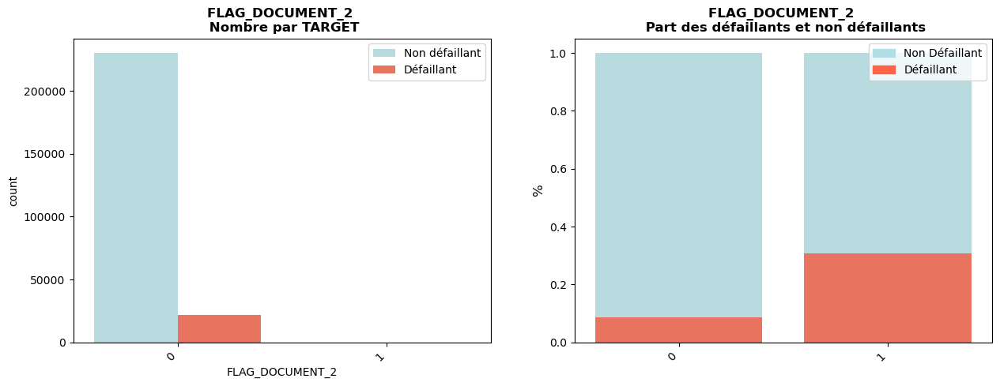

FLAG_DOCUMENT_3 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.724833353303302e-95 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


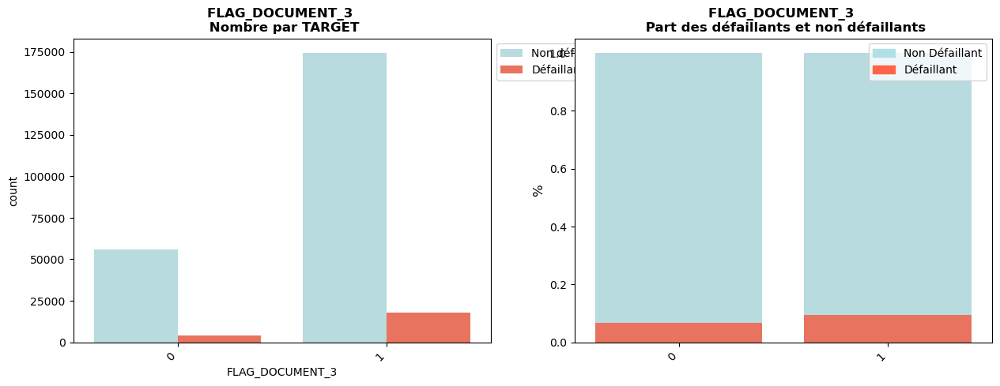

FLAG_DOCUMENT_4 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.327305815175847 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


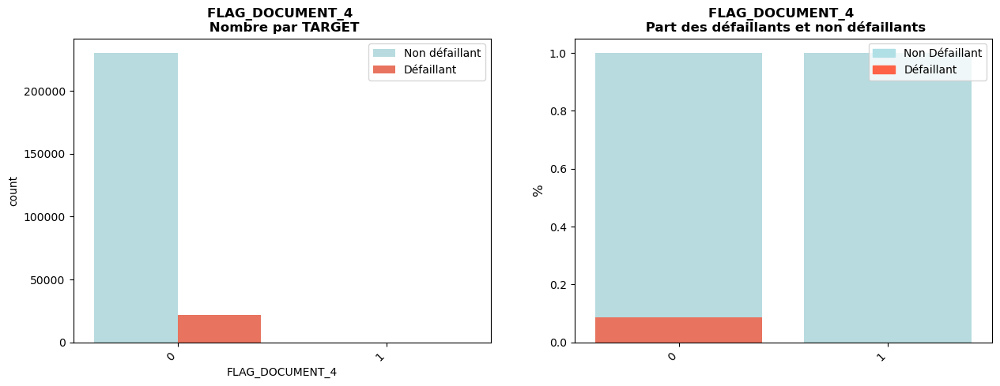

FLAG_DOCUMENT_5 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.7627188819480761 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


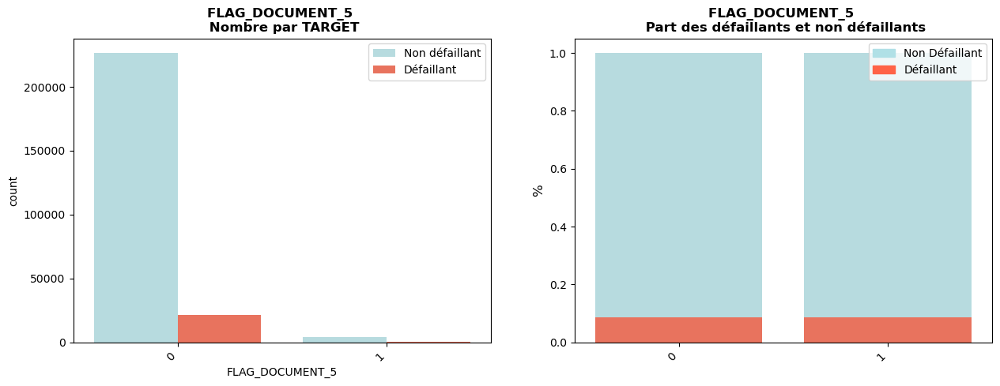

FLAG_DOCUMENT_6 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.834947743430126e-05 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


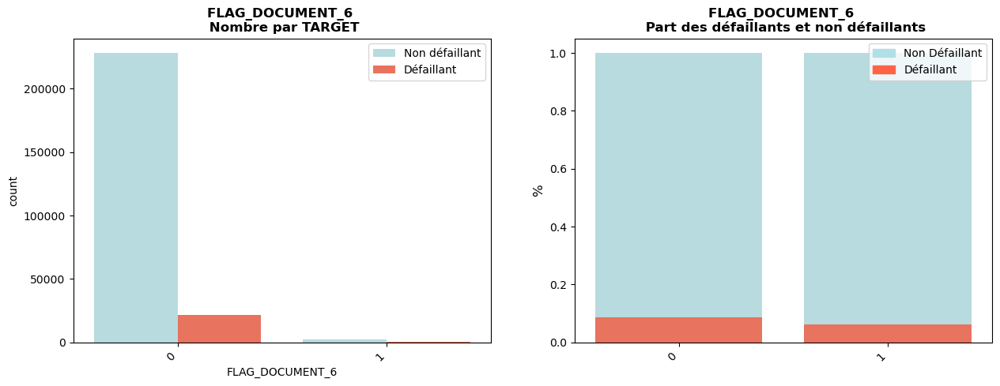

FLAG_DOCUMENT_7 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.6207942610595587 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


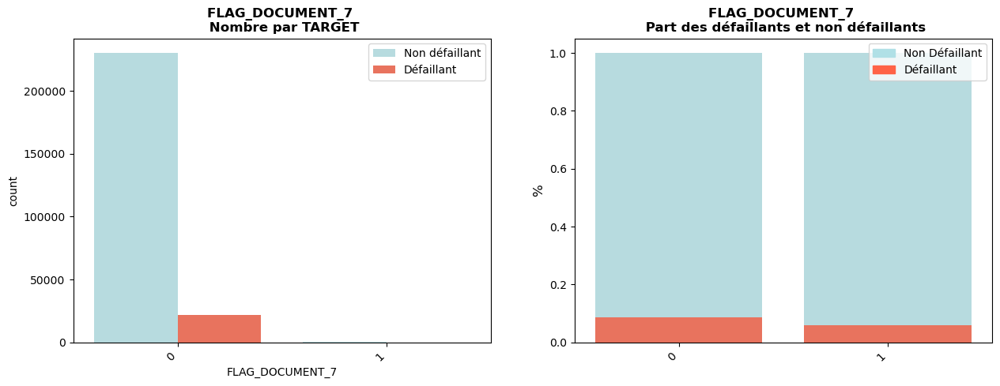

FLAG_DOCUMENT_8 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 8.70058357993136e-13 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


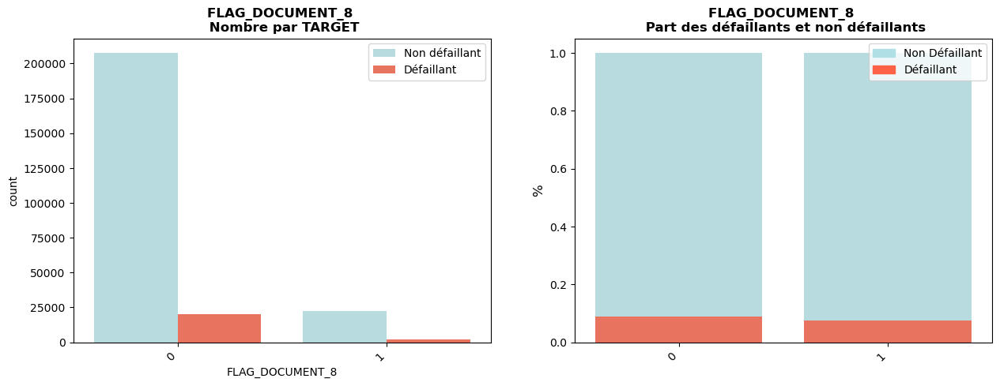

FLAG_DOCUMENT_9 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.00503191273723432 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


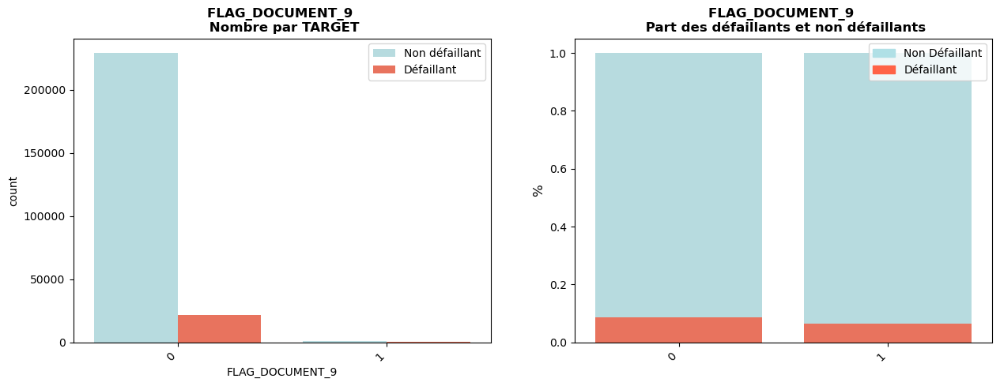

FLAG_DOCUMENT_10 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.9772948782824923 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


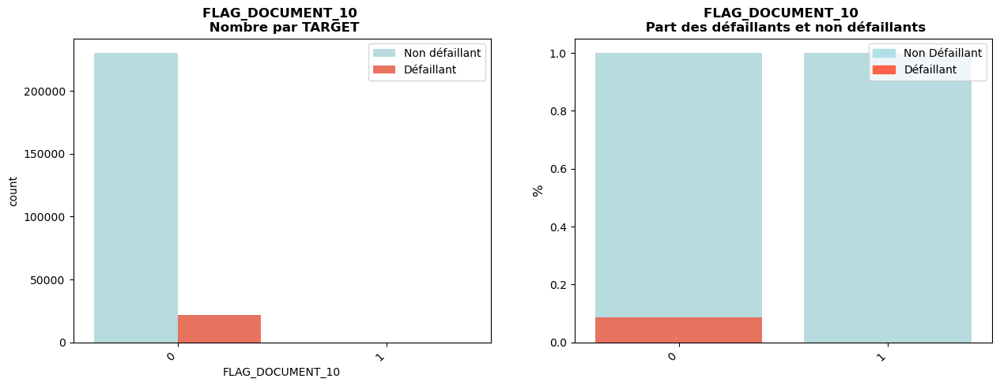

FLAG_DOCUMENT_11 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.003206611757181028 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


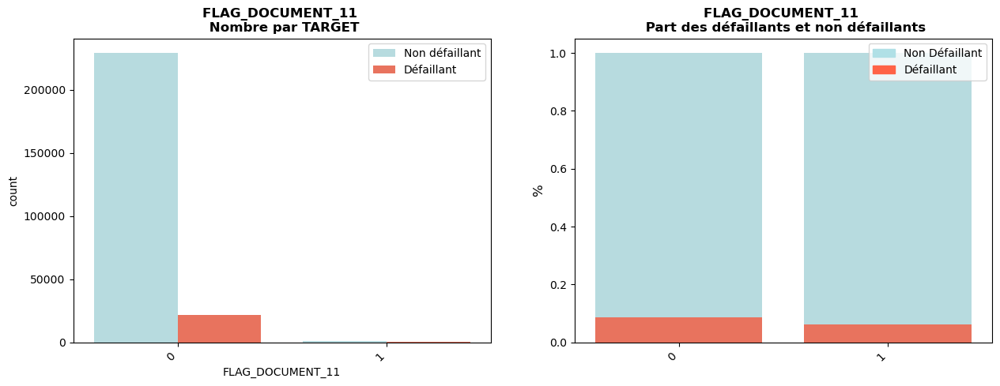

FLAG_DOCUMENT_12 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.4112901814462069 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


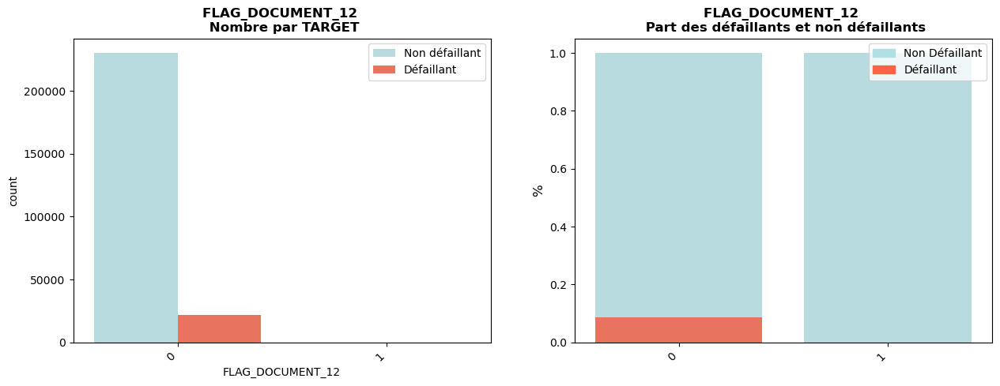

FLAG_DOCUMENT_13 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.2761792358633606e-11 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


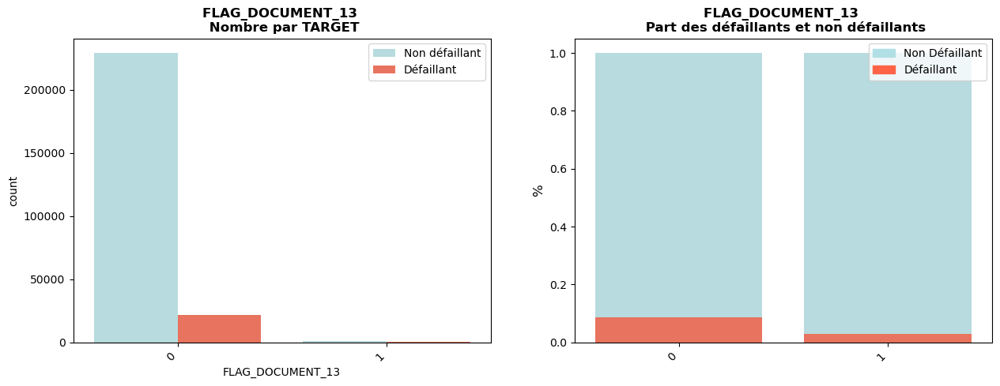

FLAG_DOCUMENT_14 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.577128672337201e-08 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


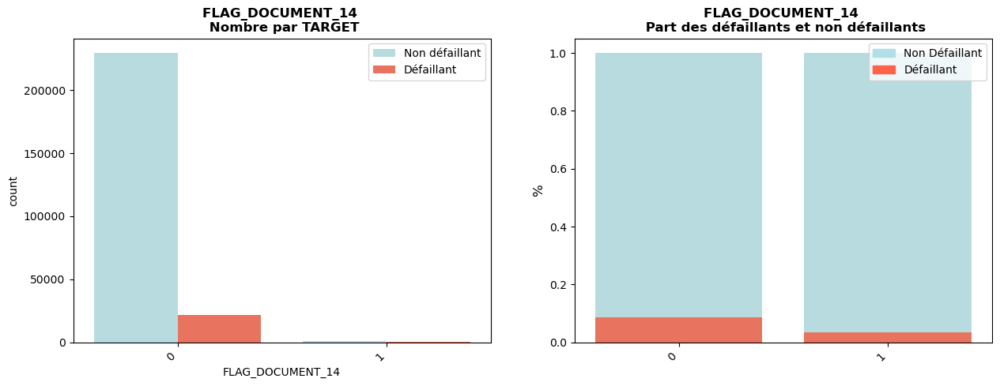

FLAG_DOCUMENT_15 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.00018832289697836205 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


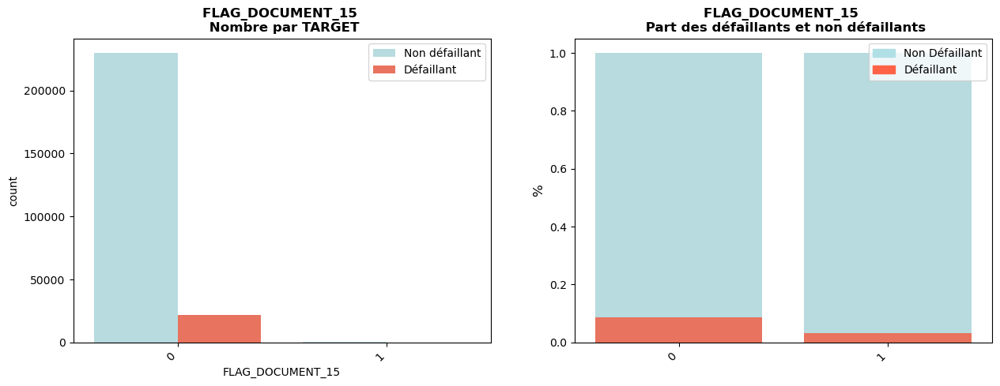

FLAG_DOCUMENT_16 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 7.533358114178402e-13 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


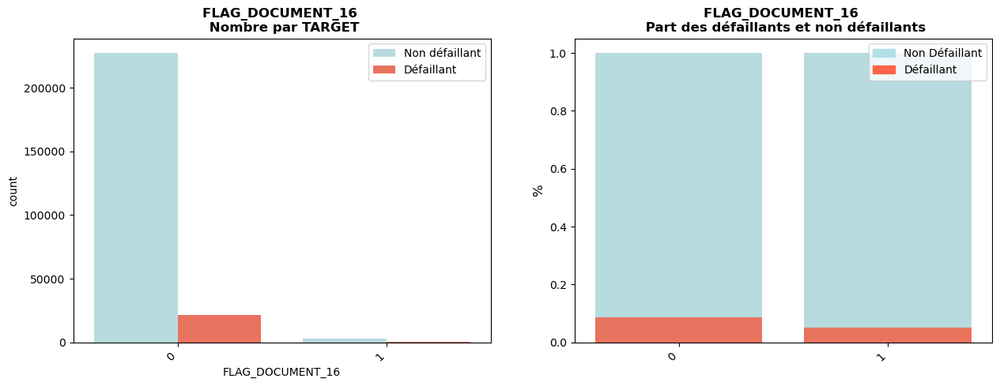

FLAG_DOCUMENT_17 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.07444474581846088 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


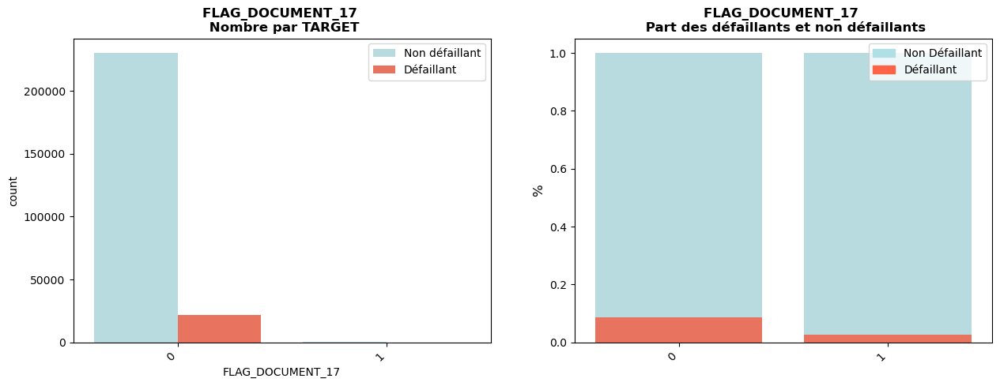

FLAG_DOCUMENT_18 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.1542644756904178e-07 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


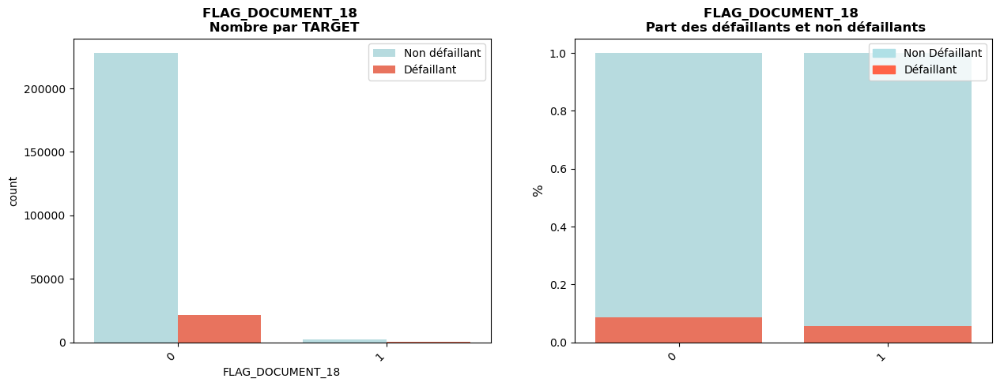

FLAG_DOCUMENT_19 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.4248857522268691 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


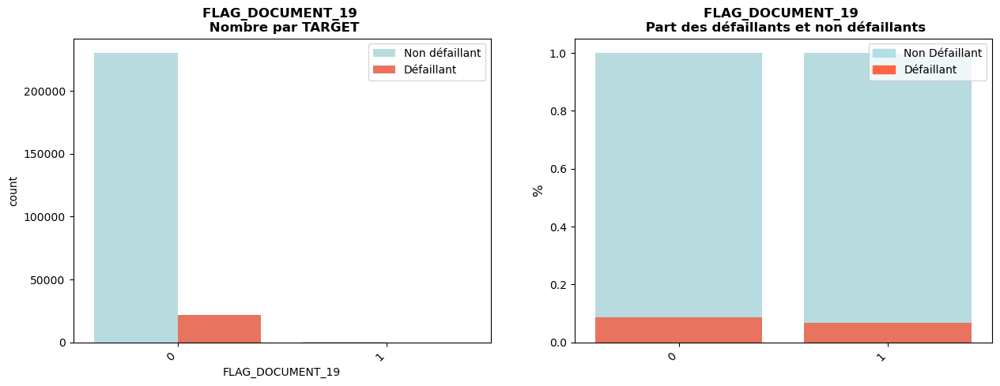

FLAG_DOCUMENT_20 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.0 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


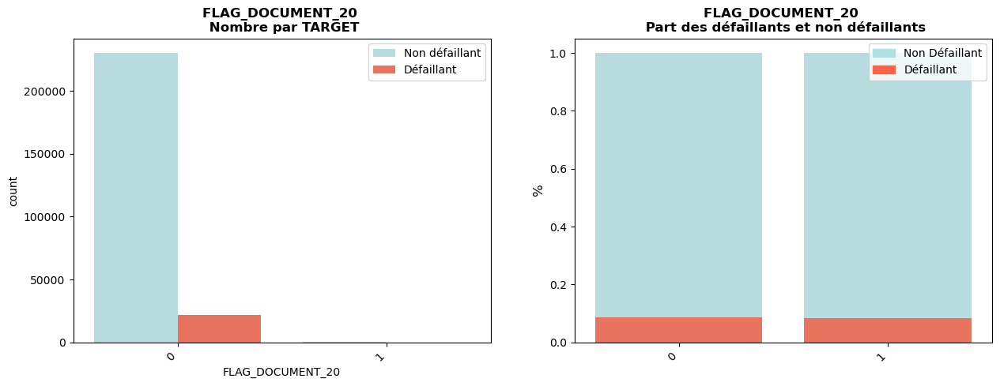

FLAG_DOCUMENT_21 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.10851283849554588 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


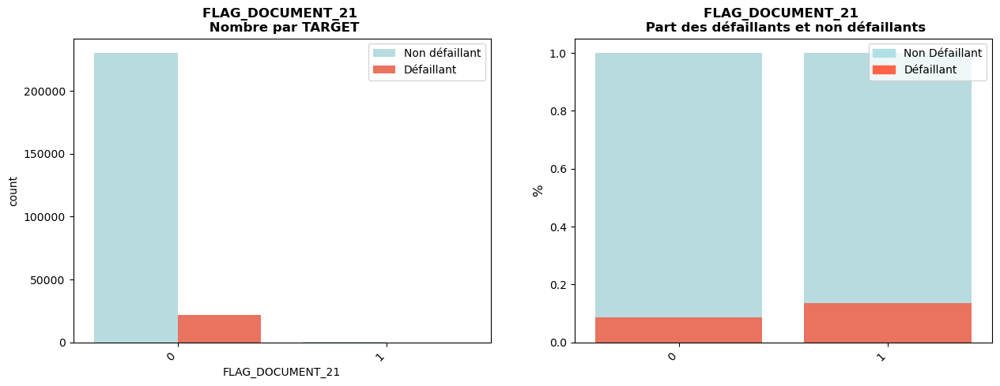

In [41]:
for var in liste_col_quali:
    fct_eda.bivariate_barplots_categ(app_train_desc, var, 'TARGET')

Si l'on regarde la part des défaillants dans le total de chaque variable, nous remarquons que la part des défaillants est plus importante: 
- pour les cash loans
- lorsque l'emprunteur est un homme
- qui ne possède pas sa propre voiture
- lorsque le client est venu seul demander le prêt
- est en congé maternité
- a fait peu d'études
- loue un appartement
- vit dans la région 3 / ville 3
- adresse permanente du client ne matche pas avec l'adresse indiquée pour le contacter (au niveau ville)
- adresse permanente du client ne matche pas avec l'adresse de son travail (au niveau ville)
- le secteur dans lequel le client travaille semble avoir un lien avec le fait qu'il soit défaillant ou non
- le client a fourni le document 2, 3
- le client n'a pas fourni le document 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 21

L'association des variables qualitatives avec la target ayant été testée via Chi2, nous garderons les variables dépendantes ci-dessous:
- NAME_CONTRACT_TYPE
- CODE_GENDER
- FLAG_OWN_CAR
- NAME_TYPE_SUITE
- NAME_INCOME_TYPE
- NAME_EDUCATION_TYPE
- NAME_FAMILY_STATUS
- NAME_HOUSING_TYPE
- FLAG_WORK_PHONE
- FLAG_PHONE
- FLAG_EMAIL
- REGION_RATING_CLIENT
- REGION_RATING_CLIENT_W_CITY
- WEEKDAY_APPR_PROCESS_START
- REG_REGION_NOT_LIVE_REGION
- REG_CITY_NOT_LIVE_CITY
- REG_CITY_NOT_WORK_CITY
- LIVE_CITY_NOT_WORK_CITY
- ORGANIZATION_TYPE 
- FLAG_DOCUMENT_2
- FLAG_DOCUMENT_3
- FLAG_DOCUMENT_6
- FLAG_DOCUMENT_8
- FLAG_DOCUMENT_9
- FLAG_DOCUMENT_11 
- FLAG_DOCUMENT_13 
- FLAG_DOCUMENT_14 
- FLAG_DOCUMENT_15 
- FLAG_DOCUMENT_16 
- FLAG_DOCUMENT_18 

In [42]:
new_list_var_quali = [
    'NAME_CONTRACT_TYPE',
    'CODE_GENDER',
    'FLAG_OWN_CAR',
    'NAME_TYPE_SUITE',
    'NAME_INCOME_TYPE',
    'NAME_EDUCATION_TYPE',
    'NAME_FAMILY_STATUS',
    'NAME_HOUSING_TYPE',
    'FLAG_WORK_PHONE',
    'FLAG_PHONE',
    'FLAG_EMAIL',
    'REGION_RATING_CLIENT',
    'REGION_RATING_CLIENT_W_CITY',
    'WEEKDAY_APPR_PROCESS_START',
    'REG_REGION_NOT_LIVE_REGION',
    'REG_CITY_NOT_LIVE_CITY',
    'REG_CITY_NOT_WORK_CITY',
    'LIVE_CITY_NOT_WORK_CITY',
    'ORGANIZATION_TYPE',
    'FLAG_DOCUMENT_2',
    'FLAG_DOCUMENT_3',
    'FLAG_DOCUMENT_6',
    'FLAG_DOCUMENT_8',
    'FLAG_DOCUMENT_9',
    'FLAG_DOCUMENT_11',
    'FLAG_DOCUMENT_13',
    'FLAG_DOCUMENT_14',
    'FLAG_DOCUMENT_15',
    'FLAG_DOCUMENT_16',
    'FLAG_DOCUMENT_18']

#### Feature engineering

Nous pouvons déduire de nouvelles variables à partir des données existantes dans le dataset. Ce procédé s'appelle le feature engineering. Il s'agit de créer de nouvelles variables qui seront utilisées en apprentissage supervisé. En effet, pour que les algorithmes de Machine Learning fonctionnent bien sur de nouvelles données, il peut être nécessaire de créer et entrainer de nouvelles variables. Voici une sélection de variables qui peuvent être créées grâce à nos données et qui seraient **facilement explicables** aux clients:

- DAYS_EMPLOYED_PERC: le pourcentage de jours de travail (poste actuel) par rapport à l'âge du client
- CREDIT_GOODS_PERC: pourcentage du crédit par rapport au montant du bien acheté
- INCOME_CREDIT_PERC: part du revenu dans le crédit
- INCOME_PER_PERSON: revenu par personne
- DEBT_RATIO: part de l'annuité dans le revenu
- PAYMENT_RATE: part de l'annuité dans le montant du crédit

In [43]:
app_train_desc['DAYS_EMPLOYED_PERC'] = app_train_desc['DAYS_EMPLOYED'] / app_train_desc['DAYS_BIRTH']
app_train_desc['CREDIT_GOODS_PERC'] = app_train_desc['AMT_CREDIT'] / app_train_desc['AMT_GOODS_PRICE']
app_train_desc['INCOME_CREDIT_PERC'] = app_train_desc['AMT_INCOME_TOTAL'] / app_train_desc['AMT_CREDIT']
app_train_desc['INCOME_PER_PERSON'] = app_train_desc['AMT_INCOME_TOTAL'] / app_train_desc['CNT_FAM_MEMBERS']
app_train_desc['DEBT_RATIO'] = app_train_desc['AMT_ANNUITY'] / app_train_desc['AMT_INCOME_TOTAL']
app_train_desc['PAYMENT_RATE'] = app_train_desc['AMT_ANNUITY'] / app_train_desc['AMT_CREDIT']

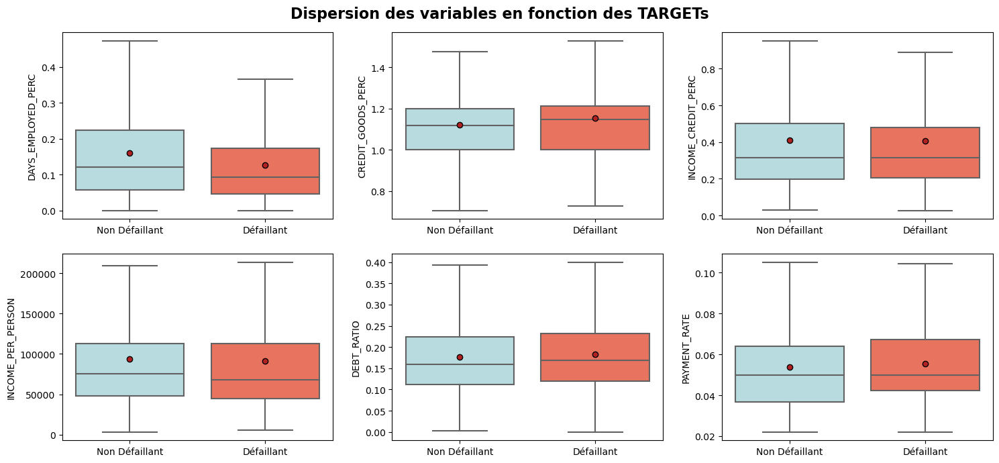

In [44]:
new_list_var_quanti = ['DAYS_EMPLOYED_PERC', 'CREDIT_GOODS_PERC', 'INCOME_CREDIT_PERC',
                       'INCOME_PER_PERSON', 'DEBT_RATIO', 'PAYMENT_RATE']

fig = plt.figure(figsize=(15,7))
fct_eda.bivariate_plots_box(app_train_desc, 'TARGET', new_list_var_quanti, 2, 3, fig)

In [45]:
app_train_select = app_train_desc.copy()

Ces nouvelles variables sont plus intéressantes que les variables initiales qui ne représentaient pas vraiment de tendance. Ici, les écarts entre non défaillants et défaillants sont plus significatifs.

Quant aux variables catégorielles, nous allons les encoder à l'aide du one-hot encoder et label encoder afin qu'elles puissent être intégrées plus tard dans notre modèle de Machine Learning.
Nous utiliserons le **one-hot encoder** sur les variables dont les modalités sont supérieures à 2 et le **label encoder** pour les variables catégorielles à deux modalités (permet d'éviter de rajouter encore plus de colonnes).

In [46]:
# Sélection des variables
app_train_select = app_train_select.set_index('SK_ID_CURR')
app_train_select = app_train_select[new_list_var_quanti + new_list_var_quali + ['TARGET']]
app_train_select.head()

,DAYS_EMPLOYED_PERC,CREDIT_GOODS_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,DEBT_RATIO,PAYMENT_RATE,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_11,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,TARGET
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100002,0.07,1.16,0.50,202500.00,0.12,0.06,Cash loans,M,N,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0,1,0,2,2,WEDNESDAY,0,0,0,0,Business Entity Type 3,0,1,0,0,0,0,0,0,0,0,0,1
100003,0.07,1.15,0.21,135000.00,0.13,0.03,Cash loans,F,N,Family,State servant,Higher education,Married,House / apartment,0,1,0,1,1,MONDAY,0,0,0,0,School,0,1,0,0,0,0,0,0,0,0,0,0
100004,0.01,1.00,0.50,67500.00,0.10,0.05,Revolving loans,M,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,1,1,0,2,2,MONDAY,0,0,0,0,Government,0,0,0,0,0,0,0,0,0,0,0,0
100006,0.16,1.05,0.43,67500.00,0.22,0.09,Cash loans,F,N,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0,0,0,2,2,WEDNESDAY,0,0,0,0,Business Entity Type 3,0,1,0,0,0,0,0,0,0,0,0,0
100007,0.15,1.00,0.24,121500.00,0.18,0.04,Cash loans,M,N,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0,0,0,2,2,THURSDAY,0,0,1,1,Religion,0,0,0,1,0,0,0,0,0,0,0,0


In [47]:
app_train_select, app_train_cat = fct_eda.categories_encoder(app_train_select, nan_as_category = False)
app_train_select.head()

,DAYS_EMPLOYED_PERC,CREDIT_GOODS_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,DEBT_RATIO,PAYMENT_RATE,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,REG_REGION_NOT_LIVE_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_11,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,TARGET,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry: type 1,ORGANIZATION_TYPE_Industry: type 10,ORGANIZATION_TYPE_Industry: type 11,ORGANIZATION_TYPE_Industry: type 12,ORGANIZATION_TYPE_Industry: type 13,ORGANIZATION_TYPE_Industry: type 2,ORGANIZATION_TYPE_Industry: type 3,ORGANIZATION_TYPE_Industry: type 4,ORGANIZATION_TYPE_Industry: type 5,ORGANIZATION_TYPE_Industry: type 6,ORGANIZATION_TYPE_Industry: type 7,ORGANIZATION_TYPE_Industry: type 8,ORGANIZATION_TYPE_Industry: type 9,ORGANIZATION_TYPE_Insurance,ORGANIZATION_TYPE_Kindergarten,ORGANIZATION_TYPE_Legal Services,ORGANIZATION_TYPE_Medicine,ORGANIZATION_TYPE_Military,ORGANIZATION_TYPE_Mobile,ORGANIZATION_TYPE_Other,ORGANIZATION_TYPE_Police,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Realtor,ORGANIZATION_TYPE_Religion,ORGANIZATION_TYPE_Restaurant,ORGANIZATION_TYPE_School,ORGANIZATION_TYPE_Security,ORGANIZATION_TYPE_Security Ministries,ORGANIZATION_TYPE_Self-employed,ORGANIZATION_TYPE_Services,ORGANIZATION_TYPE_Telecom,ORGANIZATION_TYPE_Trade: type 1,ORGANIZATION_TYPE_Trade: type 2,ORGANIZATION_TYPE_Trade: type 3,ORGANIZATION_TYPE_Trade: type 4,ORGANIZATION_TYPE_Trade: type 5,ORGANIZATION_TYPE_Trade: type 6,ORGANIZATION_TYPE_Trade: type 7,ORGANIZATION_TYPE_Transport: type 1,ORGANIZATION_TYPE_Transport: type 2,ORGANIZATION_TYPE_Transport: type 3,ORGANIZATION_TYPE_Transport: type 4,ORGANIZATION_TYPE_University
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100002,0.07,1.16,0.50,202500.00,0.12,0.06,0,1,0,0,1,0,2,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
100003,0.07,1.15,0.21,135000.00,0.13,0.03,0,0,0,0

In [48]:
app_train_select.isna().sum().sort_values(ascending = False)

DAYS_EMPLOYED_PERC                                   0
ORGANIZATION_TYPE_Government                         0
ORGANIZATION_TYPE_Industry: type 7                   0
ORGANIZATION_TYPE_Industry: type 6                   0
ORGANIZATION_TYPE_Industry: type 5                   0
ORGANIZATION_TYPE_Industry: type 4                   0
ORGANIZATION_TYPE_Industry: type 3                   0
ORGANIZATION_TYPE_Industry: type 2                   0
ORGANIZATION_TYPE_Industry: type 13                  0
ORGANIZATION_TYPE_Industry: type 12                  0
ORGANIZATION_TYPE_Industry: type 11                  0
ORGANIZATION_TYPE_Industry: type 10                  0
ORGANIZATION_TYPE_Industry: type 1                   0
ORGANIZATION_TYPE_Housing                            0
ORGANIZATION_TYPE_Hotel                              0
ORGANIZATION_TYPE_Emergency                          0
WEEKDAY_APPR_PROCESS_START_SATURDAY                  0
ORGANIZATION_TYPE_Electricity                        0
ORGANIZATI

In [49]:
app_train_select.shape

(252133, 125)

#### Fonction de preprocessing

In [50]:
def preprocess_app_train_test():
    '''Fonction de preprocessing des datasets application_train et application_test:
    merge, traitement des données manquantes, traitement des outliers et des modalités,
    feature engineering
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    # Chargement des datasets et regroupement
    app_train = pd.read_csv('data/application_train.csv', sep=',', encoding='utf-8')
    
    # Traitement des données manquantes
        # Suppression des variables avec 30% ou plus de NaN
    app_train = fct_eda.tx_rempl_min(app_train, 70)
        # iterative imputer pour les variables corrélées entre-elles
    app_train['OBS_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,0]
    app_train['OBS_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,1]
    app_train['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_GOODS_PRICE', 'AMT_CREDIT']])[:,0]
    app_train['CNT_FAM_MEMBERS'] = fct_eda.iterative_imputer_function(
        app_train[['CNT_FAM_MEMBERS', 'CNT_CHILDREN']])[:,0]
    app_train['DEF_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,0]
    app_train['DEF_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,1]
    app_train['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,0]
    app_train['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,1]
    app_train['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_CREDIT', 'AMT_ANNUITY']])[:,1]
        # Médiane et mode pour variables avec taux de NaN > 80% (hors variable TARGET)
    df_nan = fct_eda.nan_a_retraiter(app_train)
    col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                     (df_nan['dtypes'] == 'float64') &
                     (~ df_nan.index.str.contains('TARGET'))].index.tolist()
    for col in col_med:
        app_train[col] = app_train[col].fillna(app_train[col].median())
    del app_train['AMT_REQ_CREDIT_BUREAU_YEAR']
    del app_train['EXT_SOURCE_3']
    app_train['NAME_TYPE_SUITE'] = app_train['NAME_TYPE_SUITE'].fillna(app_train['NAME_TYPE_SUITE'].mode()[0])
    
    # Outliers et traitement des modalités
    app_train.drop(app_train[app_train['DAYS_EMPLOYED'] == 365243].index, inplace=True)    
    app_train = app_train[app_train['CODE_GENDER'].isin(["F", "M"])]
    
    # Feature engineering
    app_train['DAYS_EMPLOYED_PERC'] = app_train['DAYS_EMPLOYED'] / app_train['DAYS_BIRTH']
    app_train['CREDIT_GOODS_PERC'] = app_train['AMT_CREDIT'] / app_train['AMT_GOODS_PRICE']
    app_train['INCOME_CREDIT_PERC'] = app_train['AMT_INCOME_TOTAL'] / app_train['AMT_CREDIT']
    app_train['INCOME_PER_PERSON'] = app_train['AMT_INCOME_TOTAL'] / app_train['CNT_FAM_MEMBERS']
    app_train['DEBT_RATIO'] = app_train['AMT_ANNUITY'] / app_train['AMT_INCOME_TOTAL']
    app_train['PAYMENT_RATE'] = app_train['AMT_ANNUITY'] / app_train['AMT_CREDIT']
    
    new_list_var_quanti = ['DAYS_EMPLOYED_PERC', 'CREDIT_GOODS_PERC', 'INCOME_CREDIT_PERC',
                           'INCOME_PER_PERSON', 'DEBT_RATIO', 'PAYMENT_RATE']
    
    new_list_var_quali = ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'NAME_TYPE_SUITE',
                          'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
                          'NAME_HOUSING_TYPE', 'FLAG_WORK_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL',
                          'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'WEEKDAY_APPR_PROCESS_START', 
                          'REG_REGION_NOT_LIVE_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
                          'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3',
                          'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_11',
                          'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 
                          'FLAG_DOCUMENT_18']
    
    app_train = app_train.set_index('SK_ID_CURR')
    app_train = app_train[new_list_var_quanti + new_list_var_quali + ['TARGET']]
    app_train, app_train_cat = fct_eda.categories_encoder(app_train, nan_as_category = False)
    
    gc.collect()
    
    return app_train

In [51]:
preprocess_app_train_test()

,DAYS_EMPLOYED_PERC,CREDIT_GOODS_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,DEBT_RATIO,PAYMENT_RATE,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,REG_REGION_NOT_LIVE_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_11,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,TARGET,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry: type 1,ORGANIZATION_TYPE_Industry: type 10,ORGANIZATION_TYPE_Industry: type 11,ORGANIZATION_TYPE_Industry: type 12,ORGANIZATION_TYPE_Industry: type 13,ORGANIZATION_TYPE_Industry: type 2,ORGANIZATION_TYPE_Industry: type 3,ORGANIZATION_TYPE_Industry: type 4,ORGANIZATION_TYPE_Industry: type 5,ORGANIZATION_TYPE_Industry: type 6,ORGANIZATION_TYPE_Industry: type 7,ORGANIZATION_TYPE_Industry: type 8,ORGANIZATION_TYPE_Industry: type 9,ORGANIZATION_TYPE_Insurance,ORGANIZATION_TYPE_Kindergarten,ORGANIZATION_TYPE_Legal Services,ORGANIZATION_TYPE_Medicine,ORGANIZATION_TYPE_Military,ORGANIZATION_TYPE_Mobile,ORGANIZATION_TYPE_Other,ORGANIZATION_TYPE_Police,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Realtor,ORGANIZATION_TYPE_Religion,ORGANIZATION_TYPE_Restaurant,ORGANIZATION_TYPE_School,ORGANIZATION_TYPE_Security,ORGANIZATION_TYPE_Security Ministries,ORGANIZATION_TYPE_Self-employed,ORGANIZATION_TYPE_Services,ORGANIZATION_TYPE_Telecom,ORGANIZATION_TYPE_Trade: type 1,ORGANIZATION_TYPE_Trade: type 2,ORGANIZATION_TYPE_Trade: type 3,ORGANIZATION_TYPE_Trade: type 4,ORGANIZATION_TYPE_Trade: type 5,ORGANIZATION_TYPE_Trade: type 6,ORGANIZATION_TYPE_Trade: type 7,ORGANIZATION_TYPE_Transport: type 1,ORGANIZATION_TYPE_Transport: type 2,ORGANIZATION_TYPE_Transport: type 3,ORGANIZATION_TYPE_Transport: type 4,ORGANIZATION_TYPE_University
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100002,0.07,1.16,0.50,202500.00,0.12,0.06,0,1,0,0,1,0,2,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
100003,0.07,1.15,0.21,135000.00,0.13,0.03,0,0,0,0

### bureau.csv et bureau_balance.csv <a class="anchor" id="bureau"></a>

#### Principales statistiques

**Bureau**: cette table contient les données relatives aux **demandes de prêts antérieures** que le client a obtenus auprès **d'autres institutions de credit** et qui ont été communiquées à Credit Bureau. Pour chaque prêt dans application_train, il peut y avoir plusieurs lignes correspondant aux crédits antérieurs.

**Bureau_balance**: solde mensuel des crédits à Credit Bureau. Ce tableau comporte une ligne pour chaque mois de l'historique de chaque crédit antérieur signalé au bureau de crédit.

In [52]:
# Chargement des datasets
bureau = pd.read_csv('data/bureau.csv',
                     sep=',',
                     encoding='utf-8')

bureau_balance = pd.read_csv('data/bureau_balance.csv',
                             sep=',',
                             encoding='utf-8')

In [53]:
# Description des colonnes
col_desc[col_desc['Table'] == 'bureau.csv']

,Unnamed: 0,Table,Row,Description,Special
122,125,bureau.csv,SK_ID_CURR,"ID of loan in our sample - one loan in our sample can have 0,1,2 or more related previous credits in credit bureau",hashed
123,126,bureau.csv,SK_BUREAU_ID,Recoded ID of previous Credit Bureau credit related to our loan (unique coding for each loan application),hashed
124,127,bureau.csv,CREDIT_ACTIVE,Status of the Credit Bureau (CB) reported credits,NaN
125,128,bureau.csv,CREDIT_CURRENCY,Recoded currency of the Credit Bureau credit,recoded
126,129,bureau.csv,DAYS_CREDIT,How many days before current application did client apply for Credit Bureau credit,time only relative to the application
127,130,bureau.csv,CREDIT_DAY_OVERDUE,Number of days past due on CB credit at the time of application for related loan in our sample,NaN
128,131,bureau.csv,DAYS_CREDIT_ENDDATE,Remaining duration of CB credit (in days) at the time of application in Home Credit,time only relative to the application
129,132,bureau.csv,DAYS_ENDDATE_FACT,Days since CB credit ended at the time of application in Home Credit (only for closed credit),time only relative to the application
130,133,bureau.csv,AMT_CREDIT_MAX_OVERDUE,Maximal amount overdue on the Credit Bureau credit so far (at application date of loan in our sample),NaN
131,134,bureau.csv,CNT_CREDIT_PROLONG,How many times was the Credit Bureau credit prolonged,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.00,-153.00,NaN,0,91323.00,0.00,NaN,0.00,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.00,NaN,NaN,0,225000.00,171342.00,NaN,0.00,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.00,NaN,NaN,0,464323.50,NaN,NaN,0.00,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.00,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.00,NaN,77674.50,0,2700000.00,NaN,NaN,0.00,Consumer credit,-21,NaN


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
1716423,259355,5057750,Active,currency 1,-44,0,-30.00,NaN,0.00,0,11250.00,11250.00,0.00,0.00,Microloan,-19,NaN
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433.00,-2493.00,5476.50,0,38130.84,0.00,0.00,0.00,Consumer credit,-2493,NaN
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628.00,-970.00,NaN,0,15570.00,NaN,NaN,0.00,Consumer credit,-967,NaN
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513.00,-1513.00,NaN,0,36000.00,0.00,0.00,0.00,Consumer credit,-1508,NaN
1716427,246829,5057778,Closed,currency 1,-463,0,NaN,-387.00,NaN,0,22500.00,0.00,NaN,0.00,Microloan,-387,NaN


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 1716428
Nombre de colonnes: 17
Nombre total de NaN du dataset: 3939947
% total de NaN du dataset: 13.5%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


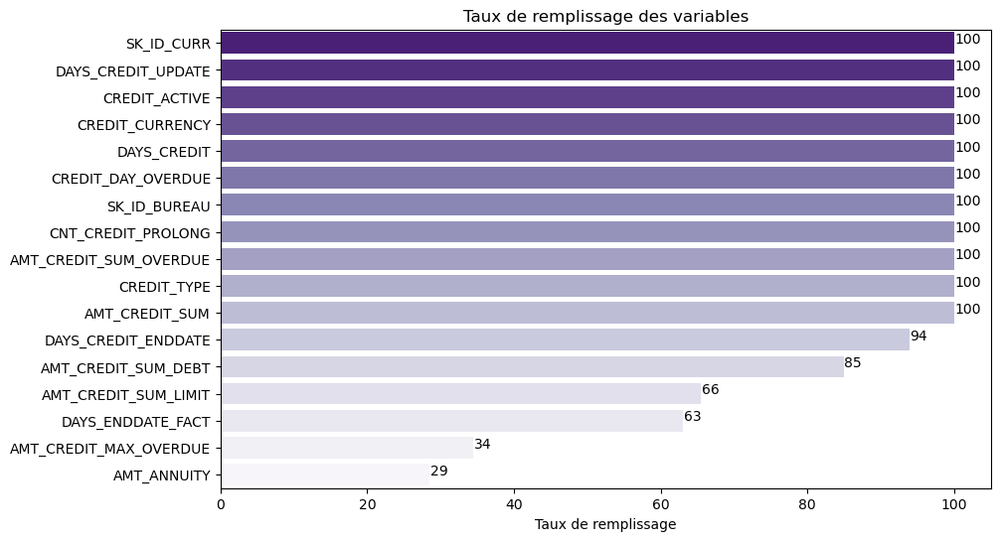

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_CURR,int64,215354,1716428,305811,17.82,1716428,100.00,0,0.00
1,SK_ID_BUREAU,int64,5714462,1716428,1716428,100.00,1716428,100.00,0,0.00
2,CREDIT_ACTIVE,object,Closed,1716428,4,0.00,1716428,100.00,0,0.00
3,CREDIT_CURRENCY,object,currency 1,1716428,4,0.00,1716428,100.00,0,0.00
4,DAYS_CREDIT,int64,-497,1716428,2923,0.17,1716428,100.00,0,0.00
5,CREDIT_DAY_OVERDUE,int64,0,1716428,942,0.05,1716428,100.00,0,0.00
6,DAYS_CREDIT_ENDDATE,float64,-153.00,1716428,14096,0.82,1610875,93.85,105553,6.15
7,DAYS_ENDDATE_FACT,float64,-153.00,1716428,2917,0.17,1082775,63.08,633653,36.92
8,AMT_CREDIT_MAX_OVERDUE,float64,77674.50,1716428,68251,3.98,591940,34.49,1124488,65.51
9,CNT_CREDIT_PROLONG,int64,0,1716428,10,0.00,1716428,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [54]:
plt.figure(figsize=(10, 6))
bureau_desc = fct_eda.describe_stat(bureau, fig = fig)

In [55]:
# Description des colonnes
col_desc[col_desc['Table'] == 'bureau_balance.csv']

,Unnamed: 0,Table,Row,Description,Special
139,142,bureau_balance.csv,SK_BUREAU_ID,Recoded ID of Credit Bureau credit (unique coding for each application) - use this to join to CREDIT_BUREAU table,hashed
140,143,bureau_balance.csv,MONTHS_BALANCE,Month of balance relative to application date (-1 means the freshest balance date),time only relative to the application
141,144,bureau_balance.csv,STATUS,"Status of Credit Bureau loan during the month (active, closed, DPD0-30, [C means closed, X means status unknown, 0 means no DPD, 1 means maximal did during month between 1-30, 2 means DPD 31-60, 5 means DPD 120+ or sold or written off ] )",NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
27299920,5041336,-47,X
27299921,5041336,-48,X
27299922,5041336,-49,X
27299923,5041336,-50,X
27299924,5041336,-51,X


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 27299925
Nombre de colonnes: 3
Nombre total de NaN du dataset: 0
% total de NaN du dataset: 0.0%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


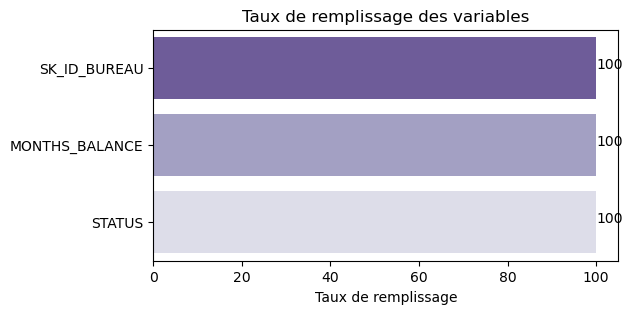

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_BUREAU,int64,5715448,27299925,817395,2.99,27299925,100.00,0,0.00
1,MONTHS_BALANCE,int64,0,27299925,97,0.00,27299925,100.00,0,0.00
2,STATUS,object,C,27299925,8,0.00,27299925,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [56]:
fig = plt.figure(figsize=(6, 3))
bureau_balance_desc = fct_eda.describe_stat(bureau_balance, fig = fig)

#### Preprocessing bureau_balance et merge avec bureau

Nous allons preprocesser en premier bureau_balance qui comporte beaucoup moins de variables. Il sera ensuite fusionné à la table bureau.

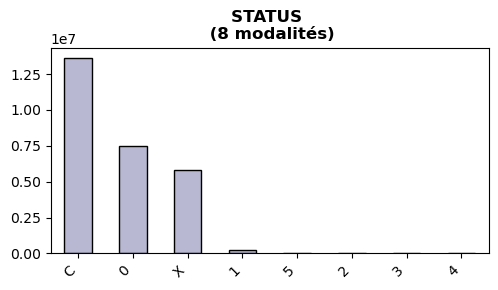

In [57]:
# Différentes modalités de la variable STATUS
fig = plt.figure(figsize=(5, 3))
fct_eda.categ_distrib_plot(bureau_balance, ['STATUS'], 1, 1, fig = fig)

In [58]:
bureau_balance['STATUS'].value_counts()

C    13646993
0     7499507
X     5810482
1      242347
5       62406
2       23419
3        8924
4        5847
Name: STATUS, dtype: int64

Afin de faciliter les traitements, nous allons **agréger la table bureau_balance au niveau du SK_ID_BUREAU** afin de n'avoir qu'une ligne par crédit antérieur enregistré au Credit Bureau. Nous récupérerons le minimum, le maximum et le nombre (valeurs manquantes incluses) pour la variable numérique puis ferons la moyenne de la variable catégorielle STATUS que nous allons auparavant **One Hot encoder** afin de n'avoir que des entrées numériques par la suite:

In [59]:
# One Hot Encoder (modalités > 2)
bureau_balance_ohe, bureau_balance_cat = fct_eda.categories_encoder(bureau_balance, nan_as_category = False)
bureau_balance_ohe.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS_0,STATUS_1,STATUS_2,STATUS_3,STATUS_4,STATUS_5,STATUS_C,STATUS_X
0,5715448,0,0,0,0,0,0,0,1,0
1,5715448,-1,0,0,0,0,0,0,1,0
2,5715448,-2,0,0,0,0,0,0,1,0
3,5715448,-3,0,0,0,0,0,0,1,0
4,5715448,-4,0,0,0,0,0,0,1,0


In [60]:
# Dictionnaire des agrégations
bureau_balance_aggreg = {'MONTHS_BALANCE': ['min', 'max', 'size']}
for col in bureau_balance_cat:
        bureau_balance_aggreg[col] = ['mean']

In [61]:
bureau_balance_aggreg

{'MONTHS_BALANCE': ['min', 'max', 'size'],
 'STATUS_0': ['mean'],
 'STATUS_1': ['mean'],
 'STATUS_2': ['mean'],
 'STATUS_3': ['mean'],
 'STATUS_4': ['mean'],
 'STATUS_5': ['mean'],
 'STATUS_C': ['mean'],
 'STATUS_X': ['mean']}

In [62]:
# Groupe par SK_ID_BUREAU avec application du dictionnaire des agrégations
bureau_balance_ohe_gby = bureau_balance_ohe.groupby('SK_ID_BUREAU').agg(bureau_balance_aggreg)
bureau_balance_ohe_gby

MONTHS_BALANCE          STATUS_0 STATUS_1 STATUS_2 STATUS_3 STATUS_4 STATUS_5 STATUS_C STATUS_X
                        min max size     mean     mean     mean     mean     mean     mean     mean     mean
SK_ID_BUREAU                                                                                                
5001709                 -96   0   97     0.00     0.00     0.00     0.00     0.00     0.00     0.89     0.11
5001710                 -82   0   83     0.06     0.00     0.00     0.00     0.00     0.00     0.58     0.36
5001711                  -3   0    4     0.75     0.00     0.00     0.00     0.00     0.00     0.00     0.25
5001712                 -18   0   19     0.53     0.00     0.00     0.00     0.00     0.00     0.47     0.00
5001713                 -21   0   22     0.00     0.00     0.00     0.00     0.00     0.00     0.00     1.00
...                     ...  ..  ...      ...      ...      ...      ...      ...      ...      ...      ...
6842884                 -47   0   48     0.19     0.00     0.00     0.00     0.00     0.00     0.42     0.40
6842885                 -23   0   24     0.50     0.00     0.00     0.00     0.00     0.50     0.00     0.00
6842886                 -32   0   33     0.24     0.00     0.00     0.00     0.00     0.00     0.76     0.00
6842887                 -36   0   37     0.16     0.00     0.00     0.00     0.00     0.00     0.84     0.00
6842888                 -61   0   62     0.15     0.02     0.00     0.00     0.00     0.00     0.84     0.00

[817395 rows x 11 columns]

In [63]:
# Renommage des colonnes pour éviter les niveaux multiples
bureau_balance_ohe_gby.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bureau_balance_ohe_gby.columns.tolist()])
bureau_balance_ohe_gby

,MONTHS_BALANCE_MIN,MONTHS_BALANCE_MAX,MONTHS_BALANCE_SIZE,STATUS_0_MEAN,STATUS_1_MEAN,STATUS_2_MEAN,STATUS_3_MEAN,STATUS_4_MEAN,STATUS_5_MEAN,STATUS_C_MEAN,STATUS_X_MEAN
SK_ID_BUREAU,,,,,,,,,,,
5001709,-96,0,97,0.00,0.00,0.00,0.00,0.00,0.00,0.89,0.11
5001710,-82,0,83,0.06,0.00,0.00,0.00,0.00,0.00,0.58,0.36
5001711,-3,0,4,0.75,0.00,0.00,0.00,0.00,0.00,0.00,0.25
5001712,-18,0,19,0.53,0.00,0.00,0.00,0.00,0.00,0.47,0.00
5001713,-21,0,22,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00
...,...,...,...,...,...,...,...,...,...,...,...
6842884,-47,0,48,0.19,0.00,0.00,0.00,0.00,0.00,0.42,0.40
6842885,-23,0,24,0.50,0.00,0.00,0.00,0.00,0.50,0.00,0.00
6842886,-32,0,33,0.24,0.00,0.00,0.00,0.00,0.00,0.76,0.00


In [64]:
# Fusion de bureau et bureau balance et suppression de la variable SK_ID_BUREAU
bureau_bb = bureau.join(bureau_balance_ohe_gby, how = 'left', on = 'SK_ID_BUREAU')
bureau_bb.drop(['SK_ID_BUREAU'], axis = 1, inplace = True)

#### Traitement des données manquantes

Nous allons imputer les données manquantes de différentes manières:
- **moyenne** pour les variables **STATUS**: variable qui me semble importante mais qui a beaucoup de NaN
- **suppression** des variables avec plus de **30% de données manquantes**
- lorsque le pourcentage de valeurs manquantes est relativement **faible** (<=30%), nous imputerons par la **médiane** pour les variables quantitatives.

Pour nous assurer que nos méthodes sont cohérentes, nous analyserons les **distributions** avant et après imputations.

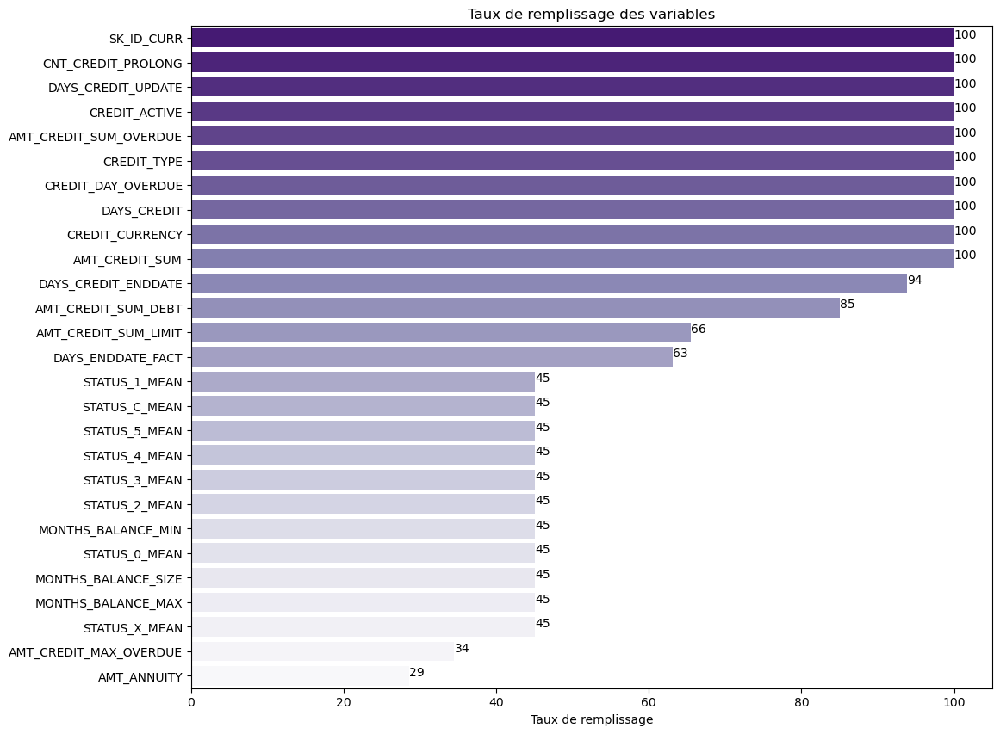

In [65]:
fig = plt.figure(figsize=(12, 10))
fct_eda.plot_tx_remplissage(bureau_bb, fig = fig)

<div class="alert alert-block alert-warning">
    <p>Moyenne pour les variables STATUS</p>
</div>

In [66]:
bureau_bb_mean = bureau_bb.copy()

In [67]:
for col in bureau_bb_mean.columns[bureau_bb_mean.columns.str.contains('STATUS')]:
    bureau_bb_mean[col] = bureau_bb_mean[col].fillna(bureau_bb_mean[col].mean())

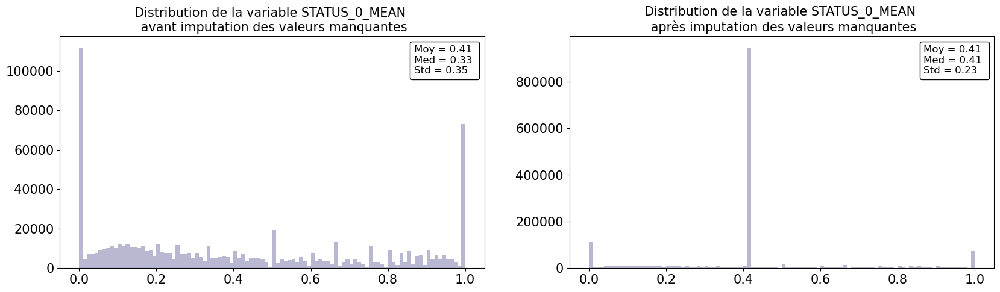

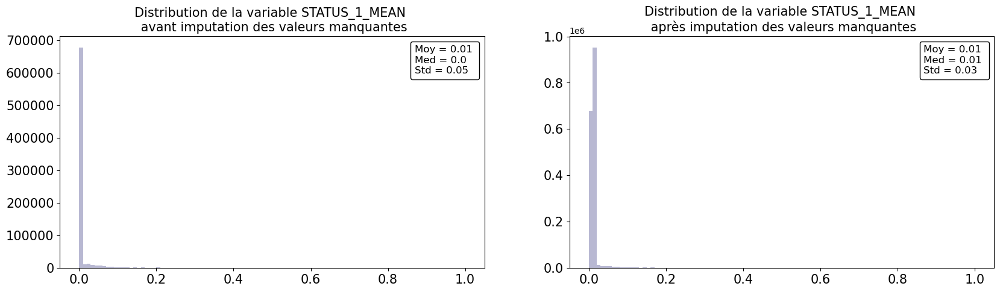

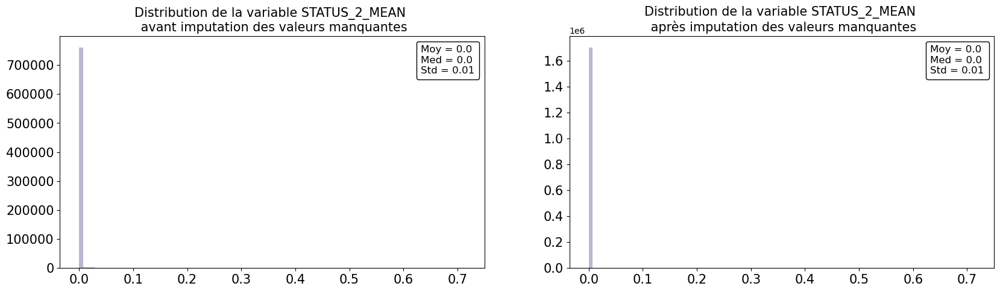

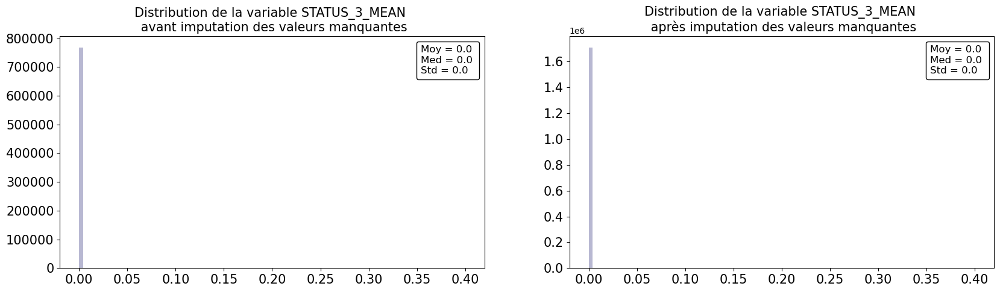

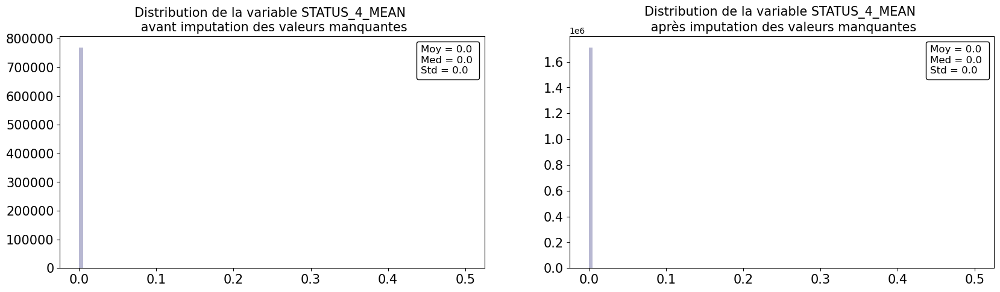

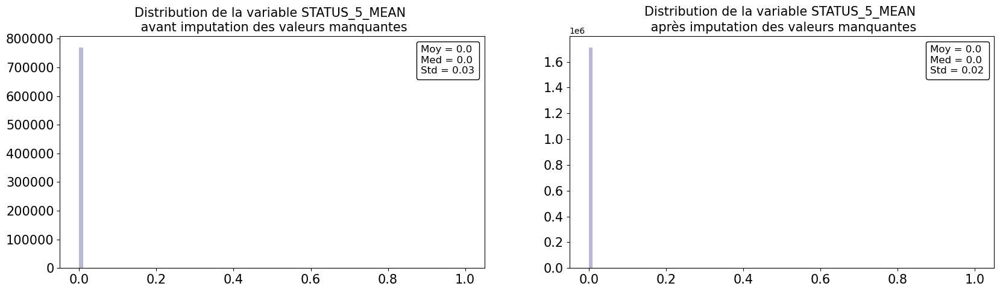

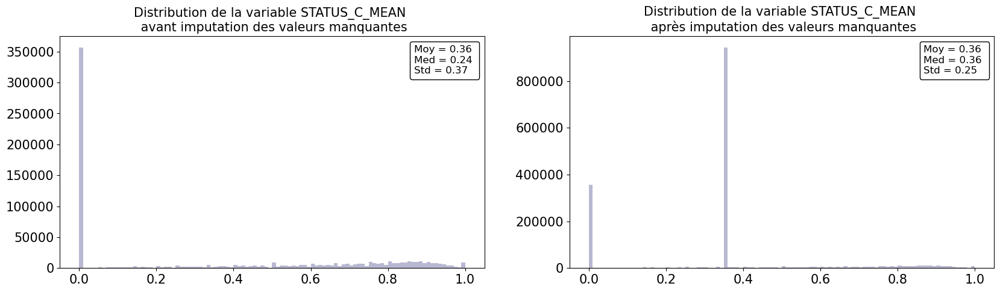

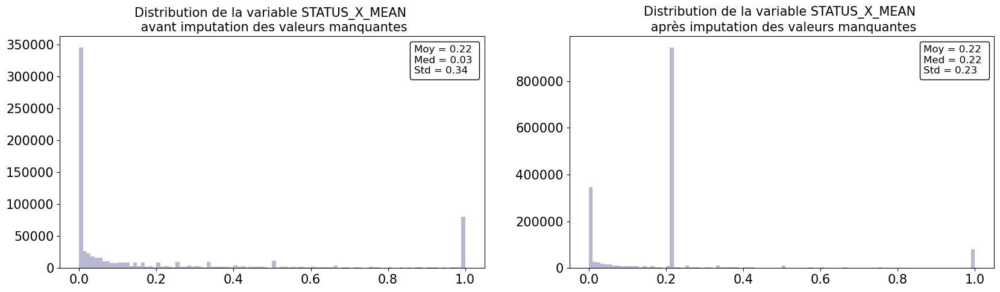

In [68]:
for var in bureau_bb_mean.columns[bureau_bb_mean.columns.str.contains('STATUS')]:
    fct_eda.distrib_imput_nan_quanti(bureau_bb, var, bureau_bb_mean)

La distribution des variables STATUS_X_MEAN, STATUS_C_MEAN et STATUS_0_MEAN ayant changée après imputation des valeurs manquantes, nous décidons de supprimer ces variables.

In [69]:
del bureau_bb_mean['STATUS_X_MEAN']
del bureau_bb_mean['STATUS_C_MEAN']
del bureau_bb_mean['STATUS_0_MEAN']

<div class="alert alert-block alert-warning">
    <p>Suppression des variables avec 30% ou plus de NaN</p>
</div>

In [70]:
# Suppression des variables avec 30% ou plus de NaN
bureau_bb_nan = fct_eda.tx_rempl_min(bureau_bb_mean, 70)
fct_eda.nan_a_retraiter(bureau_bb_nan)

,Tx_rempl,nb_NaN,dtypes
AMT_CREDIT_SUM,100.00,13,float64
DAYS_CREDIT_ENDDATE,93.85,105553,float64
AMT_CREDIT_SUM_DEBT,84.99,257669,float64


<div class="alert alert-block alert-warning">
    <p>Médiane pour variables avec taux de remplissage > 70%</p>
</div>

In [71]:
bureau_bb_med = bureau_bb_nan.copy()

In [72]:
df_nan = fct_eda.nan_a_retraiter(bureau_bb_med)
df_nan

,Tx_rempl,nb_NaN,dtypes
AMT_CREDIT_SUM,100.00,13,float64
DAYS_CREDIT_ENDDATE,93.85,105553,float64
AMT_CREDIT_SUM_DEBT,84.99,257669,float64


In [73]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                 (df_nan['dtypes'] == 'float64')].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    bureau_bb_med[col] = bureau_bb_med[col].fillna(bureau_bb_med[col].median())

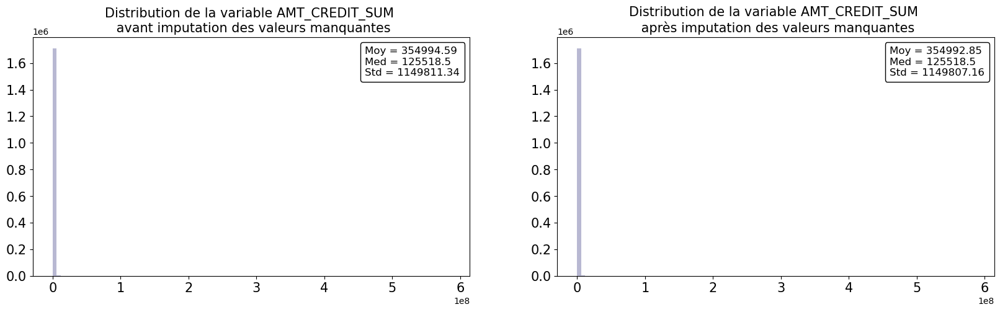

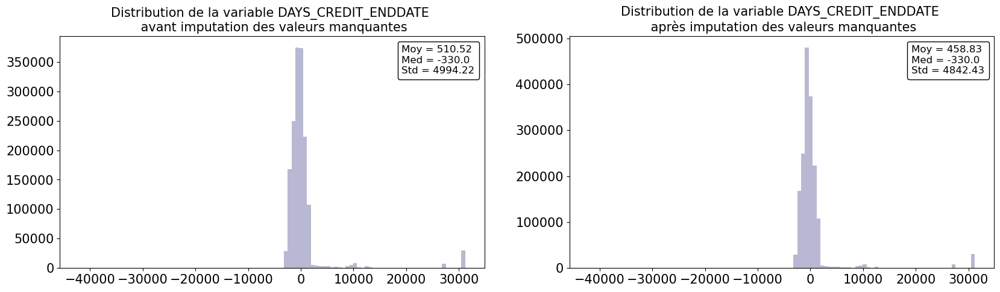

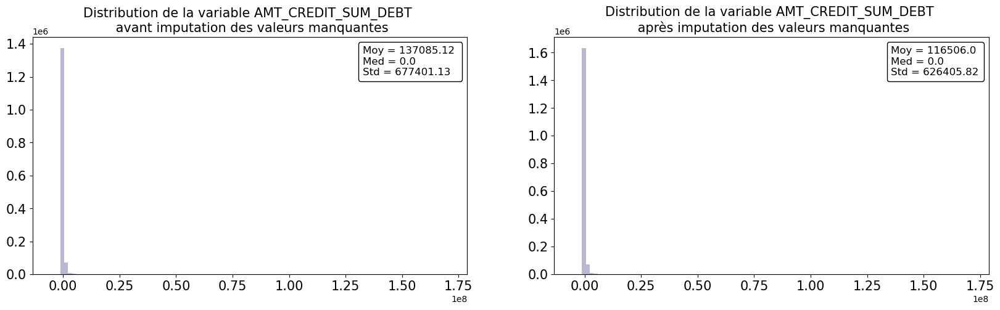

In [74]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(bureau_bb_nan, var, bureau_bb_med)

Les distributions de nos variables avant et après imputation des valeurs manquantes par la médiane sont relativement similaires, nous validons cette méthode.

#### Analyses univariées

In [75]:
bureau_bb_desc = bureau_bb_med.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [76]:
liste_col_quanti = bureau_bb_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique()
liste_col_quanti = liste_col_quanti[liste_col_quanti>2].index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [77]:
len(liste_col_quanti)

13

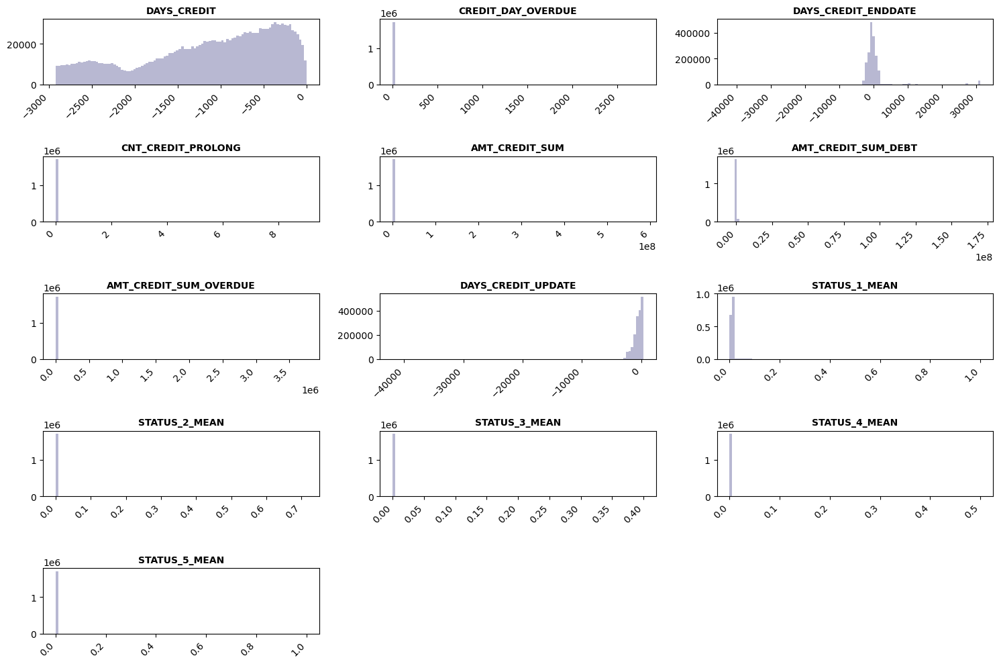

In [78]:
fig = plt.figure(figsize=(15,10))
fct_eda.univariate_plots_hist(bureau_bb_desc, liste_col_quanti, 5, 3, 100, fig=fig)

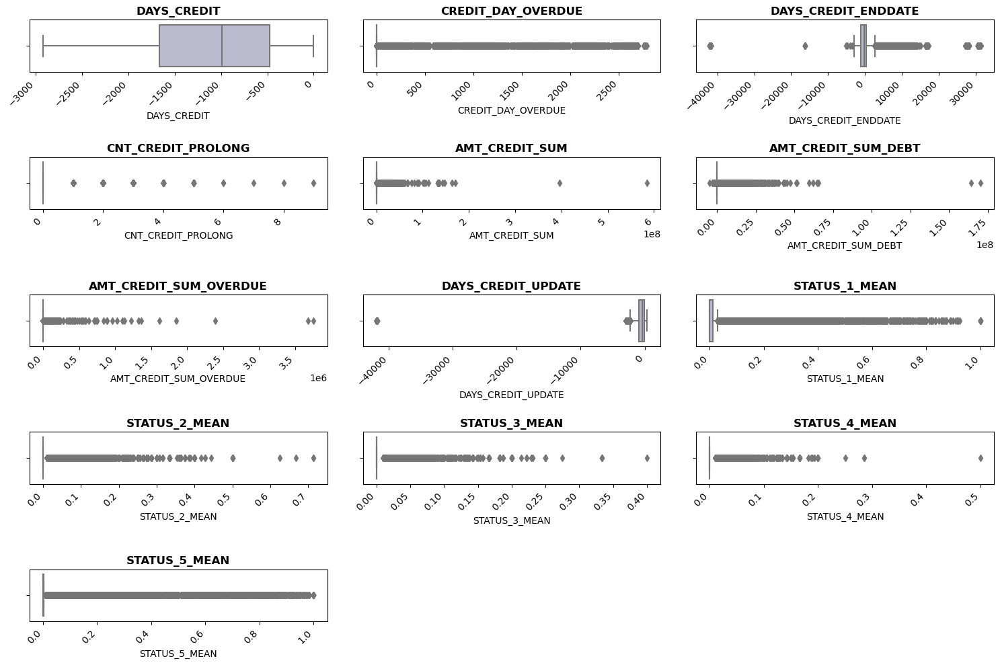

In [79]:
fig = plt.figure(figsize=(15,10))
fct_eda.univariate_plots_box(bureau_bb_desc, liste_col_quanti, 5, 3, fig, True)

In [80]:
bureau_bb_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
DAYS_CREDIT,1716428.00,-1142.11,795.16,-2922.00,-1666.00,-987.00,-474.00,0.00
CREDIT_DAY_OVERDUE,1716428.00,0.82,36.54,0.00,0.00,0.00,0.00,2792.00
DAYS_CREDIT_ENDDATE,1716428.00,458.83,4842.43,-42060.00,-1074.00,-330.00,389.00,31199.00
CNT_CREDIT_PROLONG,1716428.00,0.01,0.10,0.00,0.00,0.00,0.00,9.00
AMT_CREDIT_SUM,1716428.00,354992.85,1149807.16,0.00,51300.00,125518.50,315000.00,585000000.00
AMT_CREDIT_SUM_DEBT,1716428.00,116506.00,626405.82,-4705600.32,0.00,0.00,1975.50,170100000.00
AMT_CREDIT_SUM_OVERDUE,1716428.00,37.91,5937.65,0.00,0.00,0.00,0.00,3756681.00
DAYS_CREDIT_UPDATE,1716428.00,-593.75,720.75,-41947.00,-908.00,-395.00,-33.00,372.00
STATUS_1_MEAN,1716428.00,0.01,0.03,0.00,0.00,0.01,0.01,1.00
STATUS_2_MEAN,1716428.00,0.00,0.01,0.00,0.00,0.00,0.00,0.71


Certaines valeurs semblent être des outliers:

In [81]:
bureau_bb_desc.loc[bureau_bb_desc['DAYS_CREDIT_ENDDATE'] < -20000, 'DAYS_CREDIT_ENDDATE'].count()

134

In [82]:
bureau_bb_desc.loc[bureau_bb_desc['DAYS_CREDIT_UPDATE'] < -20000, 'DAYS_CREDIT_UPDATE'].count()

95

Le nombre de lignes étant faible, nous décidons de les supprimer:

In [83]:
bureau_bb_desc = bureau_bb_desc[~(bureau_bb_desc['DAYS_CREDIT_ENDDATE'] < -20000) & 
                                ~(bureau_bb_desc['DAYS_CREDIT_UPDATE'] < -20000)]

In [84]:
liste_col_quali = bureau_bb_desc.select_dtypes(include ='object').columns
len(liste_col_quali)

3

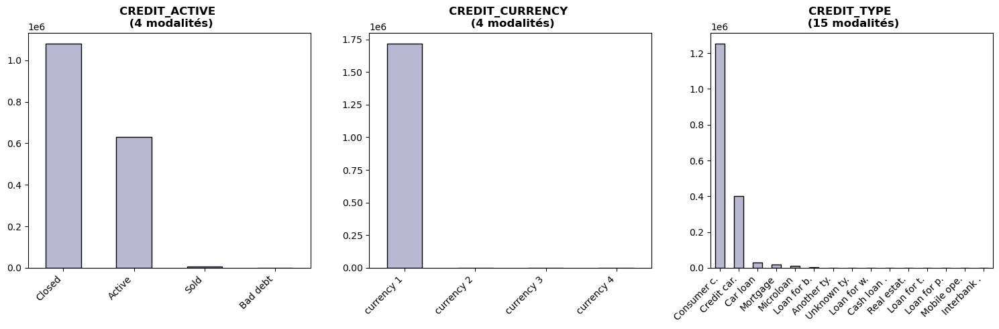

In [85]:
fig = plt.figure(figsize=(15, 5))
fct_eda.categ_distrib_plot(bureau_bb_desc, liste_col_quali, 1, 3, fig = fig)

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [86]:
bureau_bb_desc = bureau_bb_desc.merge(app_train_select.reset_index()[['SK_ID_CURR', 'TARGET']],
                                      on = 'SK_ID_CURR',
                                      how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [87]:
liste_target = ['TARGET']
liste_corr = liste_col_quanti + liste_target

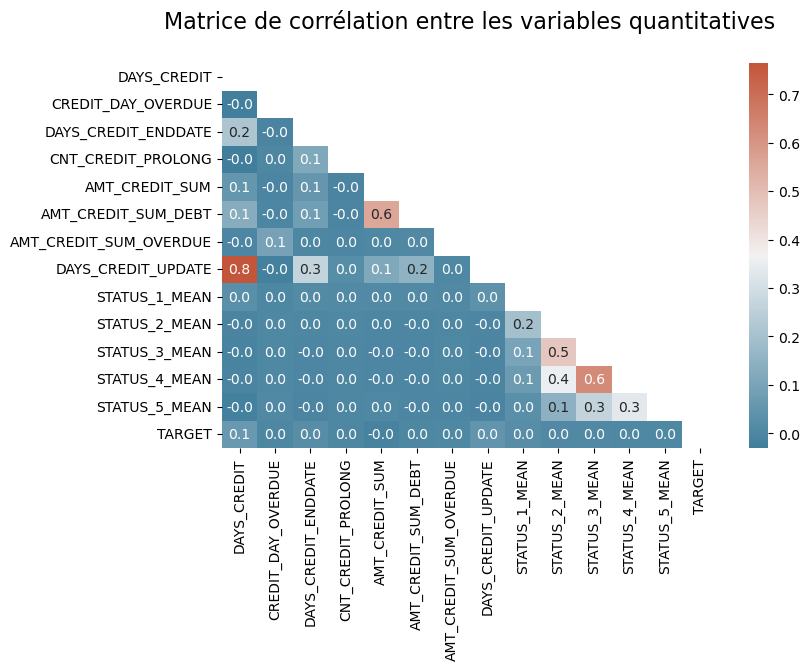

In [88]:
# Corrélation
corr = bureau_bb_desc[liste_corr].corr()

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,5))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation entre les variables quantitatives\n", fontsize=16);

Certaines variables sont très corrélées entre-elles. Nous tâcherons de ne pas les rajouter toutes dans le modèle ou d'en créer de nouvelles à l'aide du feature engineering.

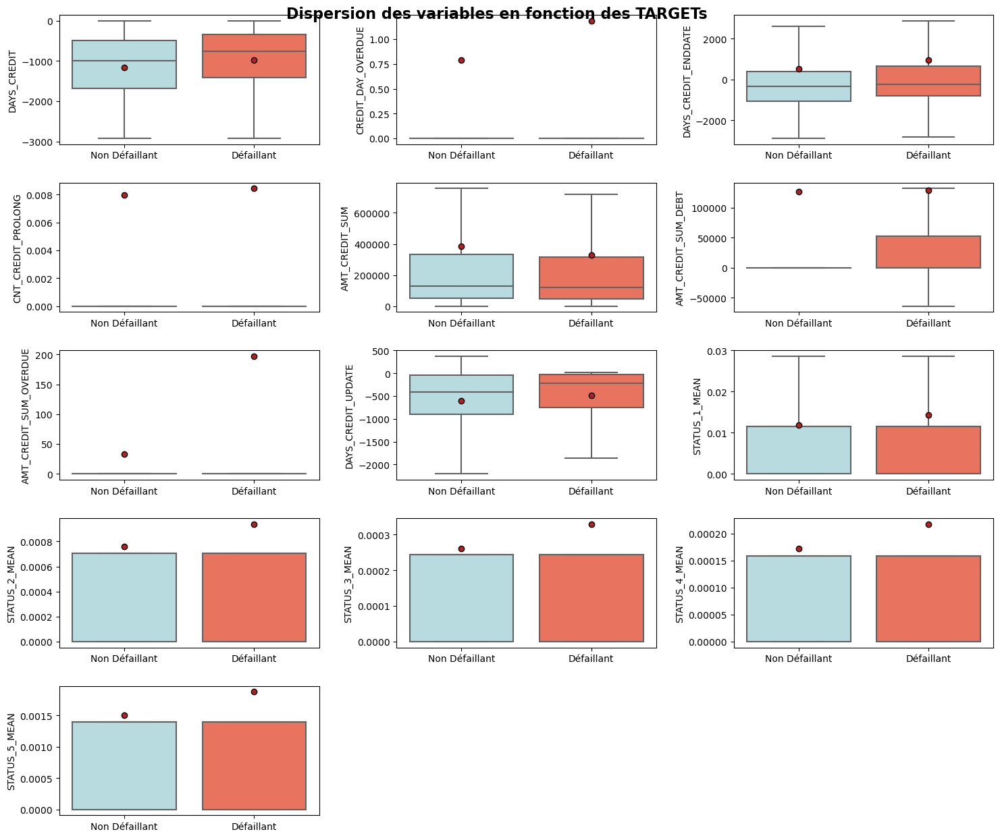

In [89]:
fig = plt.figure(figsize=(15,20))
fct_eda.bivariate_plots_box(bureau_bb_desc, 'TARGET', liste_col_quanti, 8, 3, fig)

Nous n'allons pas conserver la variable DAYS_CREDIT_UPDATE qui est fortement corrélée à la variable DAYS_CREDIT ni la variable AMT_CREDIT_SUM qui est moins représentative que AMT_CREDIT_SUM_DEBT, ni la variable STATUS_3_MEAN fortement corrélée à la variable STATUS_4_MEAN.

In [90]:
del bureau_bb_desc['DAYS_CREDIT_UPDATE']
del bureau_bb_desc['AMT_CREDIT_SUM']
del bureau_bb_desc['STATUS_3_MEAN']

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

CREDIT_ACTIVE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


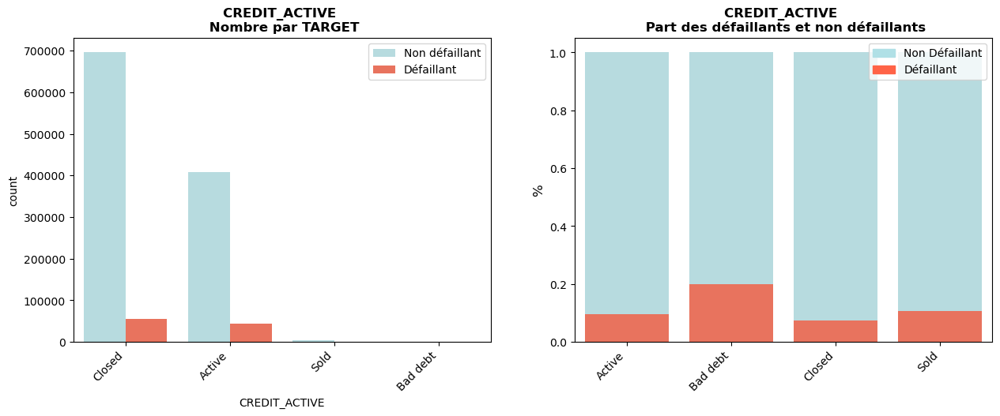

CREDIT_CURRENCY vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0004712856345379407 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


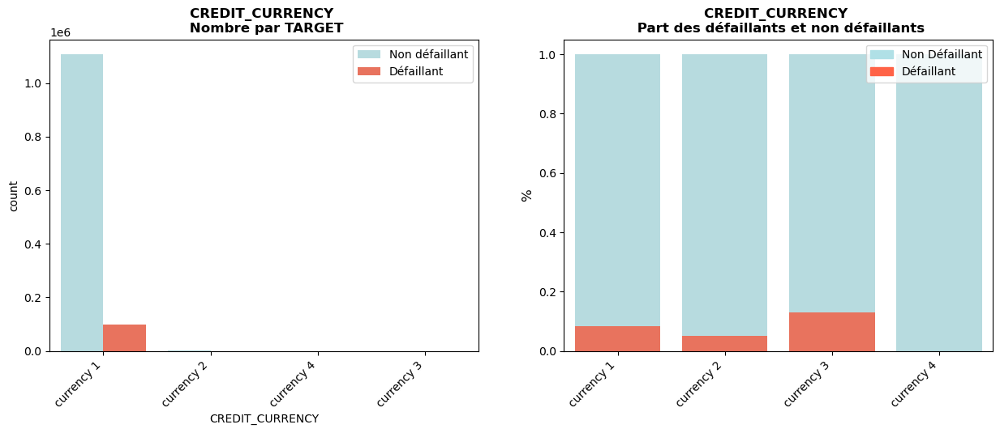

CREDIT_TYPE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


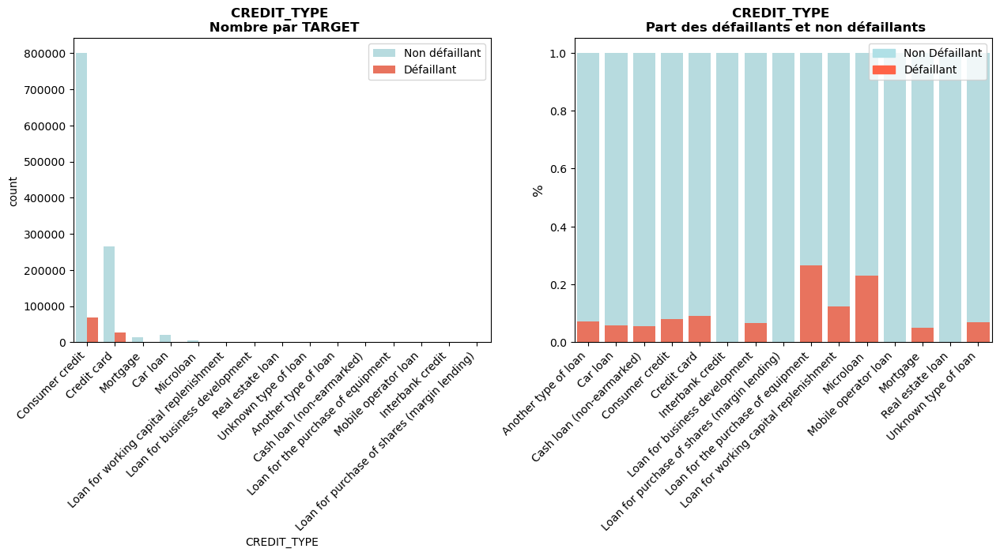

In [91]:
for var in liste_col_quali:
    fct_eda.bivariate_barplots_categ(bureau_bb_desc, var, 'TARGET')

L'association des variables qualitatives avec la target ayant été testée via Chi2, nous garderons pour le moment toutes les variables qualitatives.

In [92]:
# Suppression de la variable TARGET
del bureau_bb_desc['TARGET']

#### Feature engineering

Nous allons encoder nos variables catégorielles à l'aide du **One Hot Encoder (modalités > 2)** pour qu'elles puissent être traitées ensuite dans notre modèle de ML.

In [93]:
bureau_bb_feat, bureau_bb_feat_cat = fct_eda.categories_encoder(bureau_bb_desc, nan_as_category = False)
bureau_bb_feat.head()

,SK_ID_CURR,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_OVERDUE,STATUS_1_MEAN,STATUS_2_MEAN,STATUS_4_MEAN,STATUS_5_MEAN,CREDIT_ACTIVE_Active,CREDIT_ACTIVE_Bad debt,CREDIT_ACTIVE_Closed,CREDIT_ACTIVE_Sold,CREDIT_CURRENCY_currency 1,CREDIT_CURRENCY_currency 2,CREDIT_CURRENCY_currency 3,CREDIT_CURRENCY_currency 4,CREDIT_TYPE_Another type of loan,CREDIT_TYPE_Car loan,CREDIT_TYPE_Cash loan (non-earmarked),CREDIT_TYPE_Consumer credit,CREDIT_TYPE_Credit card,CREDIT_TYPE_Interbank credit,CREDIT_TYPE_Loan for business development,CREDIT_TYPE_Loan for purchase of shares (margin lending),CREDIT_TYPE_Loan for the purchase of equipment,CREDIT_TYPE_Loan for working capital replenishment,CREDIT_TYPE_Microloan,CREDIT_TYPE_Mobile operator loan,CREDIT_TYPE_Mortgage,CREDIT_TYPE_Real estate loan,CREDIT_TYPE_Unknown type of loan
0,215354,-497,0,-153.00,0,0.00,0.00,0.01,0.00,0.00,0.00,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,215354,-208,0,1075.00,0,171342.00,0.00,0.01,0.00,0.00,0.00,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
2,215354,-203,0,528.00,0,0.00,0.00,0.01,0.00,0.00,0.00,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,215354,-203,0,-330.00,0,0.00,0.00,0.01,0.00,0.00,0.00,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
4,215354,-629,0,1197.00,0,0.00,0.00,0.01,0.00,0.00,0.00,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0


Puisque nous avons **plusieurs lignes pour un même prêt de notre échantillon** correspondant au nombre de crédit que le client a eu à Crédit Bureau, nous allons regrouper notre table par SK_ID_CURR et agréger nos données:

In [94]:
# Actualisation de la liste des variables catégorielles de bureau_balance
bureau_balance_cat.remove('STATUS_3')
bureau_balance_cat.remove('STATUS_0')
bureau_balance_cat.remove('STATUS_C')
bureau_balance_cat.remove('STATUS_X')
bureau_balance_cat

['STATUS_1', 'STATUS_2', 'STATUS_4', 'STATUS_5']

In [95]:
# Dictionnaire des agrégations
num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
}


cat_aggregations = {}

for cat in bureau_bb_feat_cat:
    cat_aggregations[cat] = ['mean']
    
for cat in bureau_balance_cat:
    cat_aggregations[cat + "_MEAN"] = ['mean']

In [96]:
# Groupe par SK_ID_CURR avec application du dictionnaire des agrégations
bureau_bb_feat_gby = bureau_bb_feat.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
bureau_bb_feat_gby

DAYS_CREDIT                CREDIT_DAY_OVERDUE      DAYS_CREDIT_ENDDATE                   CNT_CREDIT_PROLONG AMT_CREDIT_SUM_DEBT                      AMT_CREDIT_SUM_OVERDUE CREDIT_ACTIVE_Active CREDIT_ACTIVE_Bad debt CREDIT_ACTIVE_Closed CREDIT_ACTIVE_Sold CREDIT_CURRENCY_currency 1  \
                   min   max     mean                max mean                 min      max     mean                sum                 max      mean        sum                   mean                 mean                   mean                 mean               mean                       mean   
SK_ID_CURR                                                                                                                                                                                                                                                                                              
100001           -1572   -49  -735.00                  0 0.00            -1329.00  1778.00    82.43                  0           373239.00  85240.93  596686.50                   0.00                 0.43                   0.00                 0.57               0.00                       1.00   
100002           -1437  -103  -874.00                  0 0.00            -1072.00   780.00  -344.25                  0           245781.00  30722.62  245781.00                   0.00                 0.25                   0.00                 0.75               0.00                       1.00   
100003           -2586  -606 -1400.75                  0 0.00            -2434.00  1216.00  -544.50                  0                0.00      0.00       0.00                   0.00                 0.25                   0.00                 0.75               0.00                       1.00   
100004           -1326  -408  -867.00                  0 0.00             -595.00  -382.00  -488.50                  0                0.00      0.00       0.00                   0.00                 0.00                   0.00                 1.00               0.00                       1.00   
100005            -373   -62  -190.67                  0 0.00             -128.00  1324.00   439.33                  0           543087.00 189469.50  568408.50                   0.00                 0.67                   0.00                 0.33               0.00                       1.00   
...                ...   ...      ...                ...  ...                 ...      ...      ...                ...                 ...       ...        ...                    ...                  ...                    ...                  ...                ...                        ...   
456249           -2713  -483 -1667.08                  0 0.00            -2499.00  1363.00 -1162.92                  0           163071.00  12543.92  163071.00                   0.00                 0.15                   0.00                 0.85               0.00                       1.00   
456250           -1002  -760  -862.00                  0 0.00             -272.00  2340.00  1288.33                  0          1840308.48 744013.36 2232040.09                   0.00                 0.67                   0.00                 0.33               0.00                       1.00   
456253            -919  -713  -867.50                  0 0.00             -189.00  1113.00   280.50                  0          1624797.00 448958.25 1795833.00                   0.00                 0.50                   0.00                 0.50               0.00                       1.00   
456254           -1104 -1104 -1104.00                  0 0.00             -859.00  -859.00  -859.00                  0                0.00      0.00       0.00                   0.00                 0.00                   0.00                 1.00               0.00                       1.00   
456255           -2337  -363 -1089.45                  0 0.00            -1243.00 27320.00  3231.27                  1           595102.50 139537.55 1

In [97]:
# Renommage des colonnes pour éviter les niveaux multiples
bureau_bb_feat_gby.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_bb_feat_gby.columns.tolist()])
bureau_bb_feat_gby

,BURO_DAYS_CREDIT_MIN,BURO_DAYS_CREDIT_MAX,BURO_DAYS_CREDIT_MEAN,BURO_CREDIT_DAY_OVERDUE_MAX,BURO_CREDIT_DAY_OVERDUE_MEAN,BURO_DAYS_CREDIT_ENDDATE_MIN,BURO_DAYS_CREDIT_ENDDATE_MAX,BURO_DAYS_CREDIT_ENDDATE_MEAN,BURO_CNT_CREDIT_PROLONG_SUM,BURO_AMT_CREDIT_SUM_DEBT_MAX,BURO_AMT_CREDIT_SUM_DEBT_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,BURO_AMT_CREDIT_SUM_OVERDUE_MEAN,BURO_CREDIT_ACTIVE_Active_MEAN,BURO_CREDIT_ACTIVE_Bad debt_MEAN,BURO_CREDIT_ACTIVE_Closed_MEAN,BURO_CREDIT_ACTIVE_Sold_MEAN,BURO_CREDIT_CURRENCY_currency 1_MEAN,BURO_CREDIT_CURRENCY_currency 2_MEAN,BURO_CREDIT_CURRENCY_currency 3_MEAN,BURO_CREDIT_CURRENCY_currency 4_MEAN,BURO_CREDIT_TYPE_Another type of loan_MEAN,BURO_CREDIT_TYPE_Car loan_MEAN,BURO_CREDIT_TYPE_Cash loan (non-earmarked)_MEAN,BURO_CREDIT_TYPE_Consumer credit_MEAN,BURO_CREDIT_TYPE_Credit card_MEAN,BURO_CREDIT_TYPE_Interbank credit_MEAN,BURO_CREDIT_TYPE_Loan for business development_MEAN,BURO_CREDIT_TYPE_Loan for purchase of shares (margin lending)_MEAN,BURO_CREDIT_TYPE_Loan for the purchase of equipment_MEAN,BURO_CREDIT_TYPE_Loan for working capital replenishment_MEAN,BURO_CREDIT_TYPE_Microloan_MEAN,BURO_CREDIT_TYPE_Mobile operator loan_MEAN,BURO_CREDIT_TYPE_Mortgage_MEAN,BURO_CREDIT_TYPE_Real estate loan_MEAN,BURO_CREDIT_TYPE_Unknown type of loan_MEAN,BURO_STATUS_1_MEAN_MEAN,BURO_STATUS_2_MEAN_MEAN,BURO_STATUS_4_MEAN_MEAN,BURO_STATUS_5_MEAN_MEAN
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100001,-1572,-49,-735.00,0,0.00,-1329.00,1778.00,82.43,0,373239.00,85240.93,596686.50,0.00,0.43,0.00,0.57,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00
100002,-1437,-103,-874.00,0,0.00,-1072.00,780.00,-344.25,0,245781.00,30722.62,245781.00,0.00,0.25,0.00,0.75,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.50,0.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.26,0.00,0.00,0.00
100003,-2586,-606,-1400.75,0,0.00,-2434.00,1216.00,-544.50,0,0.00,0.00,0.00,0.00,0.25,0.00,0.75,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.50,0.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00
100004,-1326,-408,-867.00,0,0.00,-595.00,-382.00,-488.50,0,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00
100005,-373,-62,-190.67,0,0.00,-128.00,1324.00,439.33,0,543087.00,189469.50,568408.50,0.00,0.67,0.00,0.33,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.67,0.33,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456249,-2713,-483,-1667.08,0,0.00,-2499.00,1363.00,-1162.92,0,163071.00,12543.92,163071.00,0.00,0.15,0.00,0.85,0.00,1.00,0.00,0.00,0.00,0.08,0.00,0.00,0.69,0.23,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00
456250,-1002,-760,-862.00,0,0.00,-272.00,2340.00,1288.33,0,1840308.48,744013.36,2232040.09,0.00,0.67,0.00,0.33,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.67,0.33,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
456253,-919,-713,-867.50,0,0.00,-189.00,1113.00,280.50,0,1624797.00,448958.25,1795833.00,0.00,0.50,0.00,0.50,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.75,0.25,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


Afin d'avoir également des indicateurs spécifiques aux **crédits actifs et fermés**, nous allons filtrer nos données, appliquer nos agrégations puis joindre ces indicateurs à notre table:

In [98]:
# Indicateurs agrégés crédits actifs
cred_actifs = bureau_bb_feat[bureau_bb_feat['CREDIT_ACTIVE_Active'] == 1]
cred_actifs_agg = cred_actifs.groupby('SK_ID_CURR').agg(num_aggregations)
cred_actifs_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in cred_actifs_agg.columns.tolist()])
bureau_agg = bureau_bb_feat_gby.join(cred_actifs_agg, how = 'left', on = 'SK_ID_CURR')

In [99]:
# Indicateurs agrégés crédits fermés
cred_closed = bureau_bb_feat[bureau_bb_feat['CREDIT_ACTIVE_Closed'] == 1]
cred_closed_agg = cred_closed.groupby('SK_ID_CURR').agg(num_aggregations)
cred_closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in cred_closed_agg.columns.tolist()])
bureau_agg = bureau_agg.join(cred_closed_agg, how = 'left', on = 'SK_ID_CURR')

In [100]:
bureau_agg.isna().sum().sort_values(ascending = False)

ACTIVE_AMT_CREDIT_SUM_DEBT_MEAN                                       53999
ACTIVE_AMT_CREDIT_SUM_OVERDUE_MEAN                                    53999
ACTIVE_DAYS_CREDIT_MIN                                                53999
ACTIVE_DAYS_CREDIT_MAX                                                53999
ACTIVE_DAYS_CREDIT_MEAN                                               53999
ACTIVE_CREDIT_DAY_OVERDUE_MAX                                         53999
ACTIVE_CREDIT_DAY_OVERDUE_MEAN                                        53999
ACTIVE_DAYS_CREDIT_ENDDATE_MIN                                        53999
ACTIVE_DAYS_CREDIT_ENDDATE_MAX                                        53999
ACTIVE_DAYS_CREDIT_ENDDATE_MEAN                                       53999
ACTIVE_CNT_CREDIT_PROLONG_SUM                                         53999
ACTIVE_AMT_CREDIT_SUM_DEBT_MAX                                        53999
ACTIVE_AMT_CREDIT_SUM_DEBT_SUM                                        53999
CLOSED_AMT_C

Les données manquantes générées seront remplacées par la constante 0 en partant du principe qu'un crédit est soit actif, soit fermé et ne peut être les deux.

In [101]:
# Imputation des variables par la constante 0
for col in cred_actifs_agg:
    bureau_agg[col] = bureau_agg[col].fillna(0)
    
for col in cred_closed_agg:
    bureau_agg[col] = bureau_agg[col].fillna(0)

In [102]:
bureau_agg.shape

(305807, 66)

#### Fonction de preprocessing

In [103]:
def preprocess_bureau_balance():
    '''Fonction de preprocessing des datasets bureau et bureau_balance:
    merge, traitement des données manquantes, traitement des outliers et des modalités,
    feature engineering
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement des datasets
    bureau = pd.read_csv('data/bureau.csv', sep = ',', encoding='utf-8')
    bureau_balance = pd.read_csv('data/bureau_balance.csv', sep=',', encoding='utf-8')
    
    # Preprocessing bureau_balance
    bureau_balance, bureau_balance_cat = fct_eda.categories_encoder(bureau_balance, nan_as_category = False)
        # Dictionnaire des agrégations
    bureau_balance_aggreg = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bureau_balance_cat:
        bureau_balance_aggreg[col] = ['mean']
       # Groupe par SK_ID_BUREAU avec application du dictionnaire des agrégations
    bureau_balance = bureau_balance.groupby('SK_ID_BUREAU').agg(bureau_balance_aggreg)
        # Renommage des colonnes pour éviter les niveaux multiples
    bureau_balance.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bureau_balance.columns.tolist()])
        # Fusion de bureau et bureau balance et suppression de la variable SK_ID_BUREAU
    bureau_bb = bureau.join(bureau_balance, how='left', on='SK_ID_BUREAU')
    bureau_bb.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    
    # Traitement des données manquantes
        # Moyenne pour les variables STATUS
    for col in bureau_bb.columns[bureau_bb.columns.str.contains('STATUS')]:
        bureau_bb[col] = bureau_bb[col].fillna(bureau_bb[col].mean())
    del bureau_bb['STATUS_X_MEAN']
    del bureau_bb['STATUS_C_MEAN']
    del bureau_bb['STATUS_0_MEAN']
        # Suppression des variables avec 30% ou plus de NaN
    bureau_bb_nan = fct_eda.tx_rempl_min(bureau_bb, 70)
        # Médiane pour variables avec taux de remplissage > 70%
    df_nan = fct_eda.nan_a_retraiter(bureau_bb)
    col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                 (df_nan['dtypes'] == 'float64')].index.tolist()
    for col in col_med:
        bureau_bb[col] = bureau_bb[col].fillna(bureau_bb[col].median())

    # Traitement des outliers
    bureau_bb = bureau_bb[~(bureau_bb['DAYS_CREDIT_ENDDATE'] < -20000) & 
                          ~(bureau_bb['DAYS_CREDIT_UPDATE'] < -20000)]

    # Suppression de variables
    del bureau_bb['DAYS_CREDIT_UPDATE']
    del bureau_bb['AMT_CREDIT_SUM']
    del bureau_bb['STATUS_3_MEAN']   

    # Feature engineering
    bureau_bb_feat, bureau_bb_feat_cat = fct_eda.categories_encoder(bureau_bb, nan_as_category = False)
        # Actualisation de la liste des variables catégorielles de bureau_balance
    bureau_balance_cat.remove('STATUS_3')
    bureau_balance_cat.remove('STATUS_0')
    bureau_balance_cat.remove('STATUS_C')
    bureau_balance_cat.remove('STATUS_X')
        # Dictionnaire des agrégations
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
    }
    cat_aggregations = {}
    for cat in bureau_bb_feat_cat:
        cat_aggregations[cat] = ['mean']
    for cat in bureau_balance_cat:
        cat_aggregations[cat + "_MEAN"] = ['mean']
        # Groupe par SK_ID_CURR avec application du dictionnaire des agrégations
    bureau_bb_feat_gby = bureau_bb_feat.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
        # Renommage des colonnes pour éviter les niveaux multiples
    bureau_bb_feat_gby.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() 
                                           for e in bureau_bb_feat_gby.columns.tolist()])
        # Indicateurs agrégés crédits actifs
    cred_actifs = bureau_bb_feat[bureau_bb_feat['CREDIT_ACTIVE_Active'] == 1]
    cred_actifs_agg = cred_actifs.groupby('SK_ID_CURR').agg(num_aggregations)
    cred_actifs_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() 
                                        for e in cred_actifs_agg.columns.tolist()])
    bureau_agg = bureau_bb_feat_gby.join(cred_actifs_agg, how = 'left', on = 'SK_ID_CURR')
        # Indicateurs agrégés crédits fermés
    cred_closed = bureau_bb_feat[bureau_bb_feat['CREDIT_ACTIVE_Closed'] == 1]
    cred_closed_agg = cred_closed.groupby('SK_ID_CURR').agg(num_aggregations)
    cred_closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() 
                                        for e in cred_closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(cred_closed_agg, how = 'left', on = 'SK_ID_CURR')
        # Imputation des variables par la constante 0
    for col in cred_actifs_agg:
        bureau_agg[col] = bureau_agg[col].fillna(0)
    for col in cred_closed_agg:
        bureau_agg[col] = bureau_agg[col].fillna(0)
    
    del bureau, bureau_balance, bureau_bb, bureau_bb_feat, bureau_bb_feat_gby, cred_actifs_agg, cred_closed_agg
    
    gc.collect()
    
    return bureau_agg

In [104]:
preprocess_bureau_balance().shape

(305807, 66)

### previous_application.csv <a class="anchor" id="previous"></a>

#### Principales statistiques

Cette table contient toutes les **anciennes demandes de prêt** à Prêt à Dépenser des clients que nous avons dans notre échantillon.

In [105]:
# Chargement du dataset
previous_app = pd.read_csv('data/previous_application.csv',
                           sep=',',
                           encoding='utf-8')

In [106]:
# Description des colonnes
col_desc[col_desc['Table'] == 'previous_application.csv']

,Unnamed: 0,Table,Row,Description,Special
173,176,previous_application.csv,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loan applications in Home Credit, previous application could, but not necessarily have to lead to credit)",hashed
174,177,previous_application.csv,SK_ID_CURR,ID of loan in our sample,hashed
175,178,previous_application.csv,NAME_CONTRACT_TYPE,"Contract product type (Cash loan, consumer loan [POS] ,...) of the previous application",NaN
176,179,previous_application.csv,AMT_ANNUITY,Annuity of previous application,NaN
177,180,previous_application.csv,AMT_APPLICATION,For how much credit did client ask on the previous application,NaN
178,181,previous_application.csv,AMT_CREDIT,"Final credit amount on the previous application. This differs from AMT_APPLICATION in a way that the AMT_APPLICATION is the amount for which the client initially applied for, but during our approval process he could have received different amount - AMT_CREDIT",NaN
179,182,previous_application.csv,AMT_DOWN_PAYMENT,Down payment on the previous application,NaN
180,183,previous_application.csv,AMT_GOODS_PRICE,Goods price of good that client asked for (if applicable) on the previous application,NaN
181,184,previous_application.csv,WEEKDAY_APPR_PROCESS_START,On which day of the week did the client apply for previous application,NaN
182,185,previous_application.csv,HOUR_APPR_PROCESS_START,Approximately at what day hour did the client apply for the previous application,rounded


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.43,17145.00,17145.00,0.00,17145.00,SATURDAY,15,Y,1,0.00,0.18,0.87,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.00,middle,POS mobile with interest,365243.00,-42.00,300.00,-42.00,-37.00,0.00
1,2802425,108129,Cash loans,25188.62,607500.00,679671.00,NaN,607500.00,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.00,low_action,Cash X-Sell: low,365243.00,-134.00,916.00,365243.00,365243.00,1.00
2,2523466,122040,Cash loans,15060.74,112500.00,136444.50,NaN,112500.00,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,high,Cash X-Sell: high,365243.00,-271.00,59.00,365243.00,365243.00,1.00
3,2819243,176158,Cash loans,47041.33,450000.00,470790.00,NaN,450000.00,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,middle,Cash X-Sell: middle,365243.00,-482.00,-152.00,-182.00,-177.00,1.00
4,1784265,202054,Cash loans,31924.40,337500.00,404055.00,NaN,337500.00,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.00,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
1670209,2300464,352015,Consumer loans,14704.29,267295.50,311400.00,0.00,267295.50,WEDNESDAY,12,Y,1,0.00,NaN,NaN,XAP,Approved,-544,Cash through the bank,XAP,NaN,Refreshed,Furniture,POS,XNA,Stone,43,Furniture,30.00,low_normal,POS industry with interest,365243.00,-508.00,362.00,-358.00,-351.00,0.00
1670210,2357031,334635,Consumer loans,6622.02,87750.00,64291.50,29250.00,87750.00,TUESDAY,15,Y,1,0.34,NaN,NaN,XAP,Approved,-1694,Cash through the bank,XAP,Unaccompanied,New,Furniture,POS,XNA,Stone,43,Furniture,12.00,middle,POS industry with interest,365243.00,-1604.00,-1274.00,-1304.00,-1297.00,0.00
1670211,2659632,249544,Consumer loans,11520.85,105237.00,102523.50,10525.50,105237.00,MONDAY,12,Y,1,0.10,NaN,NaN,XAP,Approved,-1488,Cash through the bank,XAP,"Spouse, partner",Repeater,Consumer Electronics,POS,XNA,Country-wide,1370,Consumer electronics,10.00,low_normal,POS household with interest,365243.00,-1457.00,-1187.00,-1187.00,-1181.00,0.00
1670212,2785582,400317,Cash loans,18821.52,180000.00,191880.00,NaN,180000.00,WEDNESDAY,9,Y,1,NaN,NaN,NaN,XNA,Approved,-1185,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),-1,XNA,12.00,low_normal,Cash X-Sell: low,365243.00,-1155.00,-825.00,-825.00,-817.00,1.00
1670213,2418762,261212,Cash loans,16431.30,360000.00,360000.00,NaN,360000.00,SUNDAY,10,Y,1,NaN,NaN,NaN,XNA,Approved,-1193,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),-1,XNA,48.00,middle,Cash X-Sell: middle,365243.00,-1163.00,247.00,-443.00,-423.00,0.00


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 1670214
Nombre de colonnes: 37
Nombre total de NaN du dataset: 11109336
% total de NaN du dataset: 17.98%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


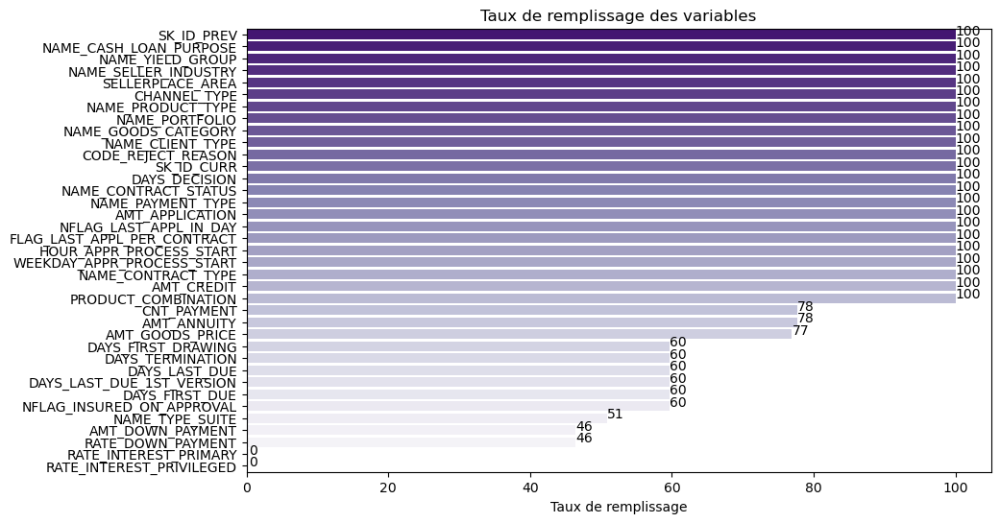

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,2030495,1670214,1670214,100.00,1670214,100.00,0,0.00
1,SK_ID_CURR,int64,271877,1670214,338857,20.29,1670214,100.00,0,0.00
2,NAME_CONTRACT_TYPE,object,Consumer loans,1670214,4,0.00,1670214,100.00,0,0.00
3,AMT_ANNUITY,float64,1730.43,1670214,357959,21.43,1297979,77.71,372235,22.29
4,AMT_APPLICATION,float64,17145.00,1670214,93885,5.62,1670214,100.00,0,0.00
5,AMT_CREDIT,float64,17145.00,1670214,86803,5.20,1670213,100.00,1,0.00
6,AMT_DOWN_PAYMENT,float64,0.00,1670214,29278,1.75,774370,46.36,895844,53.64
7,AMT_GOODS_PRICE,float64,17145.00,1670214,93885,5.62,1284699,76.92,385515,23.08
8,WEEKDAY_APPR_PROCESS_START,object,SATURDAY,1670214,7,0.00,1670214,100.00,0,0.00
9,HOUR_APPR_PROCESS_START,int64,15,1670214,24,0.00,1670214,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [107]:
plt.figure(figsize=(10, 6))
previous_app_desc = fct_eda.describe_stat(previous_app, fig = fig)

#### Traitement des données manquantes

Nous allons imputer les données manquantes de différentes manières:
- **suppression** des variables avec plus de **30% de données manquantes**
- pour les **variables corrélées entre elles** que nous repérerons à l'aide de la matrice de corrélation, nous utiliserons l'algorithme **iterative imputer**
- lorsque le pourcentage de valeurs manquantes est relativement **faible** (<=30%), nous imputerons par la **médiane** pour les variables quantitatives et par le **mode** pour les variables qualitatives

Pour nous assurer que nos méthodes sont cohérentes, nous analyserons les **distributions** avant et après imputations.

<div class="alert alert-block alert-warning">
    <p>Suppression des variables avec 30% ou plus de NaN</p>
</div>

In [108]:
# Suppression des variables avec 30% ou plus de NaN
previous_app_nan = fct_eda.tx_rempl_min(previous_app, 70)
fct_eda.nan_a_retraiter(previous_app_nan)

,Tx_rempl,nb_NaN,dtypes
AMT_CREDIT,100.00,1,float64
PRODUCT_COMBINATION,99.98,346,object
CNT_PAYMENT,77.71,372230,float64
AMT_ANNUITY,77.71,372235,float64
AMT_GOODS_PRICE,76.92,385515,float64


<div class="alert alert-block alert-warning">
    <p>Iterative imputer pour les variables corrélées entre-elles</p>
</div>

In [109]:
# Variables quantitatives
col_quanti_cont = previous_app_nan.select_dtypes(exclude=['object']).columns.tolist()

liste_var_a_tester = fct_eda.pairs_corr(previous_app_nan, col_quanti_cont, seuil = 0.5)

,correlation
pairs,
"(AMT_APPLICATION, AMT_GOODS_PRICE)",1.00
"(AMT_GOODS_PRICE, AMT_CREDIT)",0.99
"(AMT_CREDIT, AMT_APPLICATION)",0.98
"(AMT_GOODS_PRICE, AMT_ANNUITY)",0.82
"(AMT_CREDIT, AMT_ANNUITY)",0.82
"(AMT_APPLICATION, AMT_ANNUITY)",0.81
"(CNT_PAYMENT, AMT_APPLICATION)",0.68
"(CNT_PAYMENT, AMT_CREDIT)",0.67
"(CNT_PAYMENT, AMT_GOODS_PRICE)",0.67


<div class="alert alert-block alert-success">
    <p>A noter: ces pairs de variables étant fortement corrélées, il faudra penser à ne pas les prendre toutes dans notre modèle.</p>
</div>

In [110]:
previous_app_imp = previous_app_nan.copy()

In [111]:
# Affectation des résultats de l'iterative imputer dans les variables concernées
previous_app_imp['AMT_CREDIT'] = fct_eda.iterative_imputer_function(
    previous_app_imp[['AMT_CREDIT', 'AMT_APPLICATION']])[:,0]

#previous_app_imp['CNT_PAYMENT'] = iterative_imputer_function(
#    previous_app_imp[['CNT_PAYMENT', 'AMT_APPLICATION']])[:,0]

previous_app_imp['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
    previous_app_imp[['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
                      'AMT_APPLICATION', 'CNT_PAYMENT']])[:,0]

#previous_app_imp['AMT_GOODS_PRICE'] = iterative_imputer_function(
#    previous_app_imp[['AMT_GOODS_PRICE', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_ANNUITY']])[:,0]

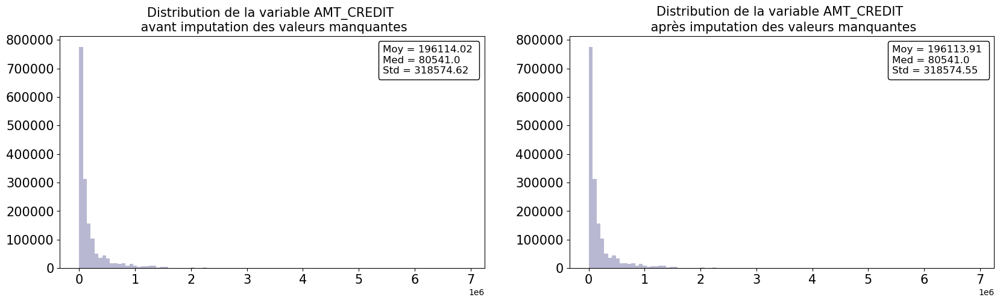

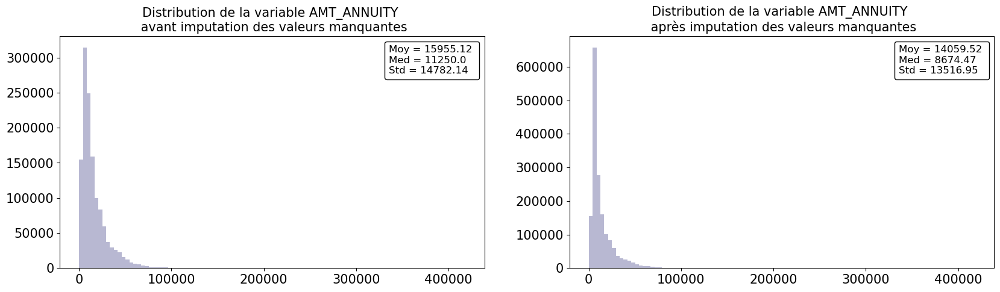

In [112]:
list_var_imp = ['AMT_CREDIT', 'AMT_ANNUITY']

for var in list_var_imp:
    fct_eda.distrib_imput_nan_quanti(previous_app_nan, var, previous_app_imp)

Les distributions de nos variables avant et après imputation des valeurs manquantes par iterative imputer sont relativement similaires, nous validons cette méthode.

<div class="alert alert-block alert-warning">
    <p>Médiane et mode pour variables avec taux de NaN > 70% (hors variable TARGET)</p>
</div>

In [113]:
previous_app_med = previous_app_imp.copy()

In [114]:
df_nan = fct_eda.nan_a_retraiter(previous_app_med)
df_nan

,Tx_rempl,nb_NaN,dtypes
PRODUCT_COMBINATION,99.98,346,object
CNT_PAYMENT,77.71,372230,float64
AMT_GOODS_PRICE,76.92,385515,float64


In [115]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                 (df_nan['dtypes'] == 'float64')].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    previous_app_med[col] = previous_app_med[col].fillna(previous_app_med[col].median())

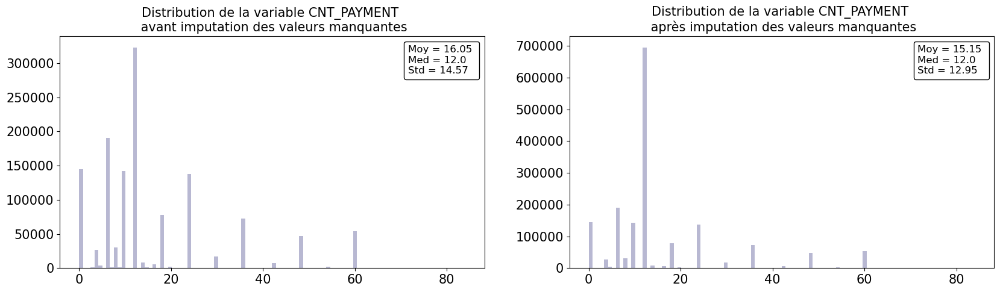

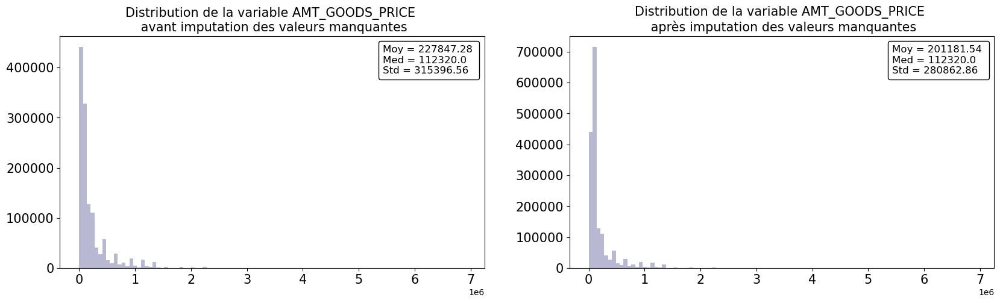

In [116]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(previous_app_imp, var, previous_app_med)

Les distributions de nos variables avant et après imputation des valeurs manquantes par la médiane sont relativement similaires, nous validons cette méthode.

In [117]:
# Imputation de la variable NAME_TYPE_SUITE par le mode
previous_app_med['PRODUCT_COMBINATION'] = previous_app_med['PRODUCT_COMBINATION'].fillna(
    previous_app_med['PRODUCT_COMBINATION'].mode()[0])

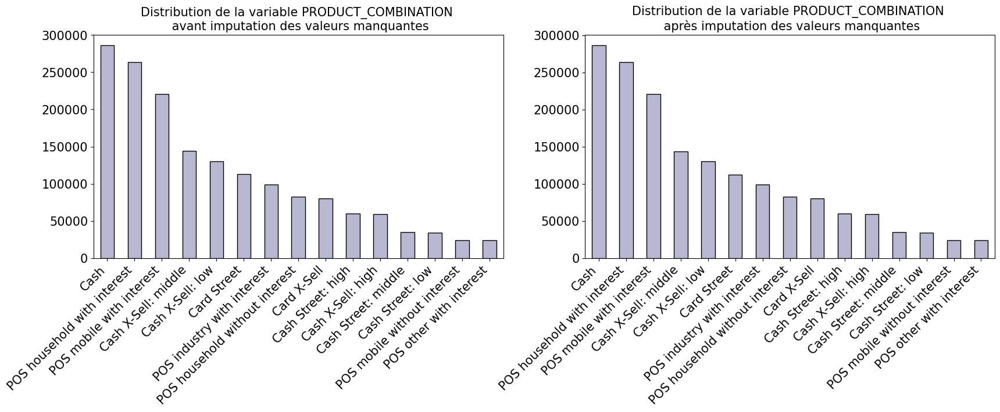

In [118]:
fct_eda.distrib_imput_nan_quali(previous_app_imp, 'PRODUCT_COMBINATION', previous_app_med)

In [119]:
del previous_app, previous_app_desc, previous_app_nan, previous_app_imp

#### Analyses univariées

In [120]:
previous_app_desc = previous_app_med.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [121]:
liste_col_quanti = previous_app_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [122]:
len(liste_col_quanti)

9

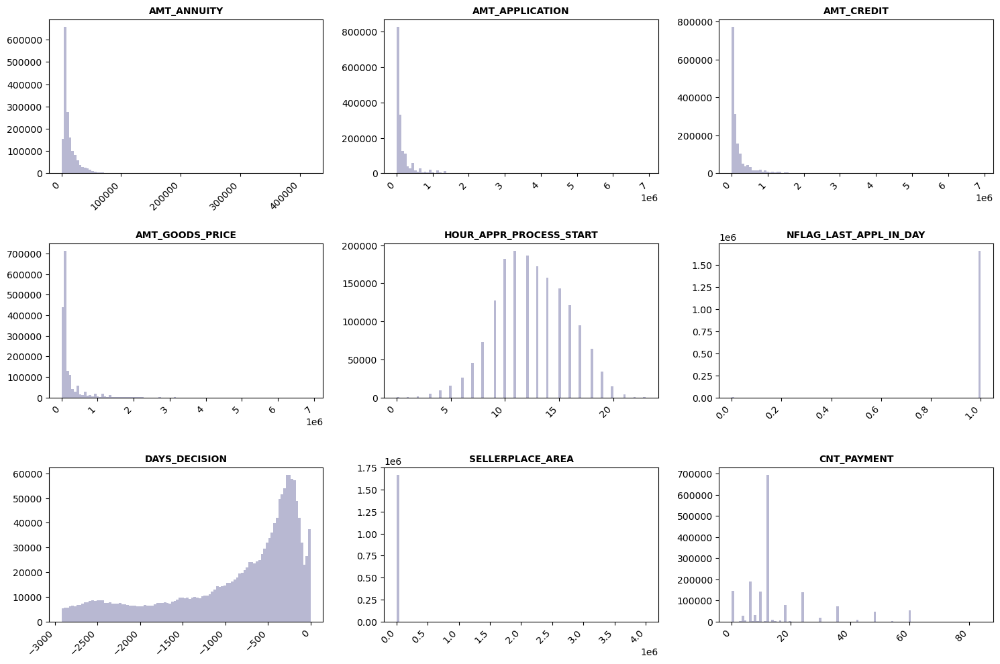

In [123]:
fig = plt.figure(figsize=(15,10))
fct_eda.univariate_plots_hist(previous_app_desc, liste_col_quanti, 3, 3, 100, fig=fig)

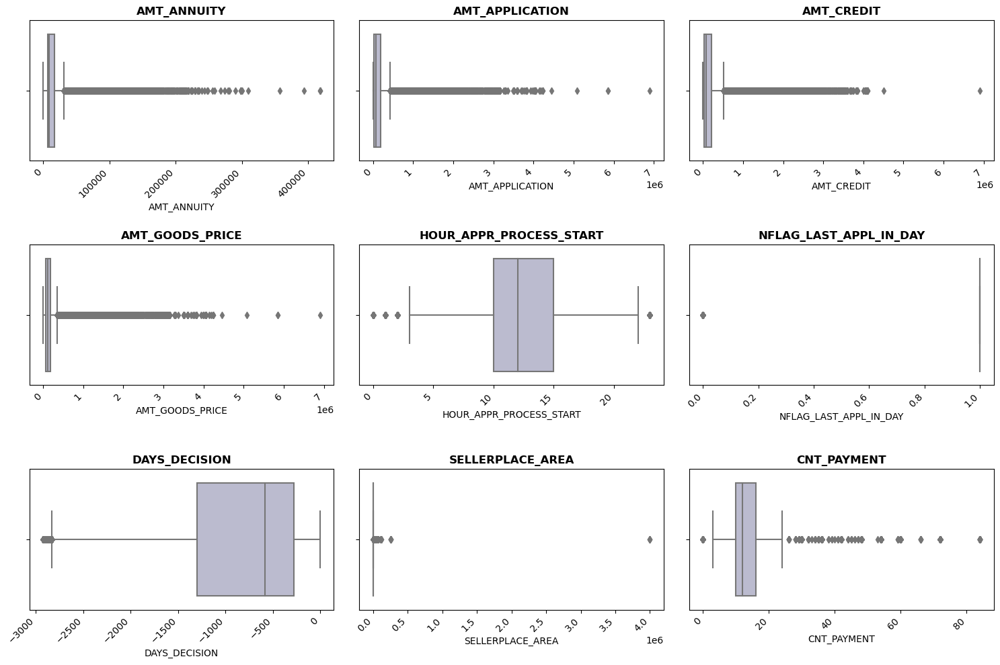

In [124]:
fig = plt.figure(figsize=(15,10))
fct_eda.univariate_plots_box(previous_app_desc, liste_col_quanti, 3, 3, fig, True)

In [125]:
previous_app_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
AMT_ANNUITY,1670214.00,14059.52,13516.95,0.00,7175.99,8674.47,16842.10,418058.15
AMT_APPLICATION,1670214.00,175233.86,292779.76,0.00,18720.00,71046.00,180360.00,6905160.00
AMT_CREDIT,1670214.00,196113.91,318574.55,0.00,24160.50,80541.00,216418.50,6905160.00
AMT_GOODS_PRICE,1670214.00,201181.54,280862.86,0.00,67500.00,112320.00,180405.00,6905160.00
HOUR_APPR_PROCESS_START,1670214.00,12.48,3.33,0.00,10.00,12.00,15.00,23.00
NFLAG_LAST_APPL_IN_DAY,1670214.00,1.00,0.06,0.00,1.00,1.00,1.00,1.00
DAYS_DECISION,1670214.00,-880.68,779.10,-2922.00,-1300.00,-581.00,-280.00,-1.00
SELLERPLACE_AREA,1670214.00,313.95,7127.44,-1.00,-1.00,3.00,82.00,4000000.00
CNT_PAYMENT,1670214.00,15.15,12.95,0.00,10.00,12.00,16.00,84.00


In [126]:
liste_col_quali = previous_app_desc.select_dtypes(include='object').columns

In [127]:
len(liste_col_quali)

15

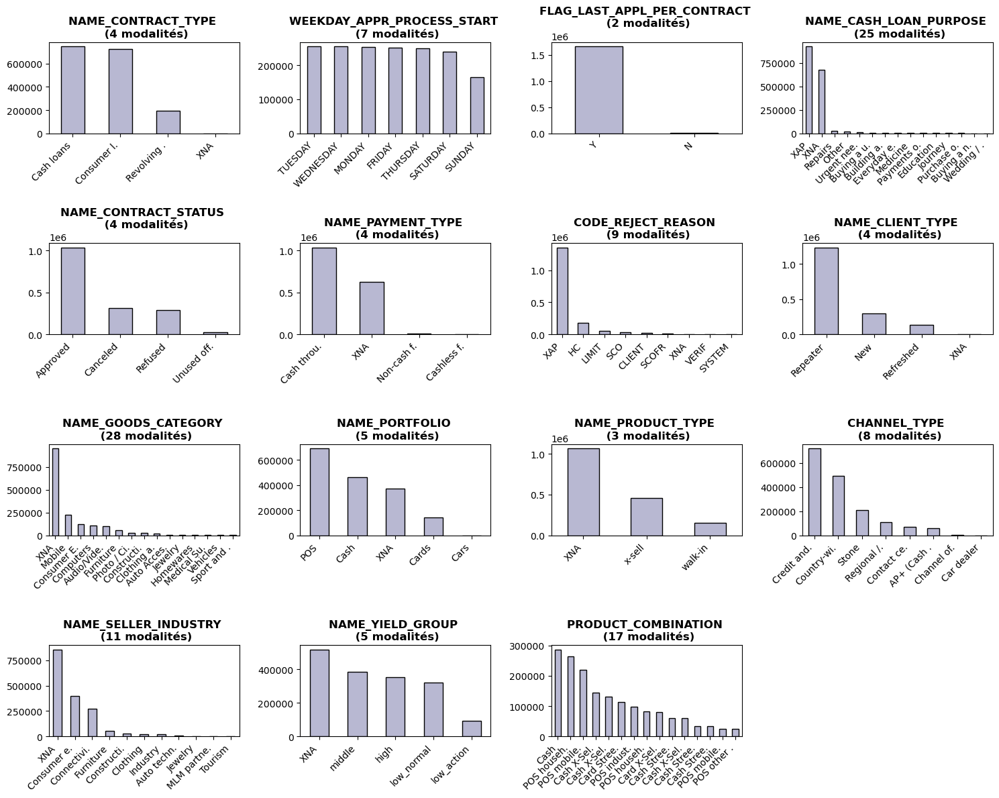

In [128]:
fig = plt.figure(figsize=(15, 12))
fct_eda.categ_distrib_plot(previous_app_desc, liste_col_quali, 4, 4, fig = fig)

La modalité XNA semble représenter les valeurs non affectées. Nous la conservons.

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [129]:
previous_app_desc = previous_app_desc.merge(app_train_select.reset_index()[['SK_ID_CURR', 'TARGET']],
                                            on = 'SK_ID_CURR',
                                            how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [130]:
liste_target = ['TARGET']
liste_corr = liste_col_quanti + liste_target

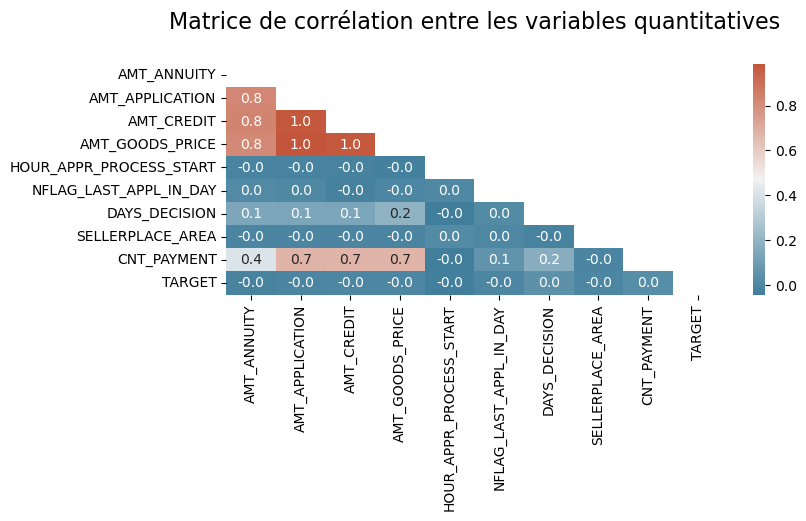

In [131]:
# Corrélation
corr = previous_app_desc[liste_corr].corr()

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,3))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation entre les variables quantitatives\n", fontsize=16);

Certaines variables sont très corrélées entre-elles. Nous tâcherons de ne pas les rajouter toutes dans le modèle ou d'en créer de nouvelles à l'aide du feature engineering.

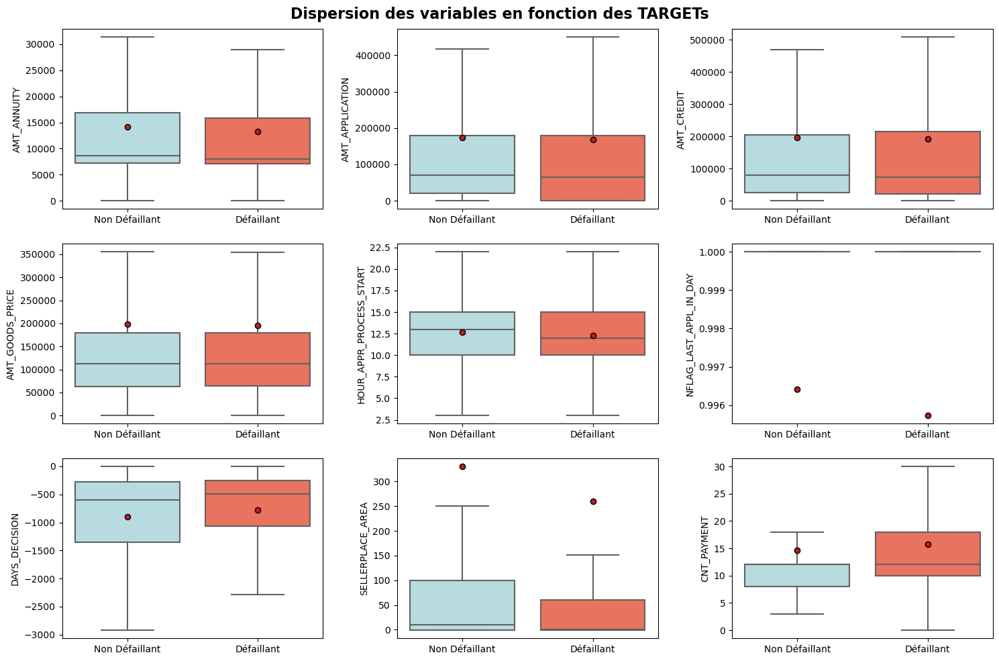

In [132]:
fig = plt.figure(figsize=(15,10))
fct_eda.bivariate_plots_box(previous_app_desc, 'TARGET', liste_col_quanti, 3, 3, fig)

Nous n'allons pas conserver les variables AMOUNT_APPLICATION, AMT_CREDIT, AMT_GOODS_PRICE qui sont fortement corrélées à la variable AMT_ANNUITY mais nous créerons de nouvelles variables dans la partie Feature Engineering.

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

NAME_CONTRACT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


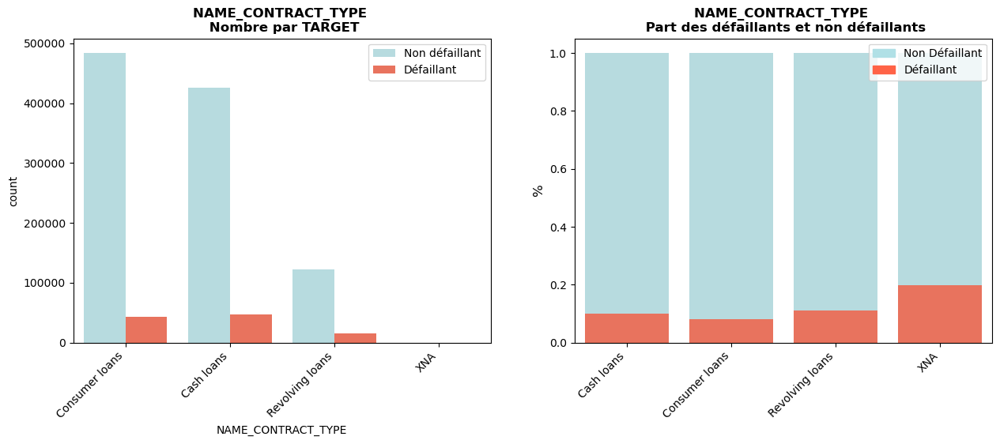

WEEKDAY_APPR_PROCESS_START vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 7.661907558486651e-34 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


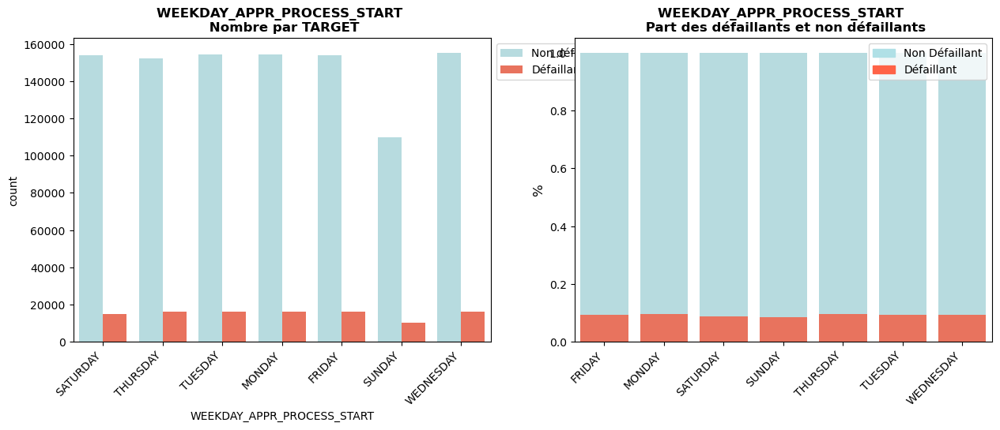

FLAG_LAST_APPL_PER_CONTRACT vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 8.516125957926565e-10 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


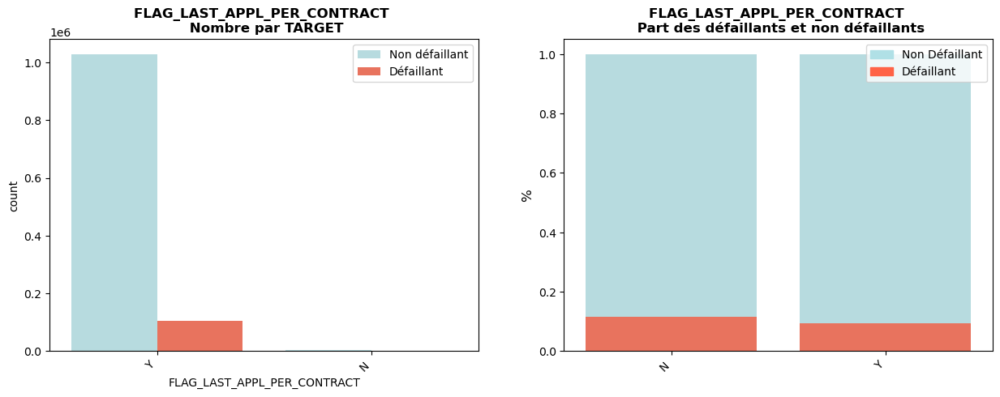

NAME_CASH_LOAN_PURPOSE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


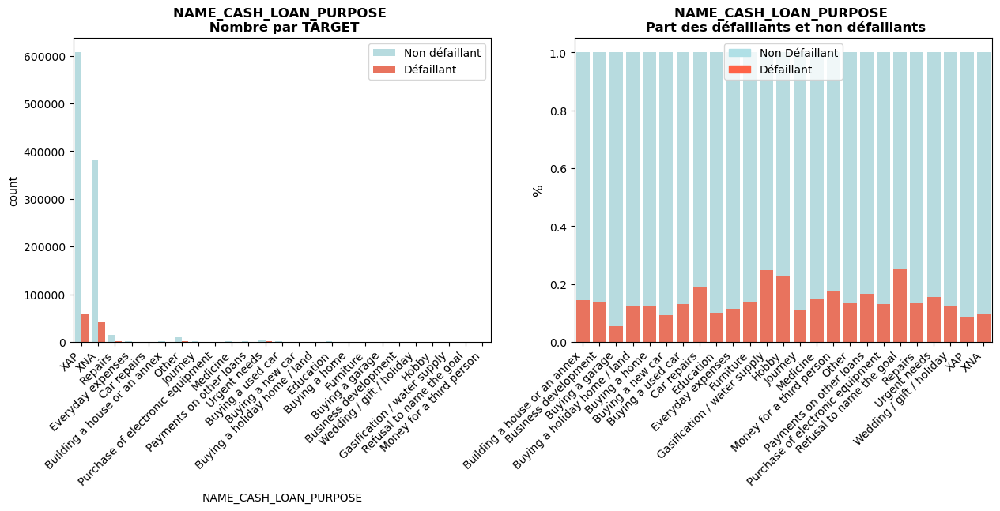

NAME_CONTRACT_STATUS vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


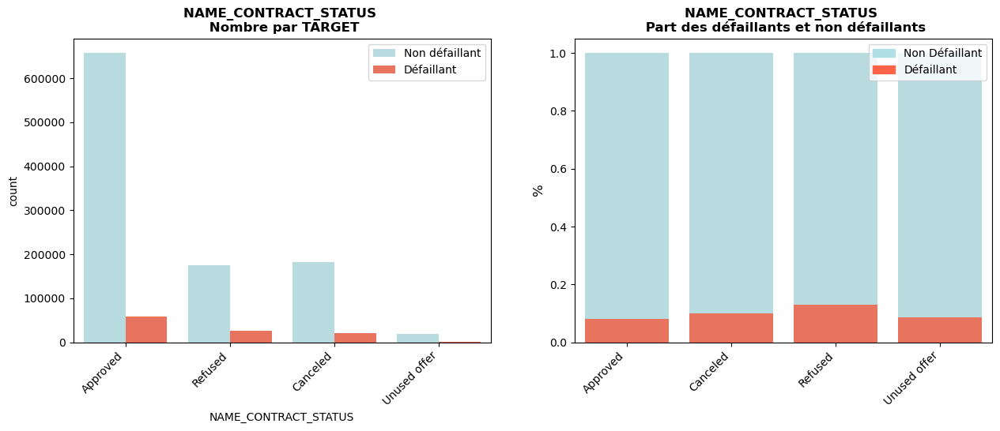

NAME_PAYMENT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 3.4480987921672486e-205 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


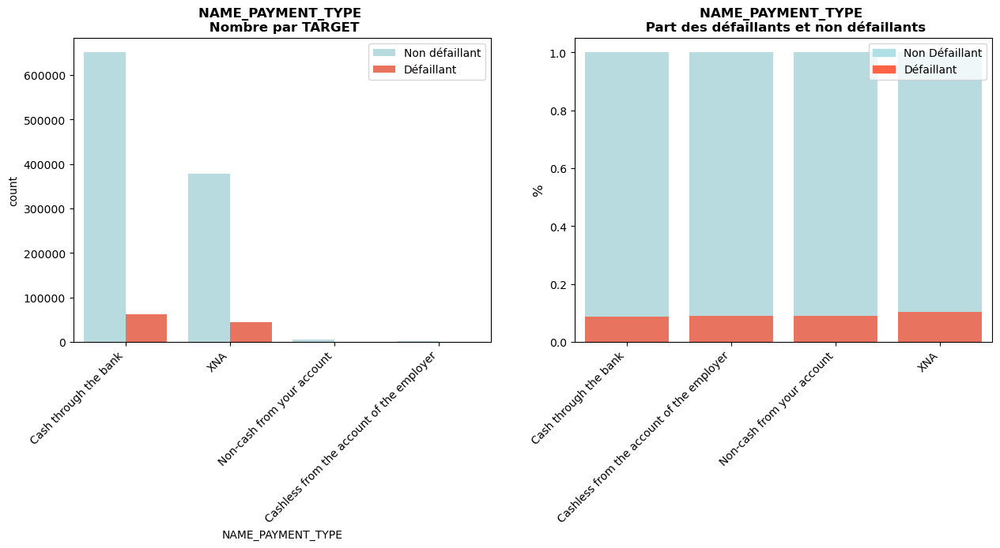

CODE_REJECT_REASON vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


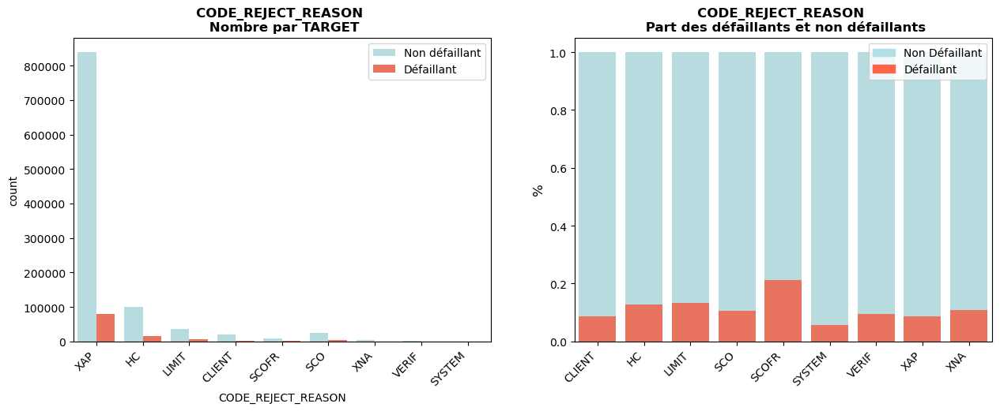

NAME_CLIENT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 5.8622732877373595e-65 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


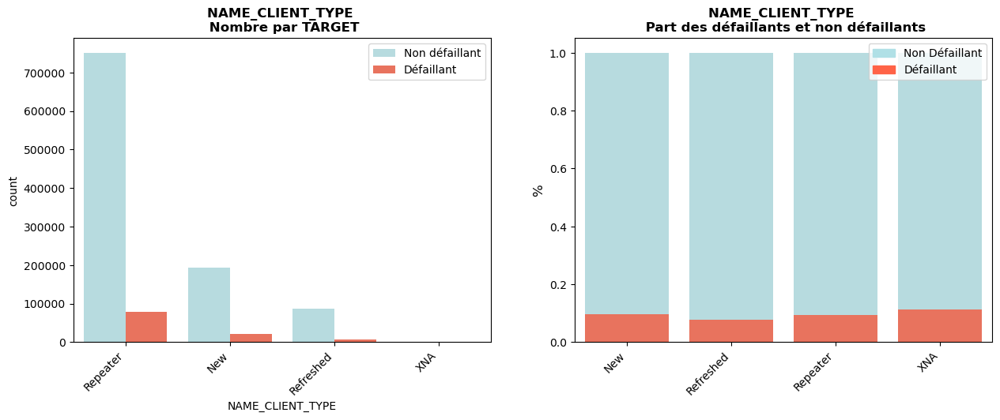

NAME_GOODS_CATEGORY vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


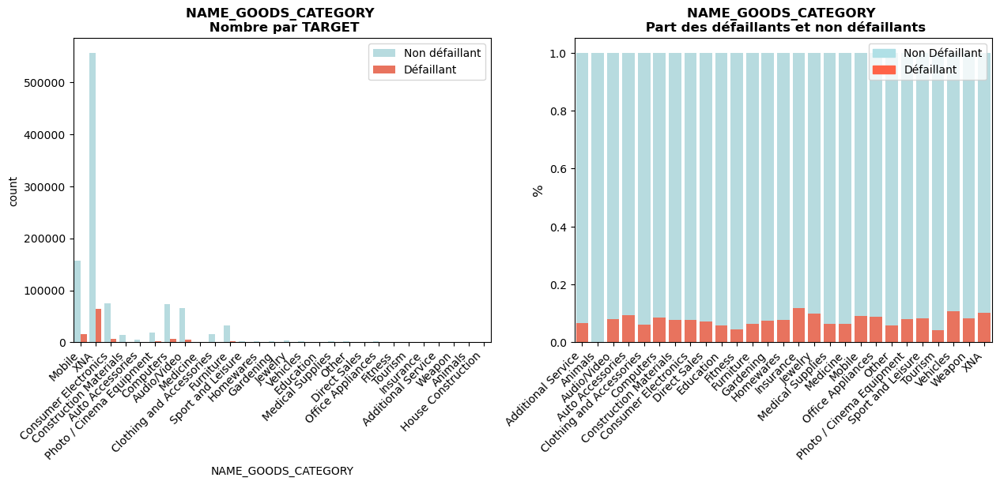

NAME_PORTFOLIO vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


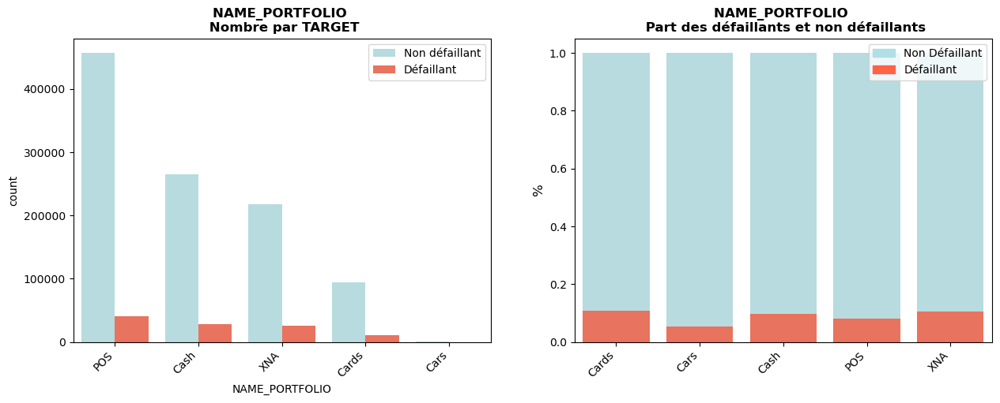

NAME_PRODUCT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


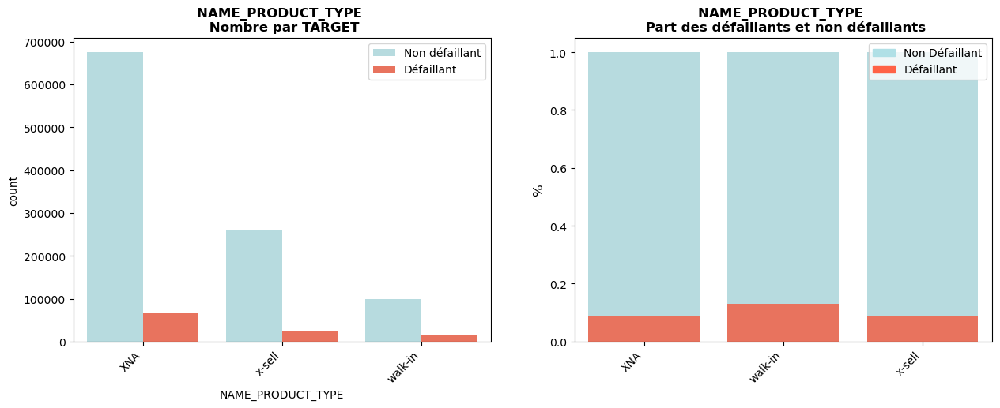

CHANNEL_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


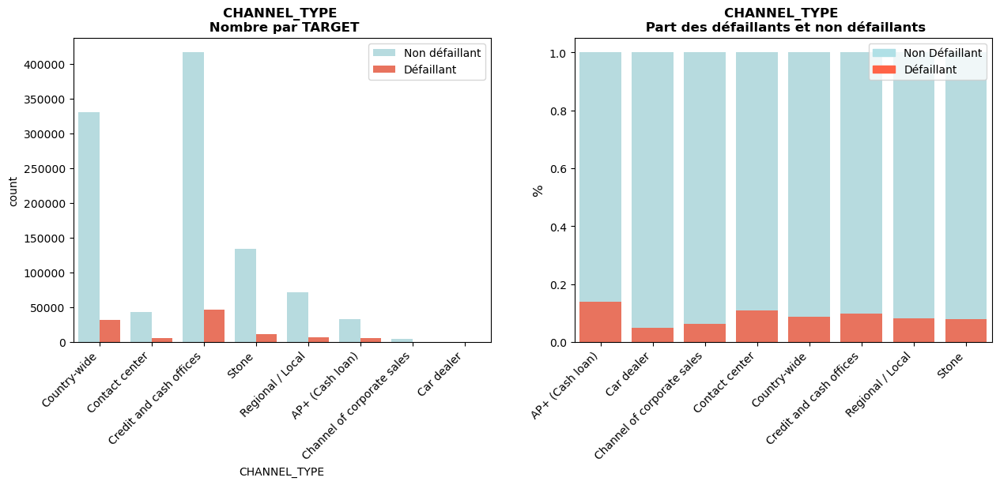

NAME_SELLER_INDUSTRY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


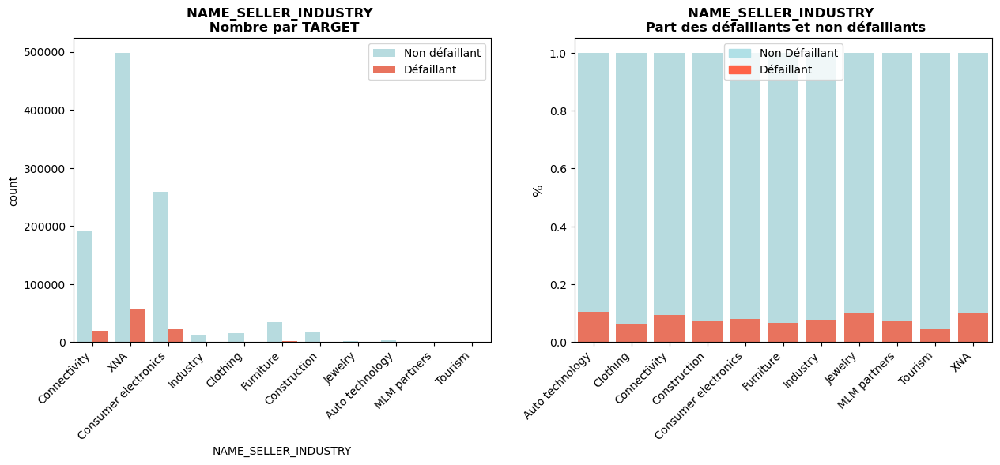

NAME_YIELD_GROUP vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


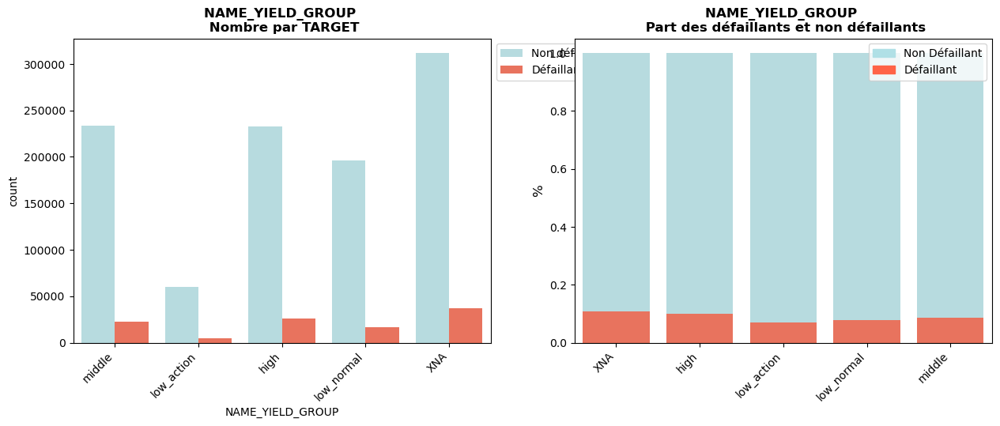

PRODUCT_COMBINATION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


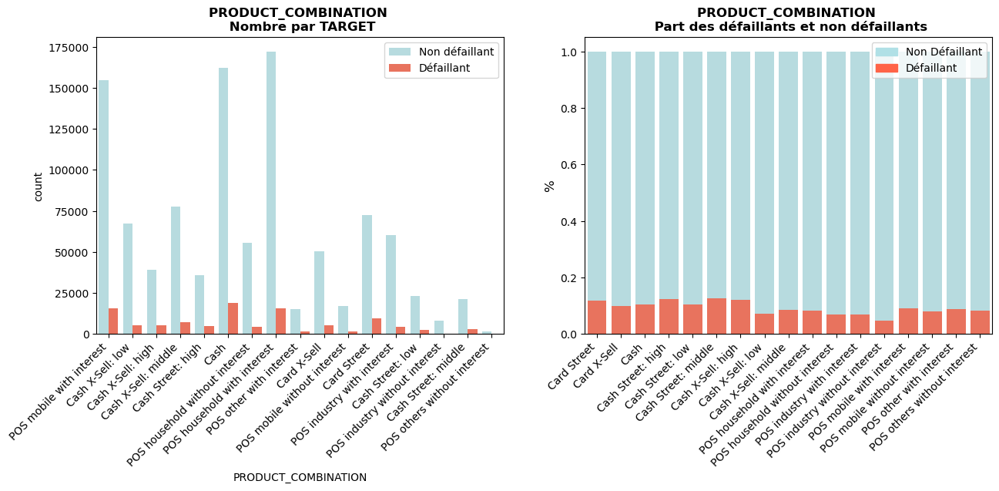

In [133]:
for var in liste_col_quali:
    fct_eda.bivariate_barplots_categ(previous_app_desc, var, 'TARGET')

L'association des variables qualitatives avec la target ayant été testée via Chi2, nous garderons pour le moment toutes les variables qualitatives.

In [134]:
previous_app_feat = previous_app_desc.copy()

#### Feature engineering

Ce dataset contient quelques variables identiques au dataset application_train et test. Nous allons créer lorsque c'est possible les mêmes ratios:

In [135]:
print(liste_col_quanti)

['AMT_ANNUITY', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE', 'HOUR_APPR_PROCESS_START', 'NFLAG_LAST_APPL_IN_DAY', 'DAYS_DECISION', 'SELLERPLACE_AREA', 'CNT_PAYMENT']


Ratios similaires dataset application train et test
- **CREDIT_GOODS_PERC**: pourcentage du crédit par rapport au montant du bien acheté

Nouveau ratio:
- **APP_CREDIT_PERC**: montant demandé sur montant accordé

In [136]:
previous_app_feat['CREDIT_GOODS_PERC'] = previous_app_feat['AMT_CREDIT'] / previous_app_feat['AMT_GOODS_PRICE']
# previous_app_feat['PAYMENT_RATE'] = previous_app_feat['AMT_ANNUITY'] / previous_app_feat['AMT_CREDIT']
# previous_app_feat['APP_CREDIT_PERC'] = previous_app_feat['AMT_APPLICATION'] / previous_app_feat['AMT_CREDIT']

In [137]:
for var in ['CREDIT_GOODS_PERC']:
    var_nan = (previous_app_feat[var].isna().sum() / previous_app_feat.shape[0]) * 100
    print(f'% de valeurs manquantes de la variable {var}: {round(var_nan, 2)} %')

% de valeurs manquantes de la variable CREDIT_GOODS_PERC: 0.16 %


Le nombre de valeurs manquantes étant faible, nous supprimons les lignes:

In [138]:
previous_app_feat = previous_app_feat[~previous_app_feat['CREDIT_GOODS_PERC'].isna()]

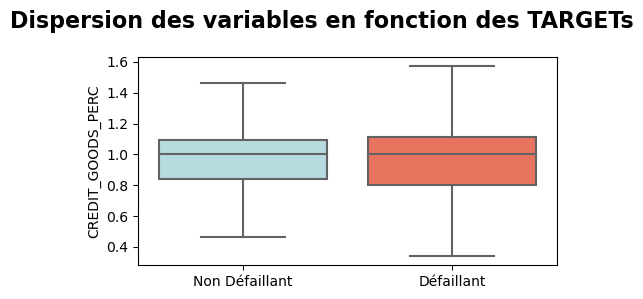

In [139]:
fig = plt.figure(figsize=(5,3))
fct_eda.bivariate_plots_box(previous_app_feat, 'TARGET', ['CREDIT_GOODS_PERC'], 1, 1, fig)

In [140]:
# Suppression des variables non conservées et de la TARGET:
del previous_app_feat['AMT_APPLICATION']
del previous_app_feat['AMT_CREDIT']
del previous_app_feat['AMT_GOODS_PRICE']
del previous_app_feat['AMT_ANNUITY']
del previous_app_feat['TARGET']

Les variables catégorielles vont être encodées à l'aide du one-hot encoder:

In [141]:
previous_app_feat, previous_app_cat = fct_eda.categories_encoder(previous_app_feat, nan_as_category = False)
previous_app_feat.head()

,SK_ID_PREV,SK_ID_CURR,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,CREDIT_GOODS_PERC,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Consumer loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_CONTRACT_TYPE_XNA,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,NAME_CASH_LOAN_PURPOSE_Building a house or an annex,NAME_CASH_LOAN_PURPOSE_Business development,NAME_CASH_LOAN_PURPOSE_Buying a garage,NAME_CASH_LOAN_PURPOSE_Buying a holiday home / land,NAME_CASH_LOAN_PURPOSE_Buying a home,NAME_CASH_LOAN_PURPOSE_Buying a new car,NAME_CASH_LOAN_PURPOSE_Buying a used car,NAME_CASH_LOAN_PURPOSE_Car repairs,NAME_CASH_LOAN_PURPOSE_Education,NAME_CASH_LOAN_PURPOSE_Everyday expenses,NAME_CASH_LOAN_PURPOSE_Furniture,NAME_CASH_LOAN_PURPOSE_Gasification / water supply,NAME_CASH_LOAN_PURPOSE_Hobby,NAME_CASH_LOAN_PURPOSE_Journey,NAME_CASH_LOAN_PURPOSE_Medicine,NAME_CASH_LOAN_PURPOSE_Money for a third person,NAME_CASH_LOAN_PURPOSE_Other,NAME_CASH_LOAN_PURPOSE_Payments on other loans,NAME_CASH_LOAN_PURPOSE_Purchase of electronic equipment,NAME_CASH_LOAN_PURPOSE_Refusal to name the goal,NAME_CASH_LOAN_PURPOSE_Repairs,NAME_CASH_LOAN_PURPOSE_Urgent needs,NAME_CASH_LOAN_PURPOSE_Wedding / gift / holiday,NAME_CASH_LOAN_PURPOSE_XAP,NAME_CASH_LOAN_PURPOSE_XNA,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Canceled,NAME_CONTRACT_STATUS_Refused,NAME_CONTRACT_STATUS_Unused offer,NAME_PAYMENT_TYPE_Cash through the bank,NAME_PAYMENT_TYPE_Cashless from the account of the employer,NAME_PAYMENT_TYPE_Non-cash from your account,NAME_PAYMENT_TYPE_XNA,CODE_REJECT_REASON_CLIENT,CODE_REJECT_REASON_HC,CODE_REJECT_REASON_LIMIT,CODE_REJECT_REASON_SCO,CODE_REJECT_REASON_SCOFR,CODE_REJECT_REASON_SYSTEM,CODE_REJECT_REASON_VERIF,CODE_REJECT_REASON_XAP,CODE_REJECT_REASON_XNA,NAME_CLIENT_TYPE_New,NAME_CLIENT_TYPE_Refreshed,NAME_CLIENT_TYPE_Repeater,NAME_CLIENT_TYPE_XNA,NAME_GOODS_CATEGORY_Additional Service,NAME_GOODS_CATEGORY_Animals,NAME_GOODS_CATEGORY_Audio/Video,NAME_GOODS_CATEGORY_Auto Accessories,NAME_GOODS_CATEGORY_Clothing and Accessories,NAME_GOODS_CATEGORY_Computers,NAME_GOODS_CATEGORY_Construction Materials,NAME_GOODS_CATEGORY_Consumer Electronics,NAME_GOODS_CATEGORY_Direct Sales,NAME_GOODS_CATEGORY_Education,NAME_GOODS_CATEGORY_Fitness,NAME_GOODS_CATEGORY_Furniture,NAME_GOODS_CATEGORY_Gardening,NAME_GOODS_CATEGORY_Homewares,NAME_GOODS_CATEGORY_House Construction,NAME_GOODS_CATEGORY_Insurance,NAME_GOODS_CATEGORY_Jewelry,NAME_GOODS_CATEGORY_Medical Supplies,NAME_GOODS_CATEGORY_Medicine,NAME_GOODS_CATEGORY_Mobile,NAME_GOODS_CATEGORY_Office Appliances,NAME_GOODS_CATEGORY_Other,NAME_GOODS_CATEGORY_Photo / Cinema Equipment,NAME_GOODS_CATEGORY_Sport and Leisure,NAME_GOODS_CATEGORY_Tourism,NAME_GOODS_CATEGORY_Vehicles,NAME_GOODS_CATEGORY_Weapon,NAME_GOODS_CATEGORY_XNA,NAME_PORTFOLIO_Cards,NAME_PORTFOLIO_Cars,NAME_PORTFOLIO_Cash,NAME_PORTFOLIO_POS,NAME_PORTFOLIO_XNA,NAME_PRODUCT_TYPE_XNA,NAME_PRODUCT_TYPE_walk-in,NAME_PRODUCT_TYPE_x-sell,CHANNEL_TYPE_AP+ (Cash loan),CHANNEL_TYPE_Car dealer,CHANNEL_TYPE_Channel of corporate sales,CHANNEL_TYPE_Contact center,CHANNEL_TYPE_Country-wide,CHANNEL_TYPE_Credit and cash offices,CHANNEL_TYPE_Regional / Local,CHANNEL_TYPE_Stone,NAME_SELLER_INDUSTRY_Auto technology,NAME_SELLER_INDUSTRY_Clothing,NAME_SELLER_INDUSTRY_Connectivity,NAME_SELLER_INDUSTRY_Construction,NAME_SELLER_INDUSTRY_Consumer electronics,NAME_SELLER_INDUSTRY_Furniture,NAME_SELLER_INDUSTRY_Industry,NAME_SELLER_INDUSTRY_Jewelry,NAME_SELLER_INDUSTRY_MLM partners,NAME_SELLER_INDUSTRY_Tourism,NAME_SELLER_INDUSTRY_XNA,NAME_YIELD_GROUP_XNA,NAME_YIELD_GROUP_high,NAME_YIELD_GROUP_low_action,NAME_YIELD_GROUP_low_normal,NAME_YIELD_GROUP_middle,PRODUCT_COMBINATION_Card Street,PRODUCT_COMBINATION_Card X-Sell,PRODUCT_COMBINA

Comme il y a **plusieurs lignes par SK_ID_CURR** correspondant aux anciens crédits, nous allons grouper notre table par SK_ID_CURR et agréger les variables pour obtenir le minimum, maximum et la moyenne.

In [142]:
# Dictionnaire des agrégations pour les variables numériques
num_aggregations = {
    'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
    'FLAG_LAST_APPL_PER_CONTRACT' : ['mean'],
    'NFLAG_LAST_APPL_IN_DAY': ['mean'],
    'DAYS_DECISION': ['min', 'max', 'mean'],
    'SELLERPLACE_AREA' : ['min', 'max', 'mean'],
    'CNT_PAYMENT': ['mean', 'sum'],
    'CREDIT_GOODS_PERC' : ['mean'],
    }

In [143]:
# Dictionnaire des agrégations pour les variables catégorielles
cat_aggregations = {}
for cat in previous_app_cat:
    cat_aggregations[cat] = ['mean']

In [144]:
# Groupe par SK_ID_CURR + agrégation
previous_app_feat_gby = previous_app_feat.groupby('SK_ID_CURR').agg({**num_aggregations,
                                                                     **cat_aggregations})

In [145]:
# On renomme les colonnes pour supprimer le multiindex
previous_app_feat_gby.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() 
                                          for e in previous_app_feat_gby.columns.tolist()])

In [146]:
previous_app_feat_gby.isna().sum().sort_values(ascending = False)

PREV_CREDIT_GOODS_PERC_MEAN                                              2987
PREV_HOUR_APPR_PROCESS_START_MIN                                            0
PREV_NAME_PORTFOLIO_Cash_MEAN                                               0
PREV_NAME_GOODS_CATEGORY_Tourism_MEAN                                       0
PREV_NAME_GOODS_CATEGORY_Vehicles_MEAN                                      0
PREV_NAME_GOODS_CATEGORY_Weapon_MEAN                                        0
PREV_NAME_GOODS_CATEGORY_XNA_MEAN                                           0
PREV_NAME_PORTFOLIO_Cards_MEAN                                              0
PREV_NAME_PORTFOLIO_Cars_MEAN                                               0
PREV_NAME_PORTFOLIO_POS_MEAN                                                0
PREV_NAME_GOODS_CATEGORY_Photo / Cinema Equipment_MEAN                      0
PREV_NAME_PORTFOLIO_XNA_MEAN                                                0
PREV_NAME_PRODUCT_TYPE_XNA_MEAN                                 

Les quelques valeurs manquantes vont être remplacées par la moyenne:

In [147]:
# Imputation des valeurs manquantes par la moyenne
for col in previous_app_feat_gby.columns:
    previous_app_feat_gby[col] = previous_app_feat_gby[col].fillna(previous_app_feat_gby[col].mean())

Nous allons calculer des indicateurs agrégés spécifiquement pour les statuts approuvés et refusés. Nous ne conserverons que les variables numériques et traiterons les valeurs manquantes selon la moyenne.

In [148]:
# Indicateurs agrégés crédits approuvés
cred_approuv = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Approved'] == 1]
cred_approuv_agg = cred_approuv.groupby('SK_ID_CURR').agg(num_aggregations)
cred_approuv_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in cred_approuv_agg.columns.tolist()])
cred_approuv_agg[~cred_approuv_agg.isin([np.inf, -np.inf]).any(1)]
previous_app_agg = previous_app_feat_gby.join(cred_approuv_agg, how = 'left', on = 'SK_ID_CURR')

# Indicateurs agrégés crédits refusés
cred_refus = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Refused'] == 1]
cred_refus_agg = cred_refus.groupby('SK_ID_CURR').agg(num_aggregations)
cred_refus_agg.columns = pd.Index(['REFUSED' + e[0] + "_" + e[1].upper() for e in cred_refus_agg.columns.tolist()])
cred_refus_agg[~cred_refus_agg.isin([np.inf, -np.inf]).any(1)]
previous_app_agg = previous_app_agg.join(cred_refus_agg, how = 'left', on = 'SK_ID_CURR')

In [149]:
previous_app_agg.isna().sum().sort_values(ascending = False)

REFUSEDCREDIT_GOODS_PERC_MEAN                                            221976
REFUSEDDAYS_DECISION_MAX                                                 220753
REFUSEDHOUR_APPR_PROCESS_START_MIN                                       220753
REFUSEDHOUR_APPR_PROCESS_START_MAX                                       220753
REFUSEDHOUR_APPR_PROCESS_START_MEAN                                      220753
REFUSEDFLAG_LAST_APPL_PER_CONTRACT_MEAN                                  220753
REFUSEDDAYS_DECISION_MIN                                                 220753
REFUSEDNFLAG_LAST_APPL_IN_DAY_MEAN                                       220753
REFUSEDDAYS_DECISION_MEAN                                                220753
REFUSEDSELLERPLACE_AREA_MIN                                              220753
REFUSEDSELLERPLACE_AREA_MAX                                              220753
REFUSEDSELLERPLACE_AREA_MEAN                                             220753
REFUSEDCNT_PAYMENT_MEAN                 

Un crédit étant soit approuvé soit refusé, nous allons remplacer les valeurs manquantes de ces variables par la constante 0 et par la moyenne pour les variable de ratio:

In [150]:
# Imputation des valeurs manquantes par la constante 0
for col in cred_approuv_agg.columns:
    previous_app_agg[col] = previous_app_agg[col].fillna(0)

for col in cred_refus_agg.columns:
    previous_app_agg[col] = previous_app_agg[col].fillna(0)

In [151]:
previous_app_agg.shape

(338854, 176)

#### Fonction de preprocessing

In [152]:
def preprocess_previous_app():
    '''Fonction de preprocessing du dataset previous application:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    previous_app = pd.read_csv('data/previous_application.csv',
                           sep=',',
                           encoding='utf-8')
    
    # Traitement des données manquantes
        
        # Suppression des variables avec 30% ou plus de NaN
    previous_app = fct_eda.tx_rempl_min(previous_app, 70)
        
        # Iterative imputer pour les variables corrélées entre-elles
    previous_app['AMT_CREDIT'] = fct_eda.iterative_imputer_function(
        previous_app[['AMT_CREDIT', 'AMT_APPLICATION']])[:,0]
    previous_app['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
        previous_app[['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
                      'AMT_APPLICATION', 'CNT_PAYMENT']])[:,0]

        # Médiane et mode pour variables avec taux de NaN > 70% (hors variable TARGET)
    df_nan = fct_eda.nan_a_retraiter(previous_app)
    col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                     (df_nan['dtypes'] == 'float64')].index.tolist()
    for col in col_med:
        previous_app[col] = previous_app[col].fillna(previous_app[col].median())
        
        # Imputation de la variable NAME_TYPE_SUITE par le mode
    previous_app['PRODUCT_COMBINATION'] = previous_app['PRODUCT_COMBINATION'].fillna(
        previous_app['PRODUCT_COMBINATION'].mode()[0])
    
    # Feature engineering
    previous_app_feat = previous_app.copy()
    previous_app_feat['CREDIT_GOODS_PERC'] = previous_app_feat['AMT_CREDIT'] / previous_app_feat['AMT_GOODS_PRICE']
    previous_app_feat = previous_app_feat[~previous_app_feat['CREDIT_GOODS_PERC'].isna()]
    
        # Suppression des variables non conservées
    del previous_app_feat['AMT_APPLICATION']
    del previous_app_feat['AMT_CREDIT']
    del previous_app_feat['AMT_GOODS_PRICE']
    del previous_app_feat['AMT_ANNUITY']
        
        # One hot encoder
    previous_app_feat, previous_app_cat = fct_eda.categories_encoder(previous_app_feat, nan_as_category = False)
        
        # Dictionnaire des agrégations pour les variables numériques
    num_aggregations = {
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'FLAG_LAST_APPL_PER_CONTRACT' : ['mean'],
        'NFLAG_LAST_APPL_IN_DAY': ['mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'SELLERPLACE_AREA' : ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
        'CREDIT_GOODS_PERC' : ['mean'],
    }
        
        # Dictionnaire des agrégations pour les variables catégorielles
    cat_aggregations = {}
    for cat in previous_app_cat:
        cat_aggregations[cat] = ['mean']
        
        # Groupe par SK_ID_CURR + agrégation
    previous_app_feat_gby = previous_app_feat.groupby('SK_ID_CURR').agg({**num_aggregations,
                                                                         **cat_aggregations})
        
        # On renomme les colonnes pour supprimer le multiindex
    previous_app_feat_gby.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() 
                                              for e in previous_app_feat_gby.columns.tolist()])
    previous_app_feat_gby = previous_app_feat_gby[~previous_app_feat_gby.isin([np.inf, -np.inf]).any(1)]
        
        # Imputation des valeurs manquantes par la moyenne
    for col in previous_app_feat_gby.columns:
        previous_app_feat_gby[col] = previous_app_feat_gby[col].fillna(previous_app_feat_gby[col].mean())
        
        # Indicateurs agrégés crédits approuvés
    cred_approuv = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Approved'] == 1]
    cred_approuv_agg = cred_approuv.groupby('SK_ID_CURR').agg(num_aggregations)
    cred_approuv_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() 
                                         for e in cred_approuv_agg.columns.tolist()])
    cred_approuv_agg = cred_approuv_agg[~cred_approuv_agg.isin([np.inf, -np.inf]).any(1)]
    previous_app_agg = previous_app_feat_gby.join(cred_approuv_agg, how = 'left', on = 'SK_ID_CURR')

        # Indicateurs agrégés crédits refusés
    cred_refus = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Refused'] == 1]
    cred_refus_agg = cred_refus.groupby('SK_ID_CURR').agg(num_aggregations)
    cred_refus_agg.columns = pd.Index(['REFUSED' + e[0] + "_" + e[1].upper() 
                                       for e in cred_refus_agg.columns.tolist()])
    cred_refus_agg = cred_refus_agg[~cred_refus_agg.isin([np.inf, -np.inf]).any(1)]
    previous_app_agg = previous_app_agg.join(cred_refus_agg, how = 'left', on = 'SK_ID_CURR')

        # Imputation des valeurs manquantes par la constante 0
    for col in cred_approuv_agg.columns:
        previous_app_agg[col] = previous_app_agg[col].fillna(0)

    for col in cred_refus_agg.columns:
        previous_app_agg[col] = previous_app_agg[col].fillna(0)
    
    del previous_app, previous_app_feat, previous_app_feat_gby, cred_approuv_agg, cred_refus_agg
    
    gc.collect()
    
    return previous_app_agg

In [153]:
preprocess_previous_app().shape

(338384, 176)

### POS_CASH_balance.csv <a class="anchor" id="cash"></a>

#### Principales statistiques

Cette table contient les **soldes mensuels des crédits antérieurs** effectués en point de vente (POS - point of sales) et des crédits de trésorerie que les clients ont contractés auprès de Home Credit.

Il y a **une ligne par mois d'historique** pour chaque crédit à la consommation et prêts au comptant antérieurs liés aux prêts de notre échantillon.

In [154]:
# Chargement du dataset
pos_cash = pd.read_csv('data/POS_CASH_balance.csv',
                       sep=',',
                       encoding='utf-8')

In [155]:
# Description des colonnes
col_desc[col_desc['Table'] == 'POS_CASH_balance.csv']

,Unnamed: 0,Table,Row,Description,Special
142,145,POS_CASH_balance.csv,SK_ID_PREV,"ID of previous credit in Home Credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)",NaN
143,146,POS_CASH_balance.csv,SK_ID_CURR,ID of loan in our sample,NaN
144,147,POS_CASH_balance.csv,MONTHS_BALANCE,"Month of balance relative to application date (-1 means the information to the freshest monthly snapshot, 0 means the information at application - often it will be the same as -1 as many banks are not updating the information to Credit Bureau regularly )",time only relative to the application
145,148,POS_CASH_balance.csv,CNT_INSTALMENT,Term of previous credit (can change over time),NaN
146,149,POS_CASH_balance.csv,CNT_INSTALMENT_FUTURE,Installments left to pay on the previous credit,NaN
147,150,POS_CASH_balance.csv,NAME_CONTRACT_STATUS,Contract status during the month,NaN
148,151,POS_CASH_balance.csv,SK_DPD,DPD (days past due) during the month of previous credit,NaN
149,152,POS_CASH_balance.csv,SK_DPD_DEF,DPD during the month with tolerance (debts with low loan amounts are ignored) of the previous credit,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.00,45.00,Active,0,0
1,1715348,367990,-33,36.00,35.00,Active,0,0
2,1784872,397406,-32,12.00,9.00,Active,0,0
3,1903291,269225,-35,48.00,42.00,Active,0,0
4,2341044,334279,-35,36.00,35.00,Active,0,0


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
10001353,2448283,226558,-20,6.00,0.00,Active,843,0
10001354,1717234,141565,-19,12.00,0.00,Active,602,0
10001355,1283126,315695,-21,10.00,0.00,Active,609,0
10001356,1082516,450255,-22,12.00,0.00,Active,614,0
10001357,1259607,174278,-52,16.00,0.00,Completed,0,0


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 10001358
Nombre de colonnes: 8
Nombre total de NaN du dataset: 52158
% total de NaN du dataset: 0.07%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


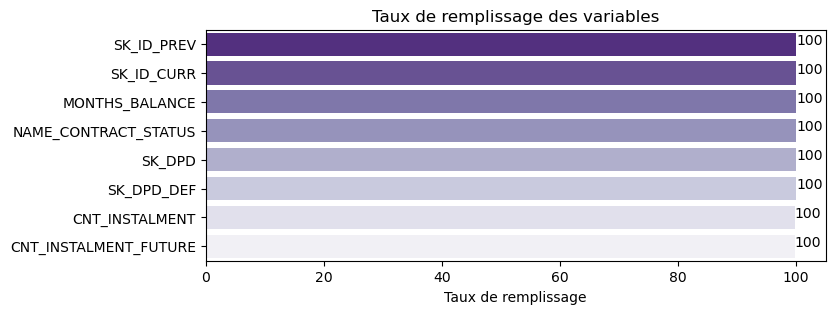

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,1803195,10001358,936325,9.36,10001358,100.00,0,0.00
1,SK_ID_CURR,int64,182943,10001358,337252,3.37,10001358,100.00,0,0.00
2,MONTHS_BALANCE,int64,-31,10001358,96,0.00,10001358,100.00,0,0.00
3,CNT_INSTALMENT,float64,48.00,10001358,73,0.00,9975287,99.74,26071,0.26
4,CNT_INSTALMENT_FUTURE,float64,45.00,10001358,79,0.00,9975271,99.74,26087,0.26
5,NAME_CONTRACT_STATUS,object,Active,10001358,9,0.00,10001358,100.00,0,0.00
6,SK_DPD,int64,0,10001358,3400,0.03,10001358,100.00,0,0.00
7,SK_DPD_DEF,int64,0,10001358,2307,0.02,10001358,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [156]:
fig = plt.figure(figsize=(8,3))
previous_app_desc = fct_eda.describe_stat(pos_cash, fig = fig)

#### Traitement des données manquantes

Il y a peu de données manquantes dans ce dataset. Nous allons les compléter par la **médiane**.

In [157]:
pos_cash_nan = pos_cash.copy()

In [158]:
# Imputation des variables par la médiane
for col in ['CNT_INSTALMENT', 'CNT_INSTALMENT_FUTURE']:
    pos_cash_nan[col] = pos_cash_nan[col].fillna(pos_cash_nan[col].median())

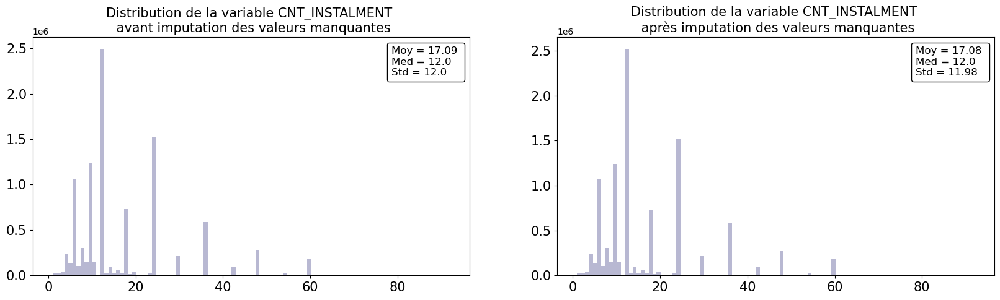

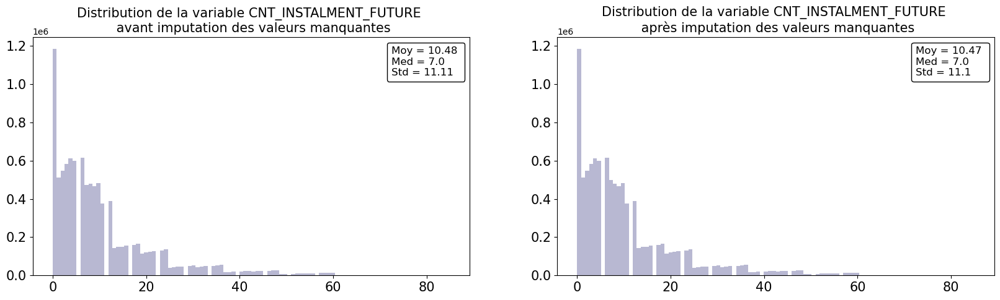

In [159]:
for var in ['CNT_INSTALMENT', 'CNT_INSTALMENT_FUTURE']:
    fct_eda.distrib_imput_nan_quanti(pos_cash, var, pos_cash_nan)

Les distributions sont quasiment identiques, nous validons la méthode.

#### Analyses univariées

In [160]:
pos_cash_desc = pos_cash_nan.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [161]:
liste_col_quanti = pos_cash_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [162]:
len(liste_col_quanti)

5

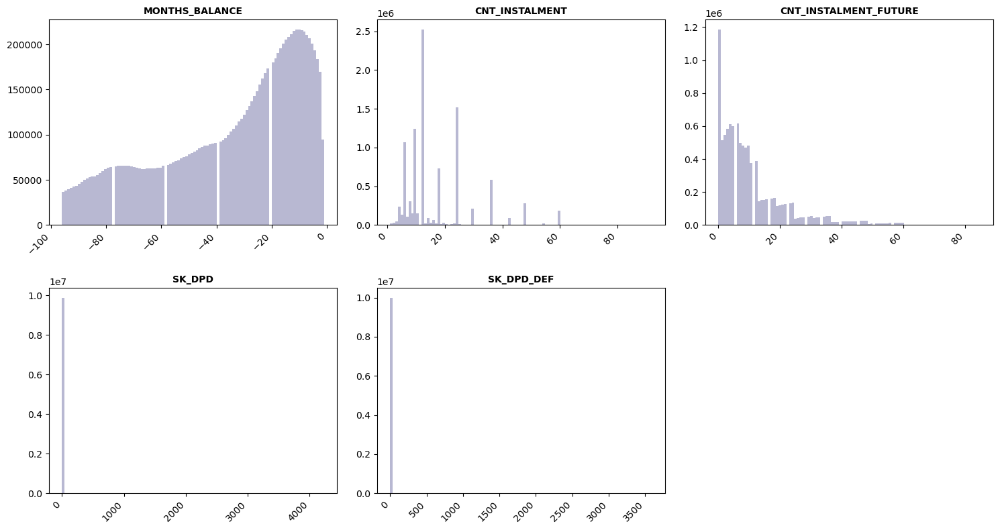

In [163]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_hist(pos_cash_desc, liste_col_quanti, 2, 3, 100, fig=fig)

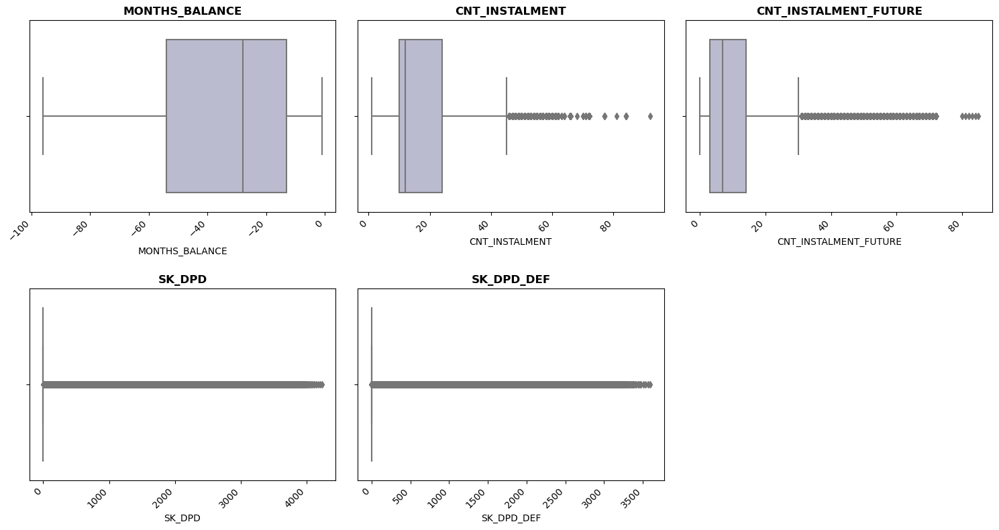

In [164]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_box(pos_cash_desc, liste_col_quanti, 2, 3, fig, True)

In [165]:
pos_cash_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
MONTHS_BALANCE,10001358.00,-35.01,26.07,-96.00,-54.00,-28.00,-13.00,-1.00
CNT_INSTALMENT,10001358.00,17.08,11.98,1.00,10.00,12.00,24.00,92.00
CNT_INSTALMENT_FUTURE,10001358.00,10.47,11.10,0.00,3.00,7.00,14.00,85.00
SK_DPD,10001358.00,11.61,132.71,0.00,0.00,0.00,0.00,4231.00
SK_DPD_DEF,10001358.00,0.65,32.76,0.00,0.00,0.00,0.00,3595.00


In [166]:
liste_col_quali = pos_cash_desc.select_dtypes(include='object').columns

In [167]:
len(liste_col_quali)

1

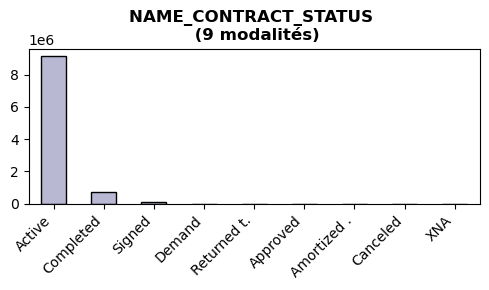

In [168]:
fig = plt.figure(figsize=(5, 3))
fct_eda.categ_distrib_plot(pos_cash_desc, liste_col_quali, 1, 1, fig = fig)

La modalité XNA semble représenter les valeurs non affectées. Nous la conservons.

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [169]:
pos_cash_desc = pos_cash_desc.merge(app_train_select.reset_index()[['SK_ID_CURR', 'TARGET']],
                                    on = 'SK_ID_CURR',
                                    how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [170]:
liste_target = ['TARGET']
liste_corr = liste_col_quanti + liste_target

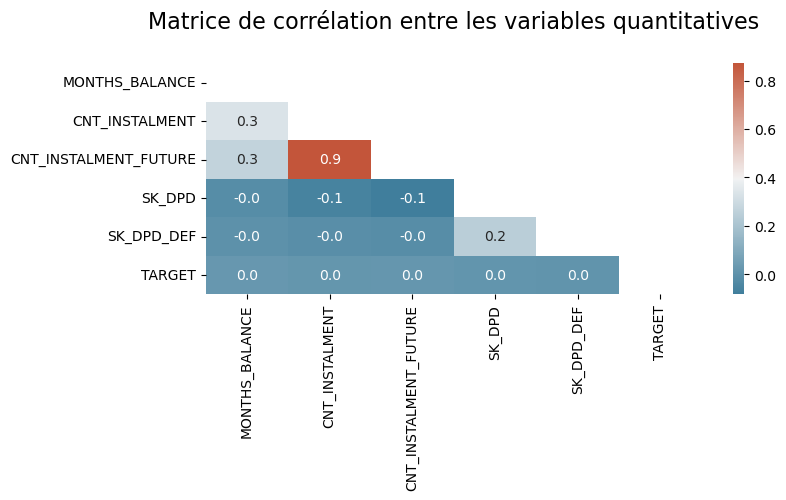

In [171]:
# Corrélation
corr = pos_cash_desc[liste_corr].corr()

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,3))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation entre les variables quantitatives\n", fontsize=16);

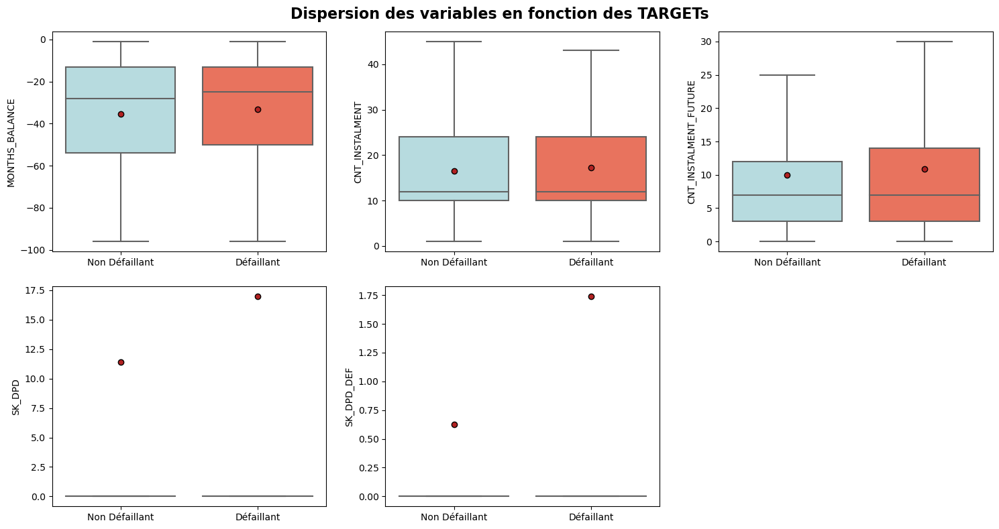

In [172]:
fig = plt.figure(figsize=(15,8))
fct_eda.bivariate_plots_box(pos_cash_desc, 'TARGET', liste_col_quanti, 2, 3, fig)

Les variables CNT_INSTALMENT_FUTURE et CNT_INSTALMENT sont extêmement corrélées, nous n'en garderons qu'une seule.
D'après les boxplots, nous conservons CNT_INSTALMENT_FUTURE qui est visuellement plus significative.

In [173]:
del pos_cash_desc['CNT_INSTALMENT']

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

NAME_CONTRACT_STATUS vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 9.346587884548857e-128 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


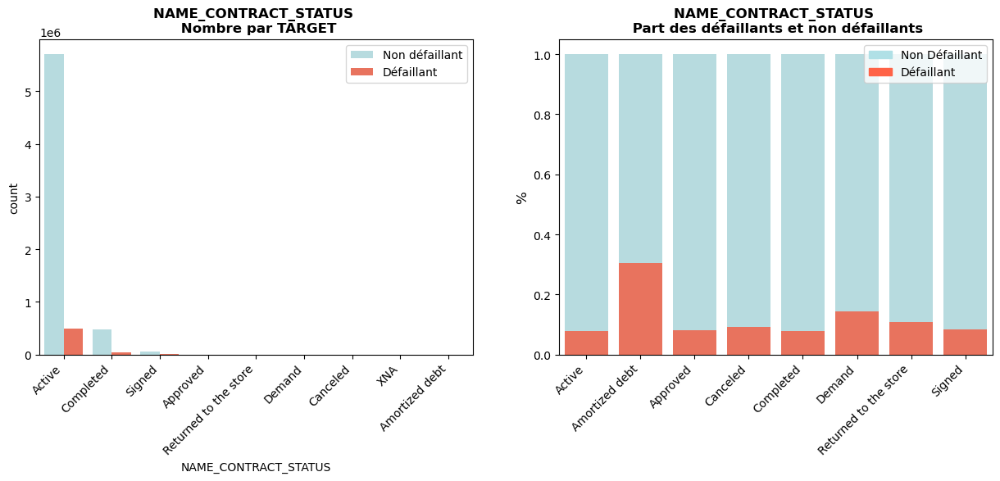

In [174]:
for var in liste_col_quali:
    fct_eda.bivariate_barplots_categ(pos_cash_desc, var, 'TARGET')

L'association de la variable qualitative avec la target ayant été testée via Chi2, nous la conservons.

In [175]:
pos_cash_feat = pos_cash_desc.copy()

#### Feature engineering

Les variables catégorielles vont être encodées à l'aide du one-hot encoder:

In [176]:
pos_cash_feat, pos_cash_cat = fct_eda.categories_encoder(pos_cash_feat, nan_as_category = False)
pos_cash_feat.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT_FUTURE,SK_DPD,SK_DPD_DEF,TARGET,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Amortized debt,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Canceled,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_Demand,NAME_CONTRACT_STATUS_Returned to the store,NAME_CONTRACT_STATUS_Signed,NAME_CONTRACT_STATUS_XNA
0,1803195,182943,-31,45.00,0,0,NaN,1,0,0,0,0,0,0,0,0
1,1715348,367990,-33,35.00,0,0,0.00,1,0,0,0,0,0,0,0,0
2,1784872,397406,-32,9.00,0,0,NaN,1,0,0,0,0,0,0,0,0
3,1903291,269225,-35,42.00,0,0,NaN,1,0,0,0,0,0,0,0,0
4,2341044,334279,-35,35.00,0,0,0.00,1,0,0,0,0,0,0,0,0


Comme il y a **plusieurs lignes par SK_ID_CURR** correspondant mois d'historique, nous allons grouper notre table par SK_ID_CURR et agréger les variables pour obtenir le maximum et la moyenne et le nombre pour MONTHS_BALANCE.

In [177]:
# Dictionnaire des agrégations pour les variables numériques
aggregations = {
    'MONTHS_BALANCE': ['max', 'mean', 'size'],
    'SK_DPD': ['max', 'mean'],
    'SK_DPD_DEF': ['max', 'mean']
}

In [178]:
# Dictionnaire des agrégations pour les variables catégorielles
for cat in pos_cash_cat:
    aggregations[cat] = ['mean']

In [179]:
# Groupe par SK_ID_CURR + agrégation
pos_cash_feat_gby = pos_cash_feat.groupby('SK_ID_CURR').agg(aggregations)

In [180]:
# On renomme les colonnes pour supprimer le multi-index
pos_cash_feat_gby.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() 
                                      for e in pos_cash_feat_gby.columns.tolist()])

In [181]:
# Nombre de soldes mensuels de crédits antérieurs par SK_ID_CURR
pos_cash_feat_gby['POS_COUNT'] = pos_cash_feat.groupby('SK_ID_CURR').size()

In [182]:
pos_cash_feat_gby.head()

,POS_MONTHS_BALANCE_MAX,POS_MONTHS_BALANCE_MEAN,POS_MONTHS_BALANCE_SIZE,POS_SK_DPD_MAX,POS_SK_DPD_MEAN,POS_SK_DPD_DEF_MAX,POS_SK_DPD_DEF_MEAN,POS_NAME_CONTRACT_STATUS_Active_MEAN,POS_NAME_CONTRACT_STATUS_Amortized debt_MEAN,POS_NAME_CONTRACT_STATUS_Approved_MEAN,POS_NAME_CONTRACT_STATUS_Canceled_MEAN,POS_NAME_CONTRACT_STATUS_Completed_MEAN,POS_NAME_CONTRACT_STATUS_Demand_MEAN,POS_NAME_CONTRACT_STATUS_Returned to the store_MEAN,POS_NAME_CONTRACT_STATUS_Signed_MEAN,POS_NAME_CONTRACT_STATUS_XNA_MEAN,POS_COUNT
SK_ID_CURR,,,,,,,,,,,,,,,,,
100001,-53,-72.56,9,7,0.78,7,0.78,0.78,0.00,0.00,0.00,0.22,0.00,0.00,0.00,0.00,9
100002,-1,-10.00,19,0,0.00,0,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,19
100003,-18,-43.79,28,0,0.00,0,0.00,0.93,0.00,0.00,0.00,0.07,0.00,0.00,0.00,0.00,28
100004,-24,-25.50,4,0,0.00,0,0.00,0.75,0.00,0.00,0.00,0.25,0.00,0.00,0.00,0.00,4
100005,-15,-20.00,11,0,0.00,0,0.00,0.82,0.00,0.00,0.00,0.09,0.00,0.00,0.09,0.00,11


In [183]:
pos_cash_feat_gby.isna().sum().sort_values(ascending = False)

POS_MONTHS_BALANCE_MAX                                 0
POS_NAME_CONTRACT_STATUS_Approved_MEAN                 0
POS_NAME_CONTRACT_STATUS_XNA_MEAN                      0
POS_NAME_CONTRACT_STATUS_Signed_MEAN                   0
POS_NAME_CONTRACT_STATUS_Returned to the store_MEAN    0
POS_NAME_CONTRACT_STATUS_Demand_MEAN                   0
POS_NAME_CONTRACT_STATUS_Completed_MEAN                0
POS_NAME_CONTRACT_STATUS_Canceled_MEAN                 0
POS_NAME_CONTRACT_STATUS_Amortized debt_MEAN           0
POS_MONTHS_BALANCE_MEAN                                0
POS_NAME_CONTRACT_STATUS_Active_MEAN                   0
POS_SK_DPD_DEF_MEAN                                    0
POS_SK_DPD_DEF_MAX                                     0
POS_SK_DPD_MEAN                                        0
POS_SK_DPD_MAX                                         0
POS_MONTHS_BALANCE_SIZE                                0
POS_COUNT                                              0
dtype: int64

In [184]:
pos_cash_feat_gby.shape

(337252, 17)

#### Fonction de preprocessing

In [185]:
def preprocess_POS_CASH_balance():
    '''Fonction de preprocessing du dataset POS_CASH_balance:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    pos_cash = pd.read_csv('data/POS_CASH_balance.csv',
                           sep=',',
                           encoding='utf-8')
    
    # Traitement des données manquantes (médiane)
    for col in ['CNT_INSTALMENT', 'CNT_INSTALMENT_FUTURE']:
        pos_cash[col] = pos_cash[col].fillna(pos_cash[col].median())

    # Feature engineering
    del pos_cash['CNT_INSTALMENT']
    pos_cash_feat, pos_cash_cat = fct_eda.categories_encoder(pos_cash, nan_as_category = False)
        # Dictionnaire des agrégations pour les variables numériques
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    
        # Dictionnaire des agrégations pour les variables catégorielles
    for cat in pos_cash_cat:
        aggregations[cat] = ['mean']

        # Groupe par SK_ID_CURR + agrégation
    pos_cash_feat_gby = pos_cash_feat.groupby('SK_ID_CURR').agg(aggregations)

        # On renomme les colonnes pour supprimer le multi-index
    pos_cash_feat_gby.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() 
                                          for e in pos_cash_feat_gby.columns.tolist()])
    
        # Nombre de soldes mensuels de crédits antérieurs par SK_ID_CURR
    pos_cash_feat_gby['POS_COUNT'] = pos_cash_feat.groupby('SK_ID_CURR').size()

    del pos_cash, pos_cash_feat

    gc.collect()
    
    return pos_cash_feat_gby

In [186]:
preprocess_POS_CASH_balance().shape

(337252, 17)

### installments_payments.csv <a class="anchor" id="install"></a>

#### Principales statistiques

Ce dataset contient **l'historique des remboursements de chaque prêt** des clients de Home Crédit présents dans notre échantillon.

Il y a:
- une ligne pour chaque paiement effectué
- une ligne pour chaque paiement manqué

Une ligne équivaut à un paiement d'une mensualité OU à une mensualité correspondant à un paiement d'un précédent crédit à domicile lié aux prêts de notre échantillon.

In [187]:
# Chargement du dataset
install_pay = pd.read_csv('data/installments_payments.csv',
                          sep=',',
                          encoding='utf-8')

In [188]:
# Description des colonnes
col_desc[col_desc['Table'] == 'installments_payments.csv']

,Unnamed: 0,Table,Row,Description,Special
211,214,installments_payments.csv,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)",hashed
212,215,installments_payments.csv,SK_ID_CURR,ID of loan in our sample,hashed
213,216,installments_payments.csv,NUM_INSTALMENT_VERSION,Version of installment calendar (0 is for credit card) of previous credit. Change of installment version from month to month signifies that some parameter of payment calendar has changed,NaN
214,217,installments_payments.csv,NUM_INSTALMENT_NUMBER,On which installment we observe payment,NaN
215,218,installments_payments.csv,DAYS_INSTALMENT,When the installment of previous credit was supposed to be paid (relative to application date of current loan),time only relative to the application
216,219,installments_payments.csv,DAYS_ENTRY_PAYMENT,When was the installments of previous credit paid actually (relative to application date of current loan),time only relative to the application
217,220,installments_payments.csv,AMT_INSTALMENT,What was the prescribed installment amount of previous credit on this installment,NaN
218,221,installments_payments.csv,AMT_PAYMENT,What the client actually paid on previous credit on this installment,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.00,6,-1180.00,-1187.00,6948.36,6948.36
1,1330831,151639,0.00,34,-2156.00,-2156.00,1716.53,1716.53
2,2085231,193053,2.00,1,-63.00,-63.00,25425.00,25425.00
3,2452527,199697,1.00,3,-2418.00,-2426.00,24350.13,24350.13
4,2714724,167756,1.00,2,-1383.00,-1366.00,2165.04,2160.59


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
13605396,2186857,428057,0.00,66,-1624.00,NaN,67.50,NaN
13605397,1310347,414406,0.00,47,-1539.00,NaN,67.50,NaN
13605398,1308766,402199,0.00,43,-7.00,NaN,43737.43,NaN
13605399,1062206,409297,0.00,43,-1986.00,NaN,67.50,NaN
13605400,2448869,434321,1.00,19,-27.00,NaN,11504.25,NaN


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 13605401
Nombre de colonnes: 8
Nombre total de NaN du dataset: 5810
% total de NaN du dataset: 0.01%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


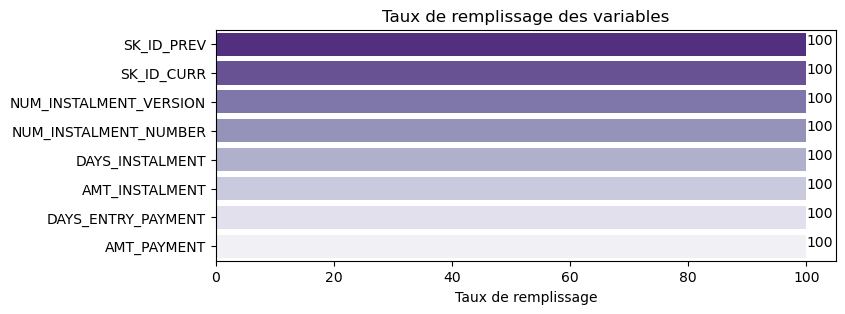

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,1054186,13605401,997752,7.33,13605401,100.00,0,0.00
1,SK_ID_CURR,int64,161674,13605401,339587,2.50,13605401,100.00,0,0.00
2,NUM_INSTALMENT_VERSION,float64,1.00,13605401,65,0.00,13605401,100.00,0,0.00
3,NUM_INSTALMENT_NUMBER,int64,6,13605401,277,0.00,13605401,100.00,0,0.00
4,DAYS_INSTALMENT,float64,-1180.00,13605401,2922,0.02,13605401,100.00,0,0.00
5,DAYS_ENTRY_PAYMENT,float64,-1187.00,13605401,3039,0.02,13602496,99.98,2905,0.02
6,AMT_INSTALMENT,float64,6948.36,13605401,902539,6.63,13605401,100.00,0,0.00
7,AMT_PAYMENT,float64,6948.36,13605401,944235,6.94,13602496,99.98,2905,0.02


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [189]:
fig = plt.figure(figsize=(8,3))
install_pay_desc = fct_eda.describe_stat(install_pay, fig = fig)

#### Traitement des données manquantes

Il y a peu de données manquantes dans ce dataset. Nous allons les compléter par la **médiane**.

In [190]:
install_pay_nan = install_pay.copy()

In [191]:
# Imputation des variables par la médiane
for col in ['DAYS_ENTRY_PAYMENT', 'AMT_PAYMENT']:
    install_pay_nan[col] = install_pay_nan[col].fillna(install_pay_nan[col].median())

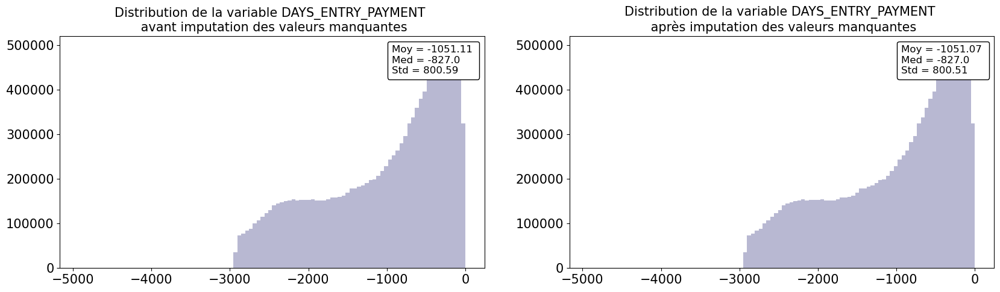

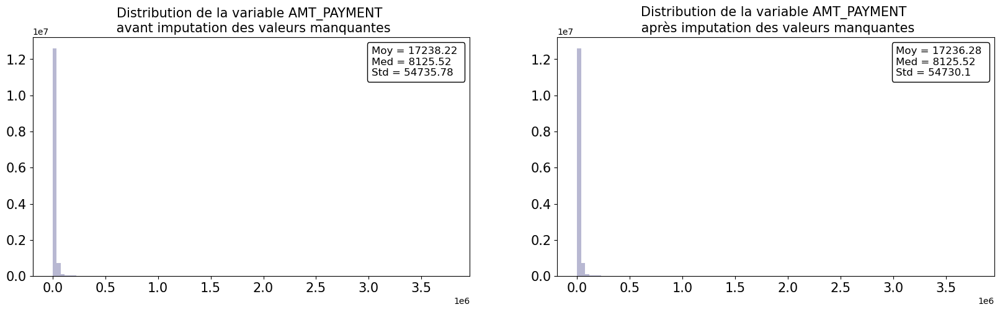

In [192]:
for var in ['DAYS_ENTRY_PAYMENT', 'AMT_PAYMENT']:
    fct_eda.distrib_imput_nan_quanti(install_pay, var, install_pay_nan)

Les distributions sont quasiment identiques, nous validons la méthode.

#### Analyses univariées

In [193]:
install_pay_desc = install_pay_nan.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [194]:
liste_col_quanti = install_pay_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [195]:
len(liste_col_quanti)

6

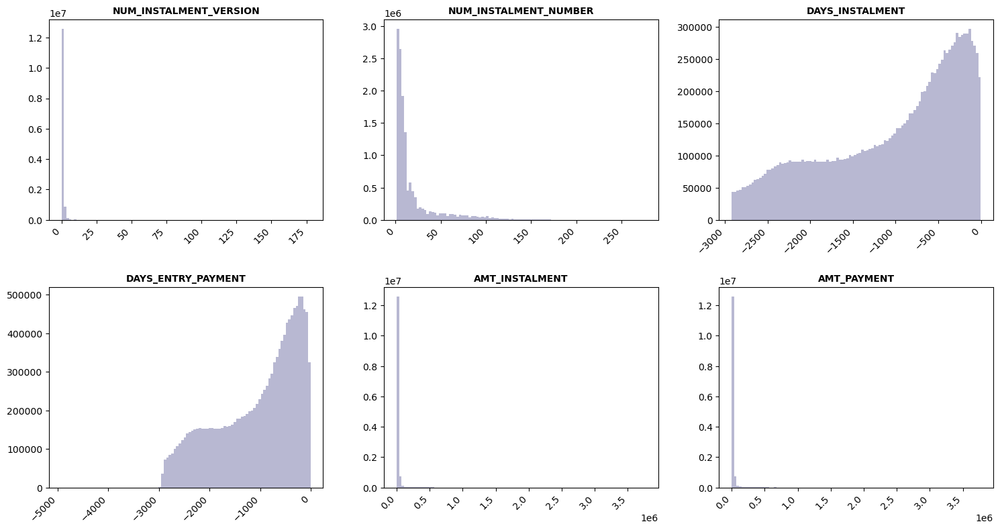

In [196]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_hist(install_pay_desc, liste_col_quanti, 2, 3, 100, fig=fig)

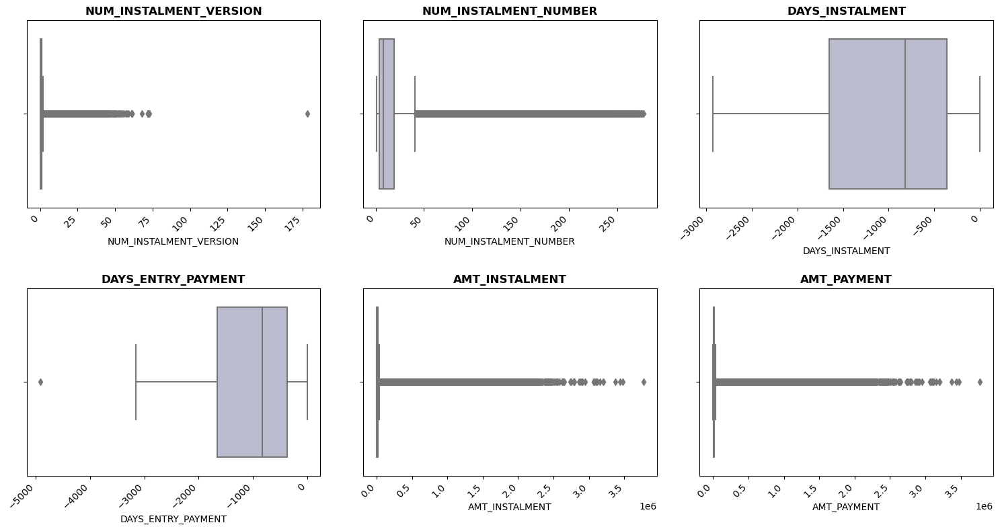

In [197]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_box(install_pay_desc, liste_col_quanti, 2, 3, fig, True)

In [198]:
install_pay_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
NUM_INSTALMENT_VERSION,13605401.00,0.86,1.04,0.00,0.00,1.00,1.00,178.00
NUM_INSTALMENT_NUMBER,13605401.00,18.87,26.66,1.00,4.00,8.00,19.00,277.00
DAYS_INSTALMENT,13605401.00,-1042.27,800.95,-2922.00,-1654.00,-818.00,-361.00,-1.00
DAYS_ENTRY_PAYMENT,13605401.00,-1051.07,800.51,-4921.00,-1662.00,-827.00,-370.00,-1.00
AMT_INSTALMENT,13605401.00,17050.91,50570.25,0.00,4226.09,8884.08,16710.21,3771487.85
AMT_PAYMENT,13605401.00,17236.28,54730.10,0.00,3399.30,8125.52,16105.91,3771487.85


#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [199]:
install_pay_desc = install_pay_desc.merge(app_train_select.reset_index()[['SK_ID_CURR', 'TARGET']],
                                          on = 'SK_ID_CURR',
                                          how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [200]:
liste_target = ['TARGET']
liste_corr = liste_col_quanti + liste_target

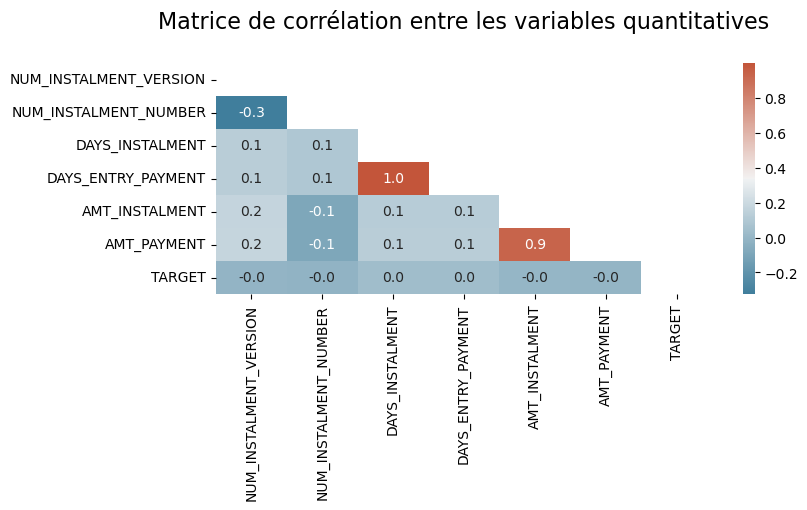

In [201]:
# Corrélation
corr = install_pay_desc[liste_corr].corr()

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,3))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation entre les variables quantitatives\n", fontsize=16);

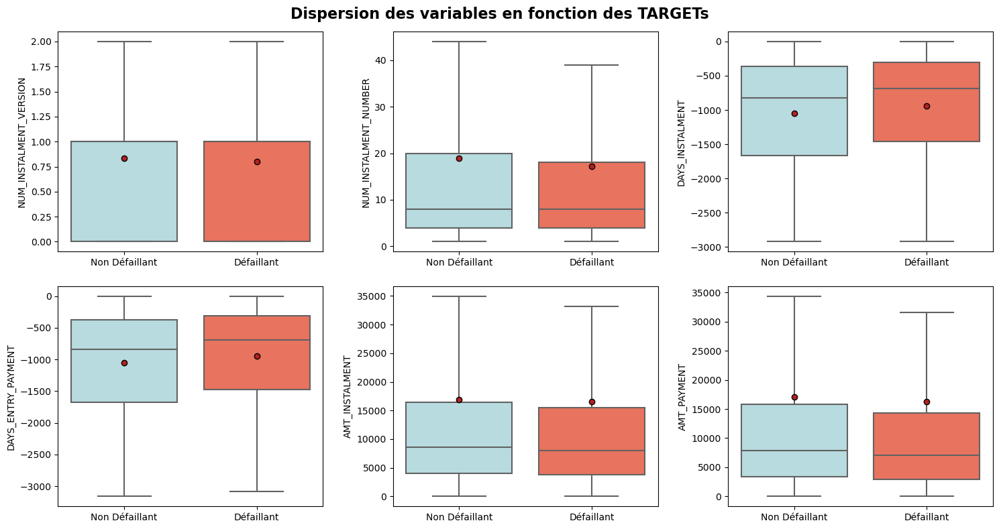

In [202]:
fig = plt.figure(figsize=(15,8))
fct_eda.bivariate_plots_box(install_pay_desc, 'TARGET', liste_col_quanti, 2, 3, fig)

Les variables DAYS_ENTRY_PAYMENT et DAYS_INSTALMENT sont extêmement corrélées ainsi que les variables AMT_PAYMENT et AMT_INSTALMENT.

In [203]:
install_pay_feat = install_pay_desc.copy()

#### Feature engineering

Nous allons créer de nouveaux indicateurs à l'aide de ceux que nous avons:
- **PAYMENT_PERC**: montant du paiement sur le montant de la mensualité
- **PAYMENT_DIFF**: restant dû entre la mensualité et ce qui a été payé
- **DAYS_PAST_DUE**: nombre de jours de retard entre le paiement de la mensualité et quand la mensualité devait être payée (pas de valeurs négatives, sinon DAYS_BEFORE_DUE)
- **DAYS_BEFORE_DUE**: nombre de jours d'avance entre le paiement de la mensualité et quand la mensualité devait être payée (pas de valeurs négatives, sinon DAYS_PAST_DUE)

In [204]:
#install_pay_feat['PAYMENT_PERC'] = install_pay_feat['AMT_PAYMENT'] / install_pay_feat['AMT_INSTALMENT']
install_pay_feat['PAYMENT_DIFF'] = install_pay_feat['AMT_INSTALMENT'] - install_pay_feat['AMT_PAYMENT']
install_pay_feat['DAYS_PAST_DUE'] = install_pay_feat['DAYS_ENTRY_PAYMENT'] - install_pay_feat['DAYS_INSTALMENT']
install_pay_feat['DAYS_PAST_DUE'] = install_pay_feat['DAYS_PAST_DUE'].apply(lambda x: x if x > 0 else 0)
install_pay_feat['DAYS_BEFORE_DUE'] = install_pay_feat['DAYS_INSTALMENT'] - install_pay_feat['DAYS_ENTRY_PAYMENT']
install_pay_feat['DAYS_BEFORE_DUE'] = install_pay_feat['DAYS_BEFORE_DUE'].apply(lambda x: x if x > 0 else 0)

Comme il y a plusieurs lignes par SK_ID_CURR correspondant aux paiements effectués ou manqués, nous allons grouper notre table par SK_ID_CURR et agréger les variables nouvellement créées selon les agrégations suivantes:

In [205]:
# Dictionnaire des agrégations pour les variables numériques
aggregations = {
    'DAYS_PAST_DUE': ['max', 'mean', 'sum'],
    'DAYS_BEFORE_DUE': ['max', 'mean', 'sum'],
    'PAYMENT_DIFF': ['max', 'mean', 'sum'],
}

In [206]:
# Groupe par SK_ID_CURR + agrégation
install_pay_feat_gby = install_pay_feat.groupby('SK_ID_CURR').agg(aggregations)

In [207]:
# On renomme les colonnes pour supprimer le multi-index
install_pay_feat_gby.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() 
                                         for e in install_pay_feat_gby.columns.tolist()])

In [208]:
# Calcul du nombre de versements par SK_ID_CURR
install_pay_feat_gby['INSTAL_COUNT'] = install_pay_feat.groupby('SK_ID_CURR').size()

In [209]:
install_pay_feat_gby.head()

,INSTAL_DAYS_PAST_DUE_MAX,INSTAL_DAYS_PAST_DUE_MEAN,INSTAL_DAYS_PAST_DUE_SUM,INSTAL_DAYS_BEFORE_DUE_MAX,INSTAL_DAYS_BEFORE_DUE_MEAN,INSTAL_DAYS_BEFORE_DUE_SUM,INSTAL_PAYMENT_DIFF_MAX,INSTAL_PAYMENT_DIFF_MEAN,INSTAL_PAYMENT_DIFF_SUM,INSTAL_COUNT
SK_ID_CURR,,,,,,,,,,
100001,11.00,1.57,11.00,36.00,8.86,62.00,0.00,0.00,0.00,7
100002,0.00,0.00,0.00,31.00,20.42,388.00,0.00,0.00,0.00,19
100003,0.00,0.00,0.00,14.00,7.16,179.00,0.00,0.00,0.00,25
100004,0.00,0.00,0.00,11.00,7.67,23.00,0.00,0.00,0.00,3
100005,1.00,0.11,1.00,37.00,23.67,213.00,0.00,0.00,0.00,9


In [210]:
install_pay_feat_gby.isna().sum().sort_values(ascending = False)

INSTAL_DAYS_PAST_DUE_MAX       0
INSTAL_DAYS_PAST_DUE_MEAN      0
INSTAL_DAYS_PAST_DUE_SUM       0
INSTAL_DAYS_BEFORE_DUE_MAX     0
INSTAL_DAYS_BEFORE_DUE_MEAN    0
INSTAL_DAYS_BEFORE_DUE_SUM     0
INSTAL_PAYMENT_DIFF_MAX        0
INSTAL_PAYMENT_DIFF_MEAN       0
INSTAL_PAYMENT_DIFF_SUM        0
INSTAL_COUNT                   0
dtype: int64

Le nombre de valeurs manquantes étant faible, nous les remplaçons par la moyenne:

In [211]:
#for col in ['INSTAL_PAYMENT_PERC_MEAN']:
#    install_pay_feat_gby[col] = install_pay_feat_gby[col].fillna(install_pay_feat_gby[col].mean())

In [212]:
install_pay_feat_gby.shape

(339587, 10)

#### Fonction de preprocessing

In [213]:
def preprocess_installments_payments():
    '''Fonction de preprocessing du dataset installments_payments:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    install_pay = pd.read_csv('data/installments_payments.csv',
                              sep=',',
                              encoding='utf-8')
    
    # Traitement des données manquantes (médiane)
    for col in ['DAYS_ENTRY_PAYMENT', 'AMT_PAYMENT']:
        install_pay[col] = install_pay[col].fillna(install_pay[col].median())

    # Feature engineering
    install_pay['PAYMENT_DIFF'] = install_pay['AMT_INSTALMENT'] - install_pay['AMT_PAYMENT']
    install_pay['DAYS_PAST_DUE'] = install_pay['DAYS_ENTRY_PAYMENT'] - install_pay['DAYS_INSTALMENT']
    install_pay['DAYS_PAST_DUE'] = install_pay['DAYS_PAST_DUE'].apply(lambda x: x if x > 0 else 0)
    install_pay['DAYS_BEFORE_DUE'] = install_pay['DAYS_INSTALMENT'] - install_pay['DAYS_ENTRY_PAYMENT']
    install_pay['DAYS_BEFORE_DUE'] = install_pay['DAYS_BEFORE_DUE'].apply(lambda x: x if x > 0 else 0)
        
        # Dictionnaire des agrégations pour les variables numériques
    aggregations = {
        'DAYS_PAST_DUE': ['max', 'mean', 'sum'],
        'DAYS_BEFORE_DUE': ['max', 'mean', 'sum'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum'],
    }
   
        # Groupe par SK_ID_CURR + agrégation
    install_pay_feat_gby = install_pay.groupby('SK_ID_CURR').agg(aggregations)

        # On renomme les colonnes pour supprimer le multi-index
    install_pay_feat_gby.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() 
                                             for e in install_pay_feat_gby.columns.tolist()])

        # Calcul du nombre de versements par SK_ID_CURR
    install_pay_feat_gby['INSTAL_COUNT'] = install_pay.groupby('SK_ID_CURR').size()

        # Traitement des valeurs manquantes
    #for col in ['INSTAL_PAYMENT_PERC_MEAN']:
    #    install_pay_feat_gby[col] = install_pay_feat_gby[col].fillna(install_pay_feat_gby[col].mean())

    del install_pay
    gc.collect()
    
    return install_pay_feat_gby

In [214]:
preprocess_installments_payments().shape

(339587, 10)

### credit_card_balance.csv <a class="anchor" id="credit_card"></a>

#### Principales statistiques

Ce dataset contient **les soldes mensuels des cartes de crédit précédentes** que le demandeur possède auprès de Home Credit.

Il comporte une ligne pour chaque mois de l'historique de chaque crédit antérieur auprès de Home Credit (crédit à la consommation et prêts de trésorerie) lié aux prêts de notre échantillon.

In [215]:
# Chargement du dataset
cc_balance = pd.read_csv('data/credit_card_balance.csv',
                         sep=',',
                         encoding='utf-8')

In [216]:
# Description des colonnes
col_desc[col_desc['Table'] == 'credit_card_balance.csv']

,Unnamed: 0,Table,Row,Description,Special
150,153,credit_card_balance.csv,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)",hashed
151,154,credit_card_balance.csv,SK_ID_CURR,ID of loan in our sample,hashed
152,155,credit_card_balance.csv,MONTHS_BALANCE,Month of balance relative to application date (-1 means the freshest balance date),time only relative to the application
153,156,credit_card_balance.csv,AMT_BALANCE,Balance during the month of previous credit,NaN
154,157,credit_card_balance.csv,AMT_CREDIT_LIMIT_ACTUAL,Credit card limit during the month of the previous credit,NaN
155,158,credit_card_balance.csv,AMT_DRAWINGS_ATM_CURRENT,Amount drawing at ATM during the month of the previous credit,NaN
156,159,credit_card_balance.csv,AMT_DRAWINGS_CURRENT,Amount drawing during the month of the previous credit,NaN
157,160,credit_card_balance.csv,AMT_DRAWINGS_OTHER_CURRENT,Amount of other drawings during the month of the previous credit,NaN
158,161,credit_card_balance.csv,AMT_DRAWINGS_POS_CURRENT,Amount drawing or buying goods during the month of the previous credit,NaN
159,162,credit_card_balance.csv,AMT_INST_MIN_REGULARITY,Minimal installment for this month of the previous credit,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.97,135000,0.00,877.50,0.00,877.50,1700.33,1800.00,1800.00,0.00,0.00,0.00,0.00,1,0.00,1.00,35.00,Active,0,0
1,2582071,363914,-1,63975.56,45000,2250.00,2250.00,0.00,0.00,2250.00,2250.00,2250.00,60175.08,64875.56,64875.56,1.00,1,0.00,0.00,69.00,Active,0,0
2,1740877,371185,-7,31815.22,450000,0.00,0.00,0.00,0.00,2250.00,2250.00,2250.00,26926.42,31460.08,31460.08,0.00,0,0.00,0.00,30.00,Active,0,0
3,1389973,337855,-4,236572.11,225000,2250.00,2250.00,0.00,0.00,11795.76,11925.00,11925.00,224949.29,233048.97,233048.97,1.00,1,0.00,0.00,10.00,Active,0,0
4,1891521,126868,-1,453919.46,450000,0.00,11547.00,0.00,11547.00,22924.89,27000.00,27000.00,443044.40,453919.46,453919.46,0.00,1,0.00,1.00,101.00,Active,0,0


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
3840307,1036507,328243,-9,0.00,45000,NaN,0.00,NaN,NaN,0.00,NaN,0.00,0.00,0.00,0.00,NaN,0,NaN,NaN,0.00,Active,0,0
3840308,1714892,347207,-9,0.00,45000,0.00,0.00,0.00,0.00,0.00,1879.11,0.00,0.00,0.00,0.00,0.00,0,0.00,0.00,23.00,Active,0,0
3840309,1302323,215757,-9,275784.97,585000,270000.00,270000.00,0.00,0.00,2250.00,375750.00,356994.67,269356.14,273093.97,273093.97,2.00,2,0.00,0.00,18.00,Active,0,0
3840310,1624872,430337,-10,0.00,450000,NaN,0.00,NaN,NaN,0.00,NaN,0.00,0.00,0.00,0.00,NaN,0,NaN,NaN,0.00,Active,0,0
3840311,2411345,236760,-10,0.00,157500,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0.00,0.00,21.00,Completed,0,0


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 3840312
Nombre de colonnes: 23
Nombre total de NaN du dataset: 5877356
% total de NaN du dataset: 6.65%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


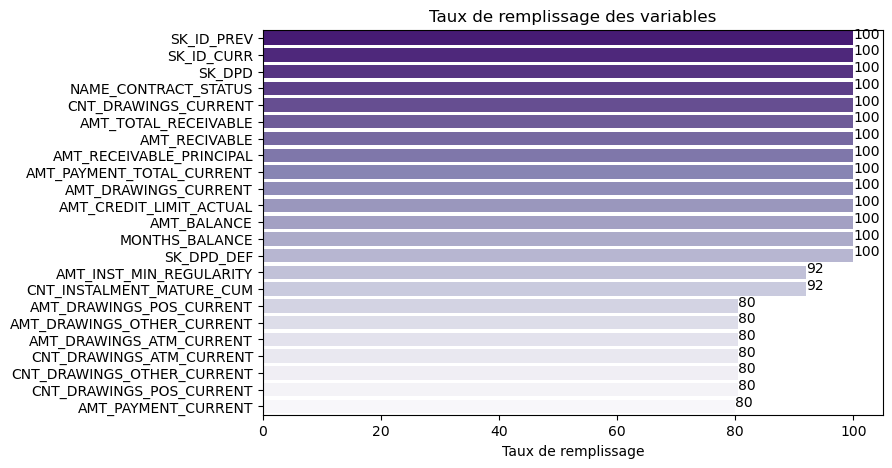

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,2562384,3840312,104307,2.72,3840312,100.00,0,0.00
1,SK_ID_CURR,int64,378907,3840312,103558,2.70,3840312,100.00,0,0.00
2,MONTHS_BALANCE,int64,-6,3840312,96,0.00,3840312,100.00,0,0.00
3,AMT_BALANCE,float64,56.97,3840312,1347904,35.10,3840312,100.00,0,0.00
4,AMT_CREDIT_LIMIT_ACTUAL,int64,135000,3840312,181,0.00,3840312,100.00,0,0.00
5,AMT_DRAWINGS_ATM_CURRENT,float64,0.00,3840312,2267,0.06,3090496,80.48,749816,19.52
6,AMT_DRAWINGS_CURRENT,float64,877.50,3840312,187005,4.87,3840312,100.00,0,0.00
7,AMT_DRAWINGS_OTHER_CURRENT,float64,0.00,3840312,1832,0.05,3090496,80.48,749816,19.52
8,AMT_DRAWINGS_POS_CURRENT,float64,877.50,3840312,168748,4.39,3090496,80.48,749816,19.52
9,AMT_INST_MIN_REGULARITY,float64,1700.33,3840312,312266,8.13,3535076,92.05,305236,7.95


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [217]:
fig = plt.figure(figsize=(8,5))
cc_balance_desc = fct_eda.describe_stat(cc_balance, fig = fig)

#### Traitement des données manquantes

Le taux de remplissage étant de 80% minimum, nous allons compléter les valeurs manquantes par la **médiane** et vérifier la distribution de nos variables avant et après retraitements.

In [218]:
cc_balance_nan = cc_balance.copy()

In [219]:
df_nan = fct_eda.nan_a_retraiter(cc_balance_nan)

In [220]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>=80)].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    cc_balance_nan[col] = cc_balance_nan[col].fillna(cc_balance_nan[col].median())

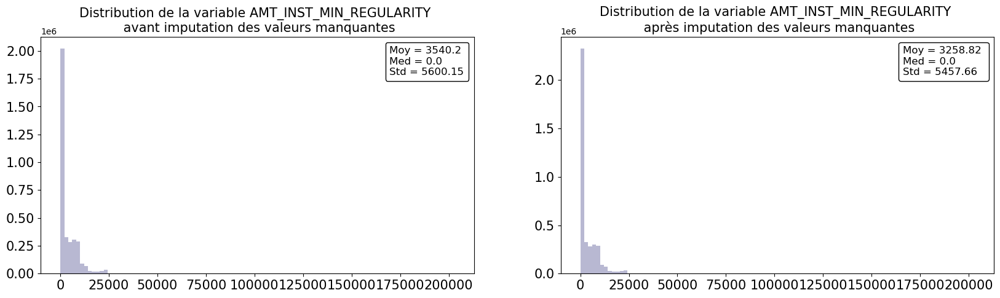

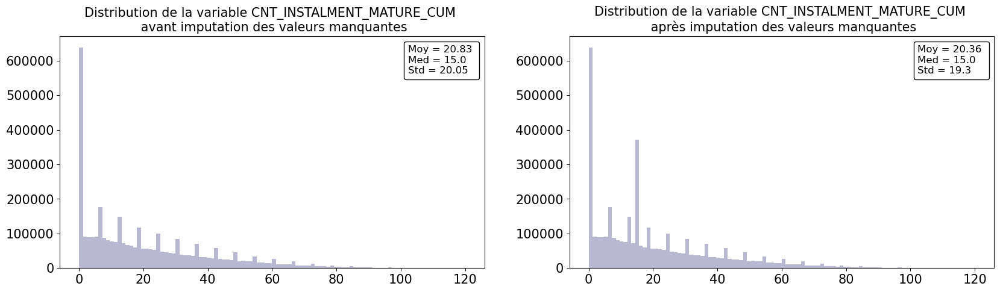

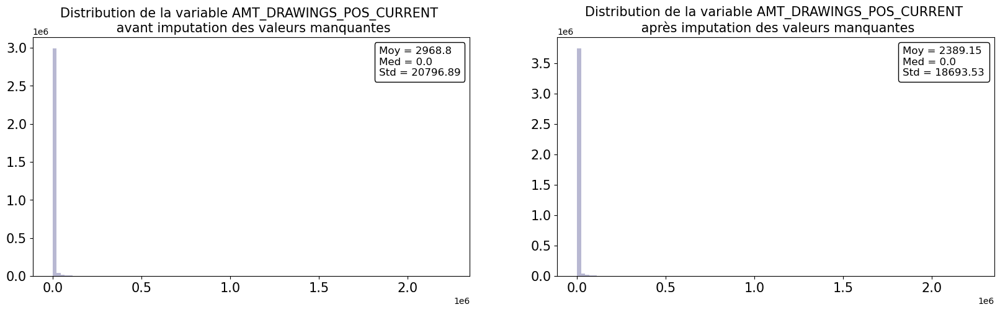

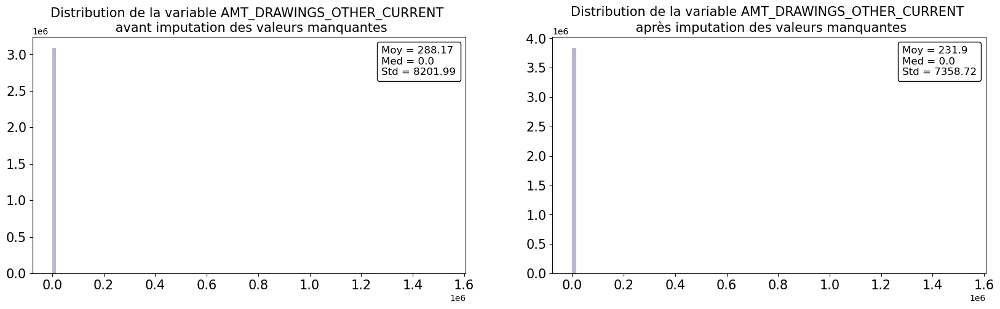

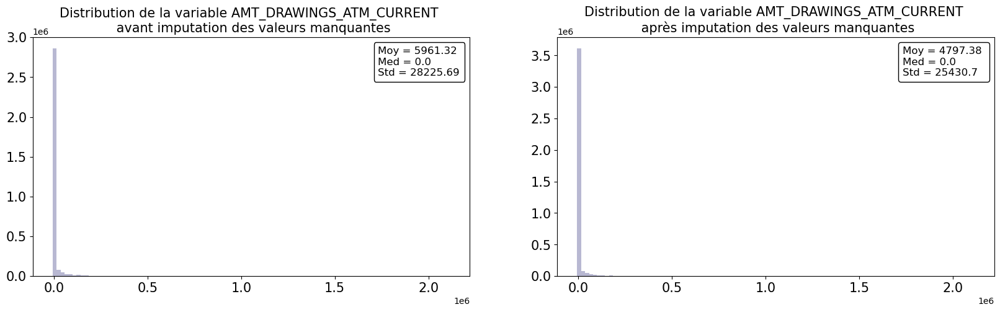

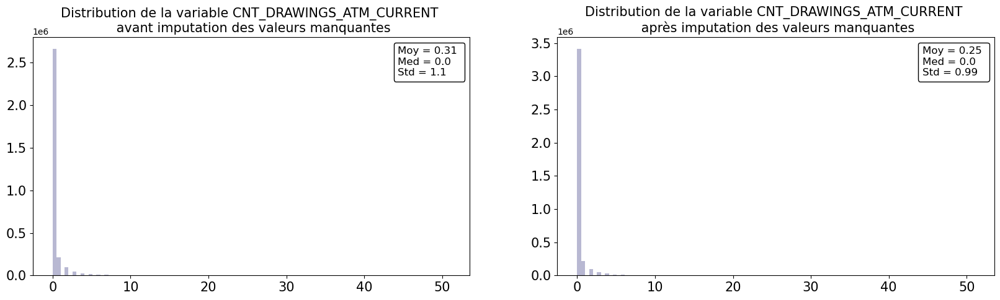

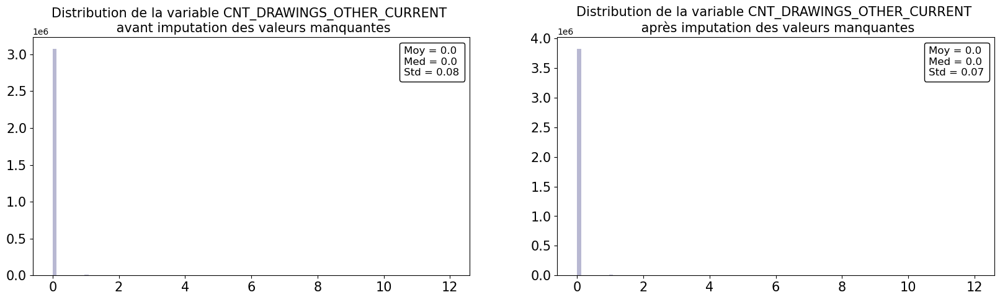

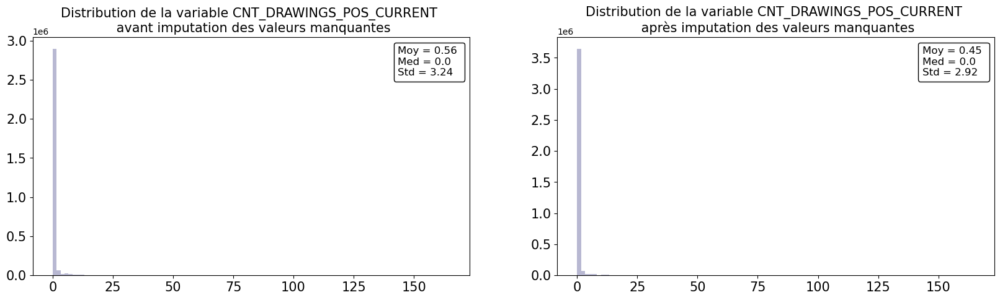

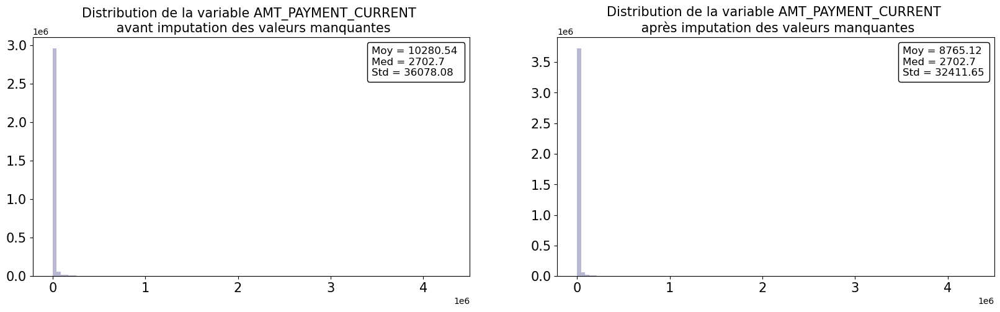

In [221]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(cc_balance, var, cc_balance_nan)

Les distributions sont relativement similaires, nous validons la méthode.

#### Analyses univariées

In [222]:
cc_balance_desc = cc_balance_nan.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [223]:
liste_col_quanti = cc_balance_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [224]:
len(liste_col_quanti)

20

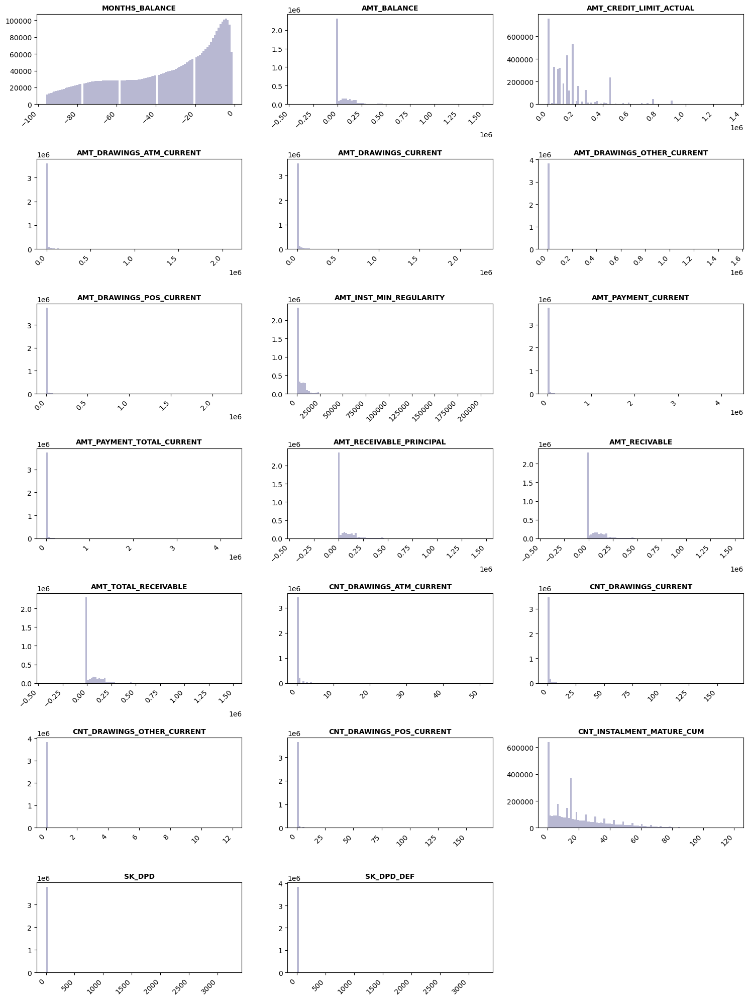

In [225]:
fig = plt.figure(figsize=(15,20))
fct_eda.univariate_plots_hist(cc_balance_desc, liste_col_quanti, 7, 3, 100, fig=fig)

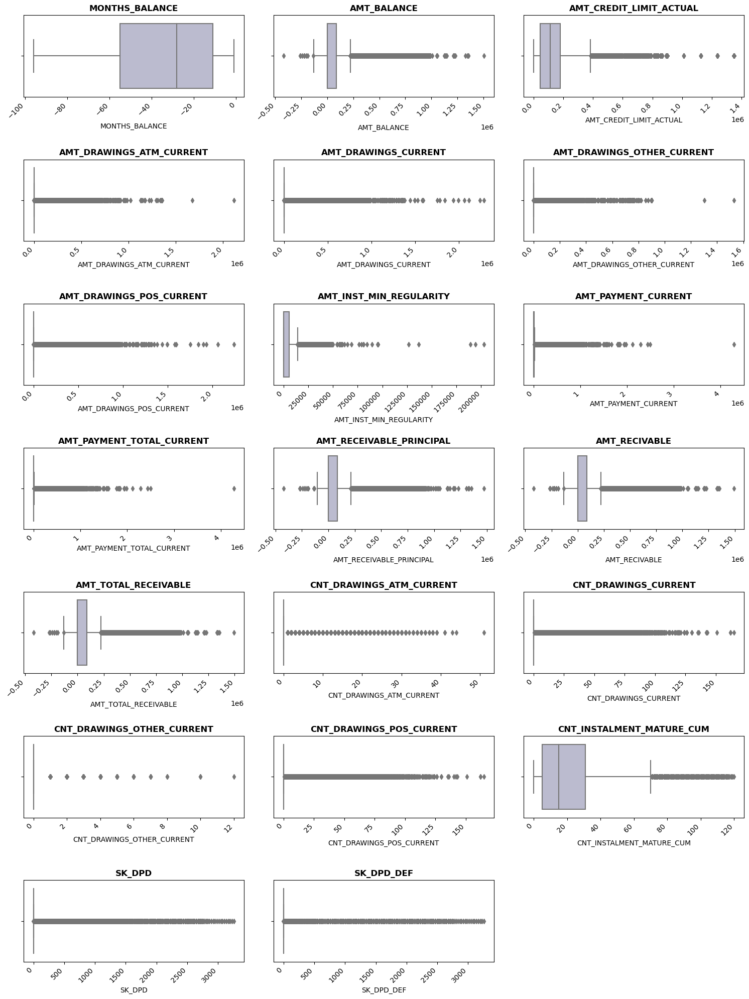

In [226]:
fig = plt.figure(figsize=(15,20))
fct_eda.univariate_plots_box(cc_balance_desc, liste_col_quanti, 7, 3, fig, True)

In [227]:
cc_balance_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
MONTHS_BALANCE,3840312.00,-34.52,26.67,-96.00,-55.00,-28.00,-11.00,-1.00
AMT_BALANCE,3840312.00,58300.16,106307.03,-420250.18,0.00,0.00,89046.69,1505902.19
AMT_CREDIT_LIMIT_ACTUAL,3840312.00,153807.96,165145.70,0.00,45000.00,112500.00,180000.00,1350000.00
AMT_DRAWINGS_ATM_CURRENT,3840312.00,4797.38,25430.70,-6827.31,0.00,0.00,0.00,2115000.00
AMT_DRAWINGS_CURRENT,3840312.00,7433.39,33846.08,-6211.62,0.00,0.00,0.00,2287098.31
AMT_DRAWINGS_OTHER_CURRENT,3840312.00,231.90,7358.72,0.00,0.00,0.00,0.00,1529847.00
AMT_DRAWINGS_POS_CURRENT,3840312.00,2389.15,18693.53,0.00,0.00,0.00,0.00,2239274.16
AMT_INST_MIN_REGULARITY,3840312.00,3258.82,5457.66,0.00,0.00,0.00,5625.00,202882.01
AMT_PAYMENT_CURRENT,3840312.00,8765.12,32411.65,0.00,247.95,2702.70,7875.00,4289207.45
AMT_PAYMENT_TOTAL_CURRENT,3840312.00,7588.86,32005.99,0.00,0.00,0.00,6750.00,4278315.69


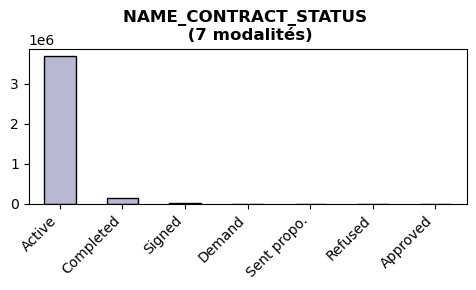

In [228]:
fig = plt.figure(figsize=(5, 3))
fct_eda.categ_distrib_plot(cc_balance_desc, ['NAME_CONTRACT_STATUS'], 1, 1, fig = fig)

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [229]:
cc_balance_desc = cc_balance_desc.merge(app_train_select.reset_index()[['SK_ID_CURR', 'TARGET']],
                                        on = 'SK_ID_CURR',
                                        how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [230]:
liste_target = ['TARGET']
liste_corr = liste_col_quanti + liste_target

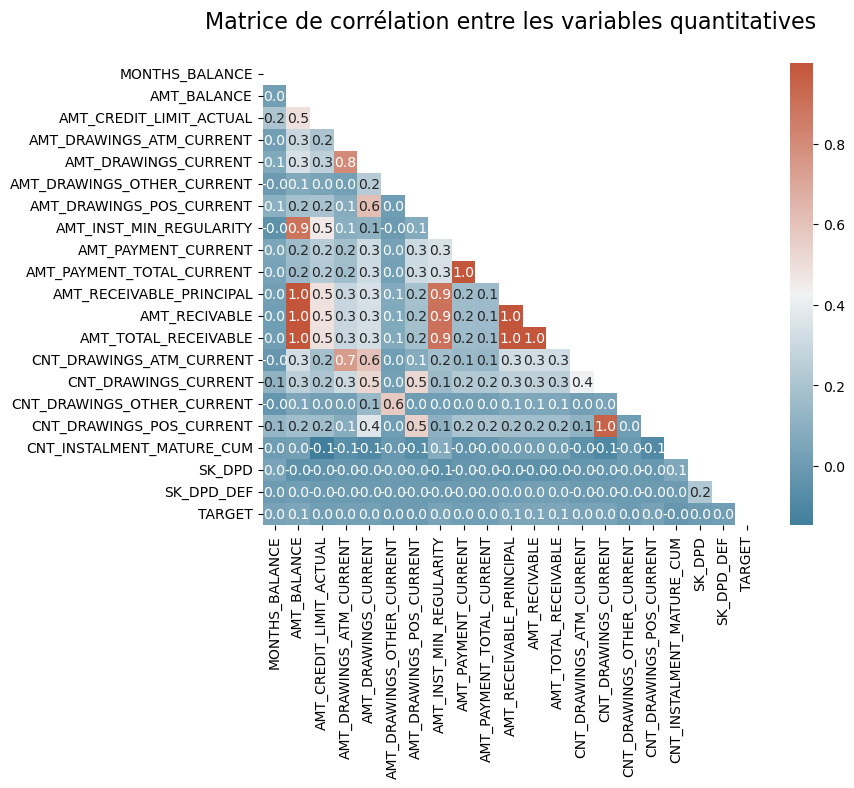

In [231]:
# Corrélation
corr = cc_balance_desc[liste_corr].corr()

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,6))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation entre les variables quantitatives\n", fontsize=16);

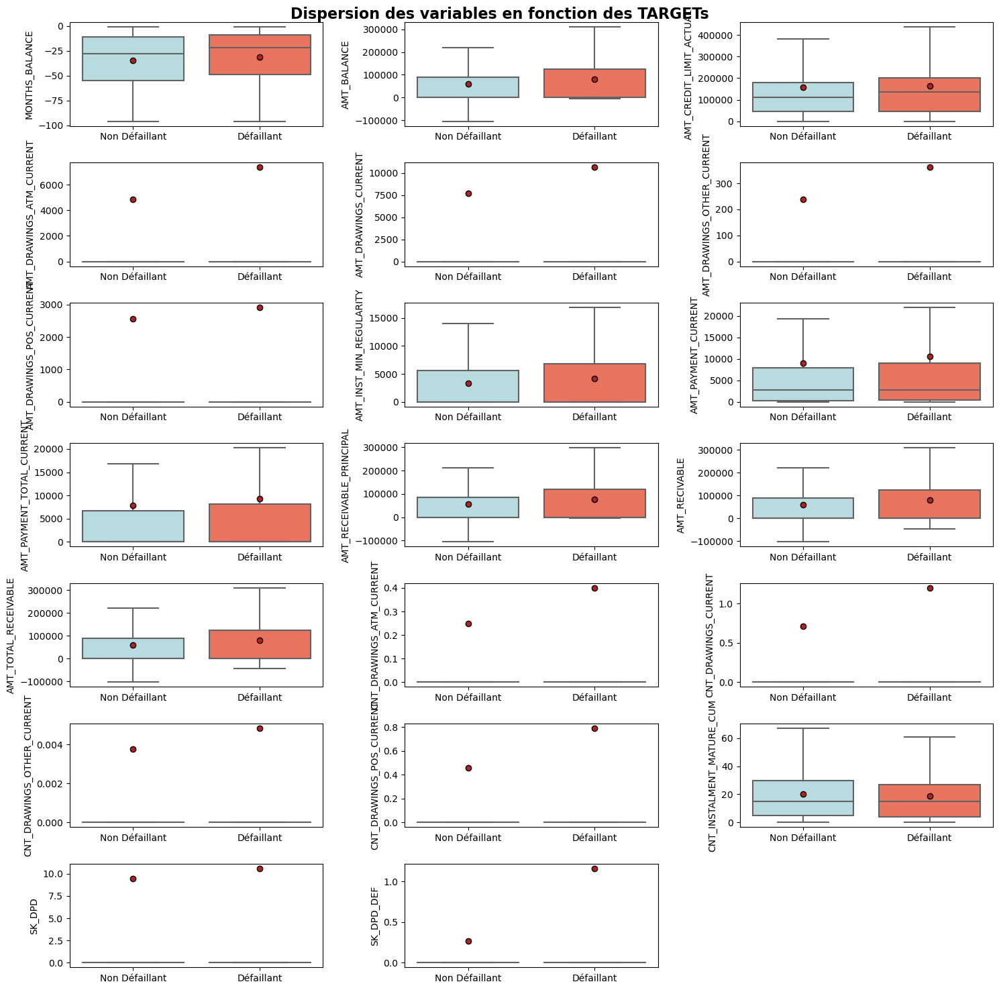

In [232]:
fig = plt.figure(figsize=(15,15))
fct_eda.bivariate_plots_box(cc_balance_desc, 'TARGET', liste_col_quanti, 7, 3, fig)

De nombreuses variables sont très corrélées entre elles. Il ne faut pas les rajouter toutes dans le modèle. Nous allons les supprimer:
- AMT_DRAWINGS_ATM_CURRENT 	
- AMT_DRAWINGS_POS_CURRENT
- AMT_INST_MIN_REGULARITY
- AMT_PAYMENT_TOTAL_CURRENT
- AMT_RECEIVABLE_PRINCIPAL
- AMT_RECIVABLE
- AMT_TOTAL_RECEIVABLE 	
- CNT_DRAWINGS_ATM_CURRENT 
- CNT_DRAWINGS_OTHER_CURRENT 
- CNT_DRAWINGS_POS_CURRENT

In [233]:
cc_balance_desc.drop(['AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_POS_CURRENT',
                      'AMT_INST_MIN_REGULARITY', 'AMT_PAYMENT_TOTAL_CURRENT',
                      'AMT_RECEIVABLE_PRINCIPAL', 'AMT_RECIVABLE',
                      'AMT_TOTAL_RECEIVABLE', 'CNT_DRAWINGS_ATM_CURRENT',
                      'CNT_DRAWINGS_OTHER_CURRENT', 'CNT_DRAWINGS_POS_CURRENT'],
                     axis=1, inplace = True)

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

NAME_CONTRACT_STATUS vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 3.060127030071402e-57 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


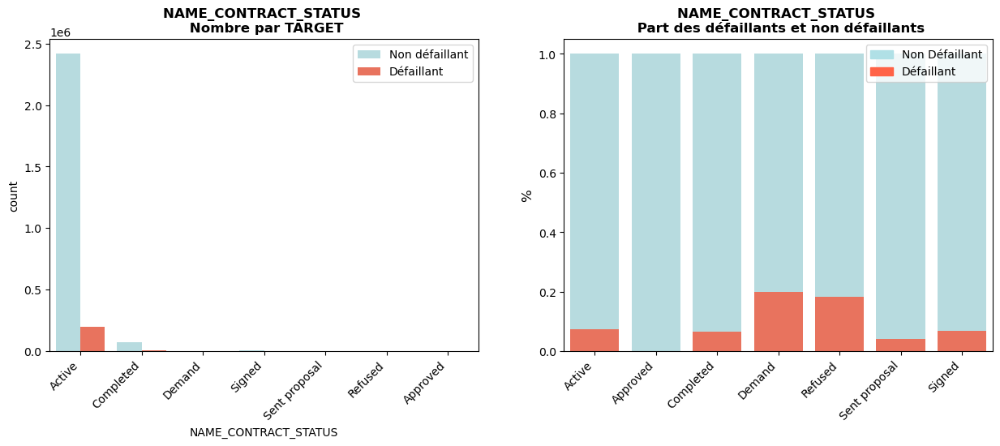

In [234]:
fct_eda.bivariate_barplots_categ(cc_balance_desc, 'NAME_CONTRACT_STATUS', 'TARGET')

La variable TARGET est associée à la varibale NAME_CONTRACT_STATUS, nous la conservons.

In [235]:
del cc_balance_desc['TARGET']

In [236]:
cc_balance_feat = cc_balance_desc.copy()

#### Feature engineering

In [237]:
# One hot encoder de la variable catégorielle
cc_balance_feat, cc_balance_cat = fct_eda.categories_encoder(cc_balance_feat, nan_as_category = False)
cc_balance_feat.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_PAYMENT_CURRENT,CNT_DRAWINGS_CURRENT,CNT_INSTALMENT_MATURE_CUM,SK_DPD,SK_DPD_DEF,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_Demand,NAME_CONTRACT_STATUS_Refused,NAME_CONTRACT_STATUS_Sent proposal,NAME_CONTRACT_STATUS_Signed
0,2562384,378907,-6,56.97,135000,877.50,0.00,1800.00,1,35.00,0,0,1,0,0,0,0,0,0
1,2582071,363914,-1,63975.56,45000,2250.00,0.00,2250.00,1,69.00,0,0,1,0,0,0,0,0,0
2,1740877,371185,-7,31815.22,450000,0.00,0.00,2250.00,0,30.00,0,0,1,0,0,0,0,0,0
3,1389973,337855,-4,236572.11,225000,2250.00,0.00,11925.00,1,10.00,0,0,1,0,0,0,0,0,0
4,1891521,126868,-1,453919.46,450000,11547.00,0.00,27000.00,1,101.00,0,0,1,0,0,0,0,0,0


Comme il y a plusieurs lignes par SK_ID_CURR nous allons grouper notre table par SK_ID_CURR et agréger les variables pour obtenir: le minimum, maximum, moyenne et somme.

In [238]:
# Groupe par SK_ID_PREV + agrégations
cc_balance_feat.drop(['SK_ID_PREV'], axis= 1, inplace = True)
cc_balance_feat_gby = cc_balance_feat.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum'])

In [239]:
# On renomme les colonnes pour supprimer le multi-index
cc_balance_feat_gby.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() 
                                        for e in cc_balance_feat_gby.columns.tolist()])

In [240]:
# Calcul du nombre d'historique
cc_balance_feat_gby['CC_COUNT'] = cc_balance_feat.groupby('SK_ID_CURR').size()

In [241]:
cc_balance_feat_gby.isna().sum().sort_values(ascending = False)

CC_MONTHS_BALANCE_MIN                         0
CC_NAME_CONTRACT_STATUS_Approved_MIN          0
CC_NAME_CONTRACT_STATUS_Completed_MEAN        0
CC_NAME_CONTRACT_STATUS_Completed_MAX         0
CC_NAME_CONTRACT_STATUS_Completed_MIN         0
CC_NAME_CONTRACT_STATUS_Approved_SUM          0
CC_NAME_CONTRACT_STATUS_Approved_MEAN         0
CC_NAME_CONTRACT_STATUS_Approved_MAX          0
CC_NAME_CONTRACT_STATUS_Active_SUM            0
CC_SK_DPD_SUM                                 0
CC_NAME_CONTRACT_STATUS_Active_MEAN           0
CC_NAME_CONTRACT_STATUS_Active_MAX            0
CC_NAME_CONTRACT_STATUS_Active_MIN            0
CC_SK_DPD_DEF_SUM                             0
CC_SK_DPD_DEF_MEAN                            0
CC_SK_DPD_DEF_MAX                             0
CC_NAME_CONTRACT_STATUS_Completed_SUM         0
CC_NAME_CONTRACT_STATUS_Demand_MIN            0
CC_NAME_CONTRACT_STATUS_Demand_MAX            0
CC_NAME_CONTRACT_STATUS_Demand_MEAN           0
CC_NAME_CONTRACT_STATUS_Demand_SUM      

In [242]:
cc_balance_feat_gby.shape

(103558, 69)

#### Fonction de preprocessing

In [243]:
def preprocess_credit_card_balance():
    '''Fonction de preprocessing du dataset credit_card_balance:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    cc_balance = pd.read_csv('data/credit_card_balance.csv',
                             sep=',',
                             encoding='utf-8')
    
    # Traitement des données manquantes (médiane)
    df_nan = fct_eda.nan_a_retraiter(cc_balance)
    col_med = df_nan[(df_nan['Tx_rempl']>=80)].index.tolist()
    for col in col_med:
        cc_balance[col] = cc_balance[col].fillna(cc_balance[col].median())

    # Suppression variables suite analyses
    cc_balance.drop(['AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_POS_CURRENT',
                      'AMT_INST_MIN_REGULARITY', 'AMT_PAYMENT_TOTAL_CURRENT',
                      'AMT_RECEIVABLE_PRINCIPAL', 'AMT_RECIVABLE',
                      'AMT_TOTAL_RECEIVABLE', 'CNT_DRAWINGS_ATM_CURRENT',
                      'CNT_DRAWINGS_OTHER_CURRENT', 'CNT_DRAWINGS_POS_CURRENT'],
                    axis=1, inplace = True)

    # Feature engineering

        # One hot encoder de la variable catégorielle
    cc_balance_feat, cc_balance_cat = fct_eda.categories_encoder(cc_balance, nan_as_category = False)

        # Groupe par SK_ID_PREV + agrégations
    cc_balance_feat.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_balance_feat_gby = cc_balance_feat.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum'])

        # On renomme les colonnes pour supprimer le multi-index
    cc_balance_feat_gby.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() 
                                            for e in cc_balance_feat_gby.columns.tolist()])

        # Calcul du nombre d'historique
    cc_balance_feat_gby['CC_COUNT'] = cc_balance_feat.groupby('SK_ID_CURR').size()
   
    del cc_balance, cc_balance_feat
    gc.collect()
    
    return cc_balance_feat_gby

In [244]:
preprocess_credit_card_balance().shape

(103558, 69)

## Fonction de preprocessing et assemblage des datasets <a class="anchor" id="preprocess"></a>

In [245]:
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print(f"{title} fait en {np.round(time.time() - t0, 0)}s ")

In [246]:
def main():
    with timer("Processing application_train"):
        df = preprocess_app_train_test()
        print("Application_train shape:", df.shape)
    with timer("Processing bureau et bureau_balance"):
        bureau = preprocess_bureau_balance()
        print("Bureau shape:", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Processing previous_applications"):
        prev = preprocess_previous_app()
        print("Previous applications shape:", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Processing POS-CASH balance"):
        pos = preprocess_POS_CASH_balance()
        print("Pos-cash balance shape:", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Processing installments payments"):
        ins = preprocess_installments_payments()
        print("Installments payments shape:", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Processing credit card balance"):
        cc = preprocess_credit_card_balance()
        print("Credit card balance shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        del cc
        gc.collect()
    return df

In [247]:
df_conso = main()

Application_train shape: (252133, 125)
Processing application_train fait en 13.0s 
Bureau shape: (305807, 66)
Processing bureau et bureau_balance fait en 42.0s 
Previous applications shape: (338384, 176)
Processing previous_applications fait en 94.0s 
Pos-cash balance shape: (337252, 17)
Processing POS-CASH balance fait en 24.0s 
Installments payments shape: (339587, 10)
Processing installments payments fait en 30.0s 
Credit card balance shape: (103558, 69)
Processing credit card balance fait en 26.0s 


### Derniers retraitements <a class="anchor" id="retraitements"></a>

In [248]:
fct_eda.shape_total_nan(df_conso)

Nombre de lignes: 252133
Nombre de colonnes: 463
Nombre total de NaN du dataset: 17489641
% total de NaN du dataset: 14.98%


In [249]:
fct_eda.nan_a_retraiter(df_conso)

,Tx_rempl,nb_NaN,dtypes
INSTAL_DAYS_BEFORE_DUE_MEAN,94.72,13301,float64
INSTAL_DAYS_PAST_DUE_MAX,94.72,13301,float64
INSTAL_DAYS_PAST_DUE_MEAN,94.72,13301,float64
INSTAL_DAYS_PAST_DUE_SUM,94.72,13301,float64
INSTAL_DAYS_BEFORE_DUE_MAX,94.72,13301,float64
INSTAL_COUNT,94.72,13301,float64
INSTAL_DAYS_BEFORE_DUE_SUM,94.72,13301,float64
INSTAL_PAYMENT_DIFF_SUM,94.72,13301,float64
INSTAL_PAYMENT_DIFF_MAX,94.72,13301,float64
INSTAL_PAYMENT_DIFF_MEAN,94.72,13301,float64


Le regroupement des différents datasets entre eux a généré des valeurs manquantes. Afin de pouvoir comparer nos modèles, nous allons retraiter les valeurs manquantes de différentes manières:
- **supprimer les variables** ayant plus de **70% de valeurs manquantes**
- compléter les autres par la **médiane**

<div class="alert alert-block alert-warning">
    <p>Suppression des variables avec 20% ou plus de NaN</p>
</div>

In [250]:
# Suppression des variables avec 20% ou plus de NaN
df_conso_nan = fct_eda.tx_rempl_min(df_conso, 80)
fct_eda.nan_a_retraiter(df_conso_nan)

,Tx_rempl,nb_NaN,dtypes
INSTAL_PAYMENT_DIFF_SUM,94.72,13301,float64
INSTAL_PAYMENT_DIFF_MEAN,94.72,13301,float64
INSTAL_PAYMENT_DIFF_MAX,94.72,13301,float64
INSTAL_DAYS_BEFORE_DUE_SUM,94.72,13301,float64
INSTAL_DAYS_BEFORE_DUE_MEAN,94.72,13301,float64
INSTAL_DAYS_BEFORE_DUE_MAX,94.72,13301,float64
INSTAL_DAYS_PAST_DUE_SUM,94.72,13301,float64
INSTAL_DAYS_PAST_DUE_MEAN,94.72,13301,float64
INSTAL_DAYS_PAST_DUE_MAX,94.72,13301,float64
INSTAL_COUNT,94.72,13301,float64


<div class="alert alert-block alert-warning">
    <p>Médiane pour les variables restantes</p>
</div>

In [251]:
df_conso_med = df_conso_nan.copy()

In [252]:
df_nan = fct_eda.nan_a_retraiter(df_conso_med)

In [253]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                 (df_nan['dtypes'] == 'float64') &
                 (~ df_nan.index.str.contains('TARGET'))].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    df_conso_med[col] = df_conso_med[col].fillna(df_conso_med[col].median())

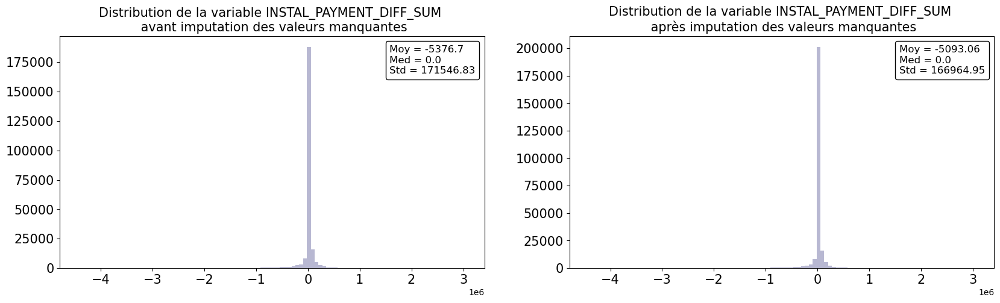

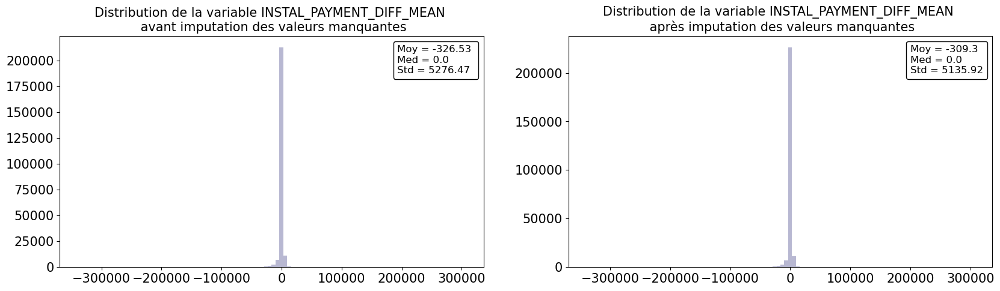

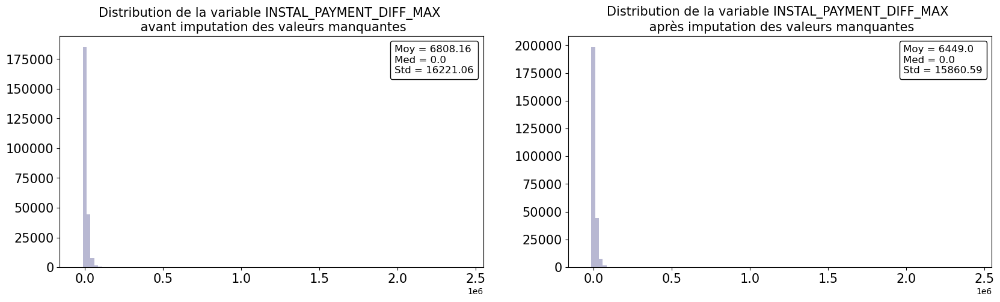

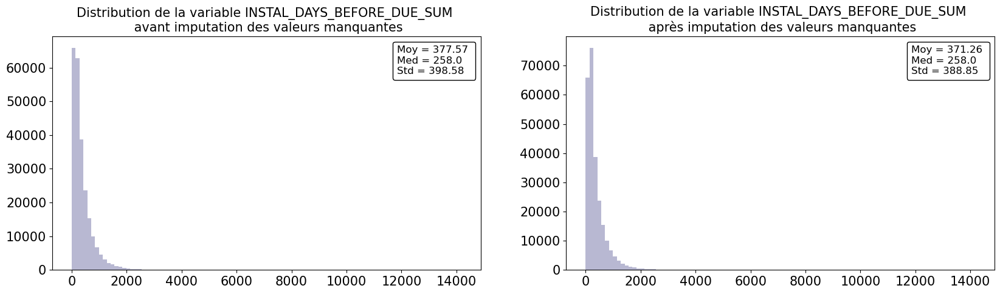

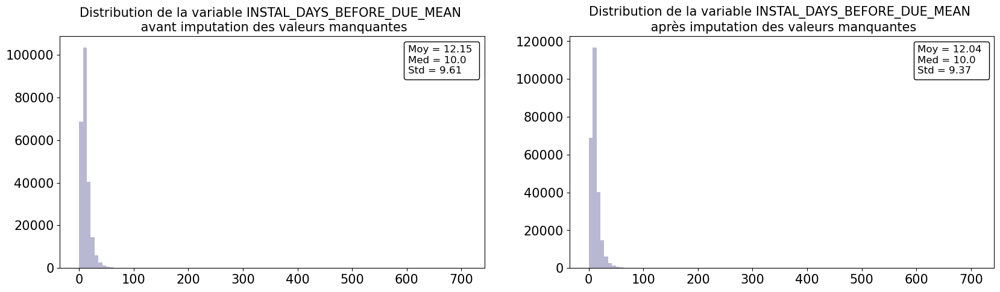

...

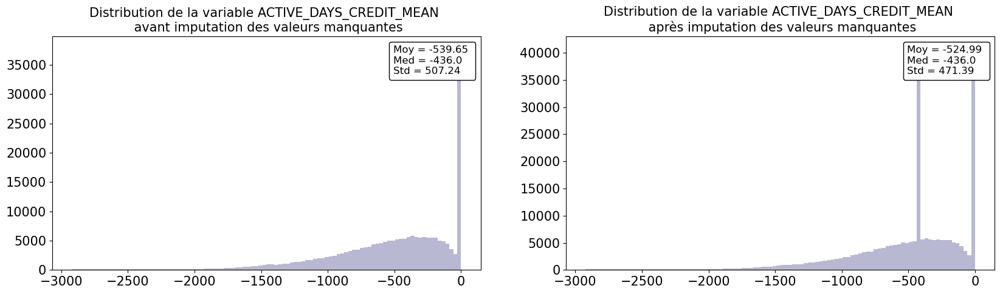

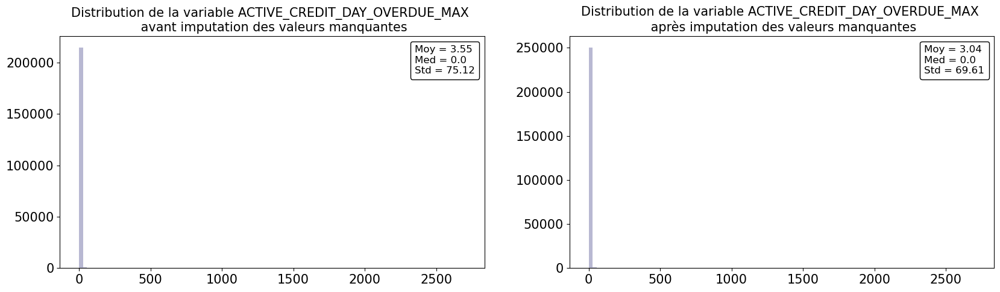

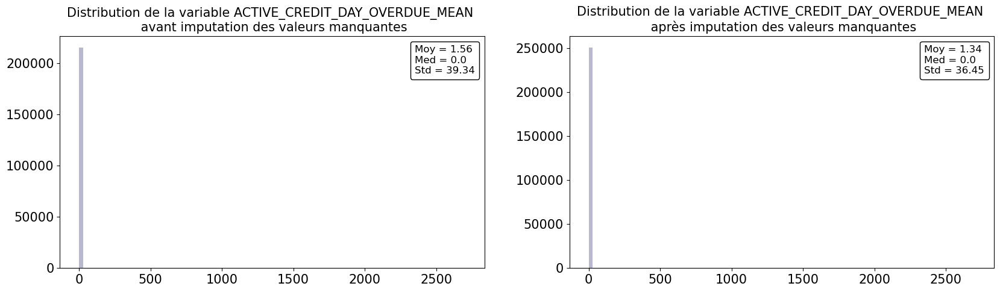

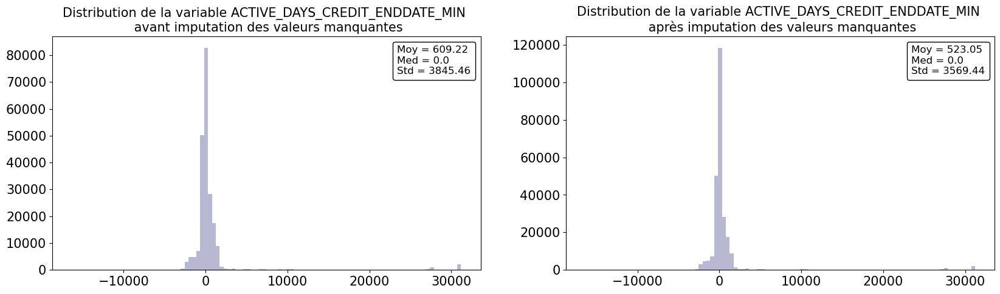

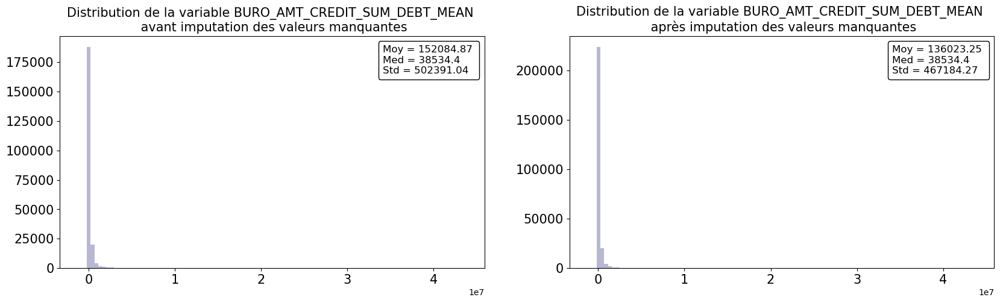

In [254]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(df_conso_nan, var, df_conso_med)

### Fonction avec retraitement NaN <a class="anchor" id="main_nan"></a>

In [255]:
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print(f"{title} fait en {np.round(time.time() - t0, 0)}s ")

In [256]:
def main():
    with timer("Processing application_train"):
        df = preprocess_app_train_test()
        print("Application_train shape:", df.shape)
    with timer("Processing bureau et bureau_balance"):
        bureau = preprocess_bureau_balance()
        print("Bureau shape:", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Processing previous_applications"):
        prev = preprocess_previous_app()
        print("Previous applications shape:", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Processing POS-CASH balance"):
        pos = preprocess_POS_CASH_balance()
        print("Pos-cash balance shape:", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Processing installments payments"):
        ins = preprocess_installments_payments()
        print("Installments payments shape:", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Processing credit card balance"):
        cc = preprocess_credit_card_balance()
        print("Credit card balance shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        df = fct_eda.tx_rempl_min(df, 80)
        df_nan = fct_eda.nan_a_retraiter(df)
        col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                 (df_nan['dtypes'] == 'float64') &
                 (~ df_nan.index.str.contains('TARGET'))].index.tolist()
        for col in col_med:
            df[col] = df[col].fillna(df[col].median())
        del cc, df_nan, col_med
        gc.collect()
    return df

In [257]:
df = main()

Application_train shape: (252133, 125)
Processing application_train fait en 13.0s 
Bureau shape: (305807, 66)
Processing bureau et bureau_balance fait en 43.0s 
Previous applications shape: (338384, 176)
Processing previous_applications fait en 91.0s 
Pos-cash balance shape: (337252, 17)
Processing POS-CASH balance fait en 27.0s 
Installments payments shape: (339587, 10)
Processing installments payments fait en 35.0s 
Credit card balance shape: (103558, 69)
Processing credit card balance fait en 60.0s 


In [258]:
fct_eda.shape_total_nan(df)

Nombre de lignes: 252133
Nombre de colonnes: 394
Nombre total de NaN du dataset: 0
% total de NaN du dataset: 0.0%
